<img src="https://www.epfl.ch/about/overview/wp-content/uploads/2020/07/logo-epfl-1024x576.png" 
     style="padding-right:10px;width:140px;float:left">
<h2 style="white-space: nowrap">Neural Signal and Signal Processing (NX-421)</h2>
<hr style="clear:both">
<h1 style="color:black">Mini Project 2</h1>

In [289]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set() #sets the matplotlib style to seaborn style

from scipy.io import loadmat 
from scipy.ndimage import convolve1d
from scipy.signal import butter
from scipy.signal import sosfiltfilt
from scipy.signal import welch
import pandas as pd

# Part 1
## Visualization and preprocessing of the data

Important note: the data are partially preprocessed, i.e. already amplified, bandpass-filtered and RMS rectified. The signals were also cleaned  from 50 Hz (and harmonics) power-line interference using a Hampel filter. (faire référence au paper)

### Load the data

In [290]:
data_path = "data/s2/S2_A1_E1.mat"

data = loadmat(data_path)
print("Dataset variables:")
for key in data.keys():
    if not key.startswith("__"):
        print(key)

Dataset variables:
subject
exercise
stimulus
emg
glove
restimulus
repetition
rerepetition


In [291]:
emg = data["emg"]
print("EMG data dimension: {}".format(emg.shape))
print("EMG data type: {}".format(type(emg)))

EMG data dimension: (100686, 10)
EMG data type: <class 'numpy.ndarray'>


In [292]:
data_shape = emg.shape
n_timepoints = emg.shape[0]
n_channels = emg.shape[1]

print(f'The shape of the data is {data_shape}')
print(f'There are {n_timepoints} timepoints')
print(f'There are {n_channels} channels')

The shape of the data is (100686, 10)
There are 100686 timepoints
There are 10 channels


### Visualization of the EMG signal on one channel

Text(0, 0.5, 'Amplitude')

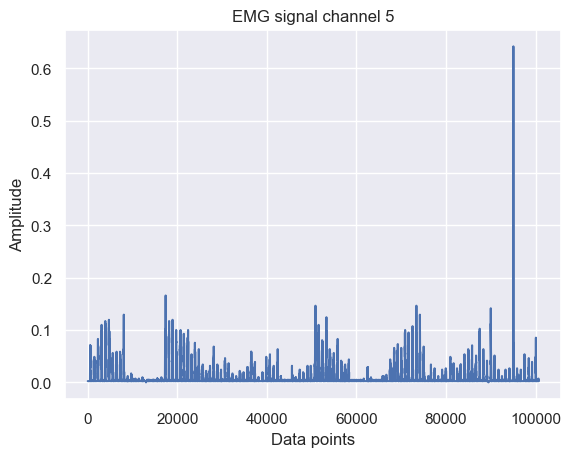

In [293]:
# Plot first channel to get a sense of the data
plt.close("all")
fig, ax = plt.subplots()

EMG_channel = 5

start = 20000
end = 30000

# ax.plot(emg[start:end, EMG_channel])
ax.plot(emg[:, EMG_channel])   
ax.set_title(f"EMG signal channel {EMG_channel}")
ax.set_xlabel("Data points")
ax.set_ylabel("Amplitude")

### Envelop exctraction by applying a moving average

In [294]:
stimulus = data['restimulus']
repetition = data['rerepetition']

print(f'Shape of the data: \nEMG: {emg.shape}, \nStimulus: {stimulus.shape}, \nRepetition: {repetition.shape}')

Shape of the data: 
EMG: (100686, 10), 
Stimulus: (100686, 1), 
Repetition: (100686, 1)


In the paper, it is written that the sEMG signals are sampled at a rate of 100 Hz.

In [296]:
# Sampling frequency (Hz)
fs = 100 

#Time vector for plotting : create evenly spaced time bins from 0 to the total duration of the signal in s
time_steps = np.arange(0,emg.shape[0]/fs, 1/fs)

mov_mean_size to tune

Text(0.5, 0.98, 'EMG envelopes')

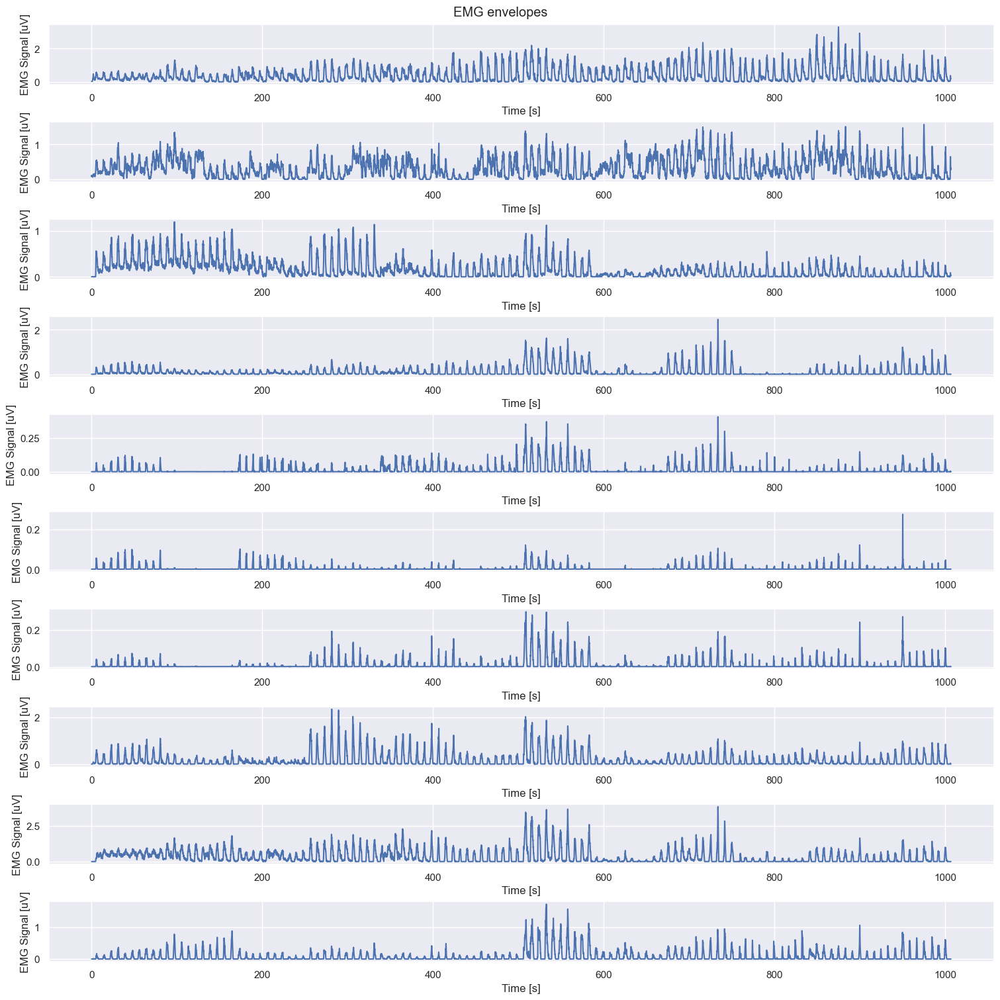

In [297]:
mov_mean_size = 25
mov_mean_weights = np.ones(mov_mean_size) / mov_mean_size
emg_envelopes = convolve1d(emg, weights=mov_mean_weights, axis=0) # convolve1d the rectified signal with the moving average weights


fig, ax = plt.subplots(n_channels, 1, constrained_layout=True, figsize=(15, 15))
for channel_idx in range(n_channels):
    ax[channel_idx].plot(time_steps, emg_envelopes[:, channel_idx])
    ax[channel_idx].set_xlabel("Time [s]")
    ax[channel_idx].set_ylabel("EMG Signal [uV]")
plt.suptitle("EMG envelopes")

In [298]:
# -1 because 0 is the resting condition
n_stimuli = len(np.unique(stimulus)) - 1 
# -1 because 0 is not a repetition
n_repetitions = len(np.unique(repetition)) - 1 

print(f'How many types of movement are there? {n_stimuli}') 
print(f'How many repetitions are there? {n_repetitions}') 

How many types of movement are there? 12
How many repetitions are there? 10


In [299]:
number_of_samples_per_trial = np.zeros((n_stimuli, n_repetitions))

for stimuli_idx in range(n_stimuli):
    for repetition_idx in range(n_repetitions):
        
        idx = np.logical_and(stimulus == stimuli_idx+1, repetition == repetition_idx+1)
        number_of_samples_per_trial[stimuli_idx, repetition_idx] = np.sum(idx.astype(int))

number_of_samples_per_trial.shape
number_of_samples_per_trial

array([[307., 390., 262., 226., 418., 204., 196., 270., 306., 489.],
       [334., 323., 344., 309., 333., 376., 362., 307., 348., 339.],
       [465., 352., 450., 460., 436., 389., 323., 388., 383., 316.],
       [310., 402., 357., 396., 255., 333., 263., 369., 438., 471.],
       [516., 382., 425., 379., 463., 411., 387., 343., 286., 377.],
       [337., 319., 337., 368., 338., 336., 268., 354., 319., 313.],
       [428., 392., 341., 393., 421., 445., 342., 328., 329., 358.],
       [289., 372., 406., 397., 498., 336., 415., 328., 472., 405.],
       [384., 424., 371., 316., 280., 314., 342., 284., 307., 421.],
       [311., 296., 299., 296., 301., 246., 213., 317., 493., 221.],
       [352., 403., 338., 416., 330., 355., 313., 322., 329., 219.],
       [270., 330., 300., 387., 295., 204., 363., 267., 281., 329.]])

### Visualization of the data for one single trial

In [300]:
#defining the length of the moving average window
mov_mean_length = 25
mov_mean_weights = np.ones(mov_mean_length) / mov_mean_length

#initializing the data structure
emg_windows = [[None for repetition_idx in range(n_repetitions)] for stimuli_idx in range(n_stimuli)]
emg_envelopes = [[None for repetition_idx in range(n_repetitions)] for stimuli_idx in range(n_stimuli)]

for stimuli_idx in range(n_stimuli):
    for repetition_idx in range(n_repetitions):
        idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1).flatten()
        emg_windows[stimuli_idx][repetition_idx] = emg[idx, :]
        emg_envelopes[stimuli_idx][repetition_idx] = convolve1d(emg_windows[stimuli_idx][repetition_idx], mov_mean_weights, axis=0) 

Text(0.5, 0.98, 'Envelopes of the EMG signal')

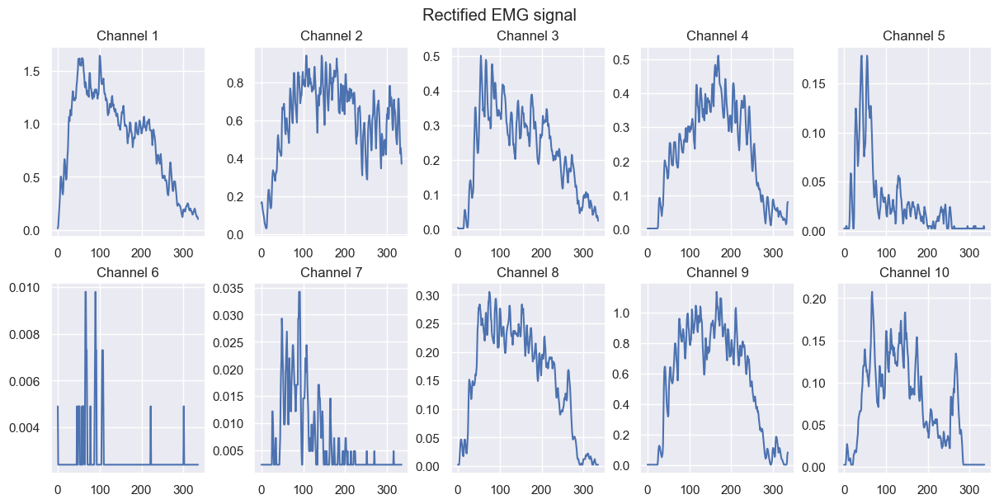

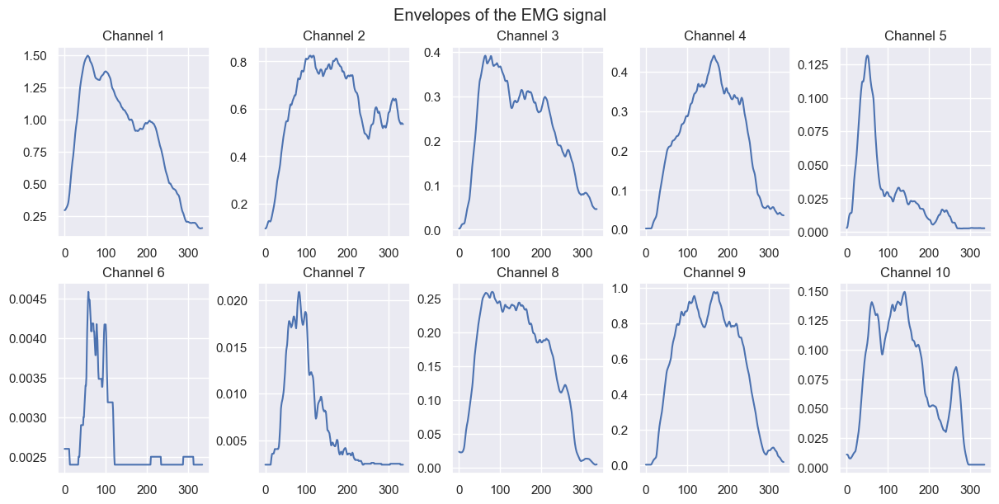

In [301]:
fig, ax = plt.subplots(2, 5, figsize=(12, 6), constrained_layout=True)
ax = ax.ravel()

trial_window = emg_windows[5][5]  #Change the indices there to switch between trials  --> first indice : type of movement, second indice : repetition
trial_envelope = emg_envelopes[5][5]  #Change the indices there to switch between trials  --> first indice : type of movement, second indice : repetition

#10 EMG channels
number_of_emg_channels = emg.shape[-1]
# plot Rectified EMG signal
for channel_idx in range(number_of_emg_channels): 
    ax[channel_idx].plot(emg_windows[5][5][:, channel_idx])   
    ax[channel_idx].set_title(f"Channel {channel_idx+1}")
plt.suptitle("Rectified EMG signal")

# plot Envelopes of the EMG signal
fig, ax = plt.subplots(2, 5, figsize=(12, 6), constrained_layout=True)
ax = ax.ravel()
for channel_idx in range(number_of_emg_channels): 
    ax[channel_idx].plot(emg_envelopes[5][5][:, channel_idx])   
    ax[channel_idx].set_title(f"Channel {channel_idx+1}")
plt.suptitle("Envelopes of the EMG signal")

Plotting of the different channels on the same y-scale, to see the importance of each relativ to the other ones

Max Value: 1.438


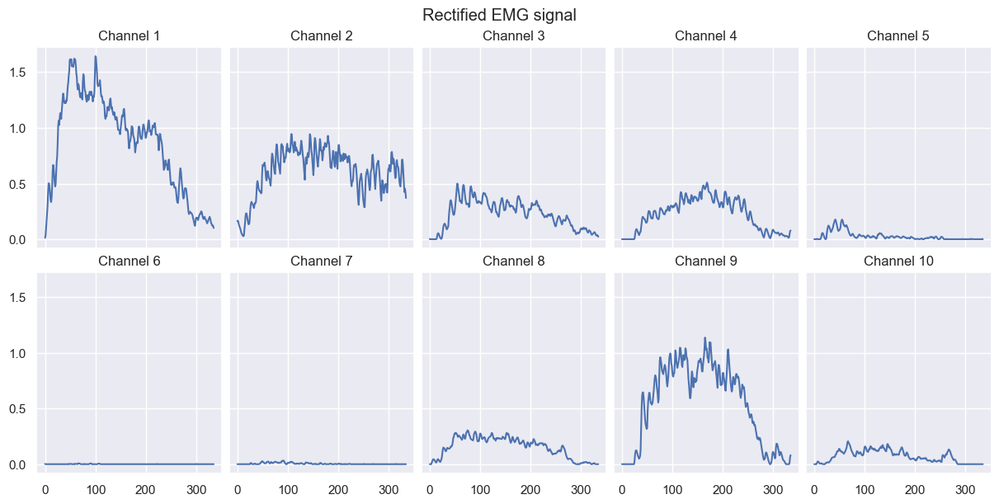

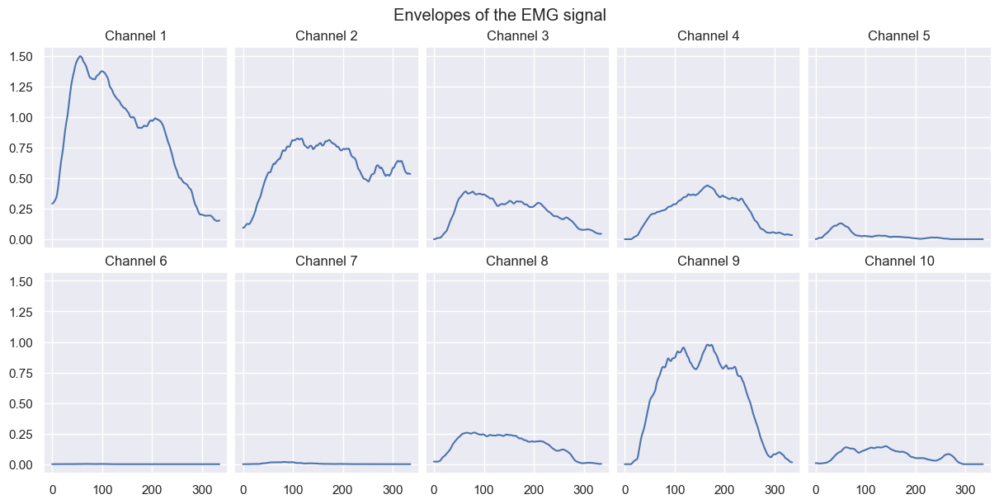

In [302]:
# Now we plot all the channels on the same y-scale
fig, ax = plt.subplots(2, 5, figsize=(12, 6), constrained_layout=True, sharex=True, sharey=True)
ax = ax.ravel()

number_of_emg_channels = emg.shape[-1]
# plot Rectified EMG signal
for channel_idx in range(number_of_emg_channels): 
    ax[channel_idx].plot(emg_windows[5][5][:, channel_idx])   
    ax[channel_idx].set_title(f"Channel {channel_idx+1}")
plt.suptitle("Rectified EMG signal")

# plot Envelopes of the EMG signal
fig, ax = plt.subplots(2, 5, figsize=(12, 6), constrained_layout=True, sharex=True, sharey=True)
ax = ax.ravel()
for channel_idx in range(number_of_emg_channels): 
    ax[channel_idx].plot(emg_envelopes[5][5][:, channel_idx])
    ax[channel_idx].set_title(f"Channel {channel_idx+1}")
plt.suptitle("Envelopes of the EMG signal")

print(f"Max Value:", np.max(emg_windows[4][5]))

### Visualizing across repetitions

In [303]:
emg_average_activations = np.zeros((n_channels, n_stimuli, n_repetitions))
emg_max_activations = np.zeros((n_channels, n_stimuli, n_repetitions))  
for stimuli_idx in range(n_stimuli):
    for repetition_idx in range(n_repetitions):
        #mean across time for each channel
        emg_average_activations[:, stimuli_idx, repetition_idx] = np.mean(emg_envelopes[stimuli_idx][repetition_idx], axis=0) 
        emg_max_activations[:, stimuli_idx, repetition_idx] = np.max(emg_envelopes[stimuli_idx][repetition_idx], axis=0)  

print(f'Max value across all average activations: {np.max(emg_average_activations)}')  

Max value across all average activations: 1.95264005102041


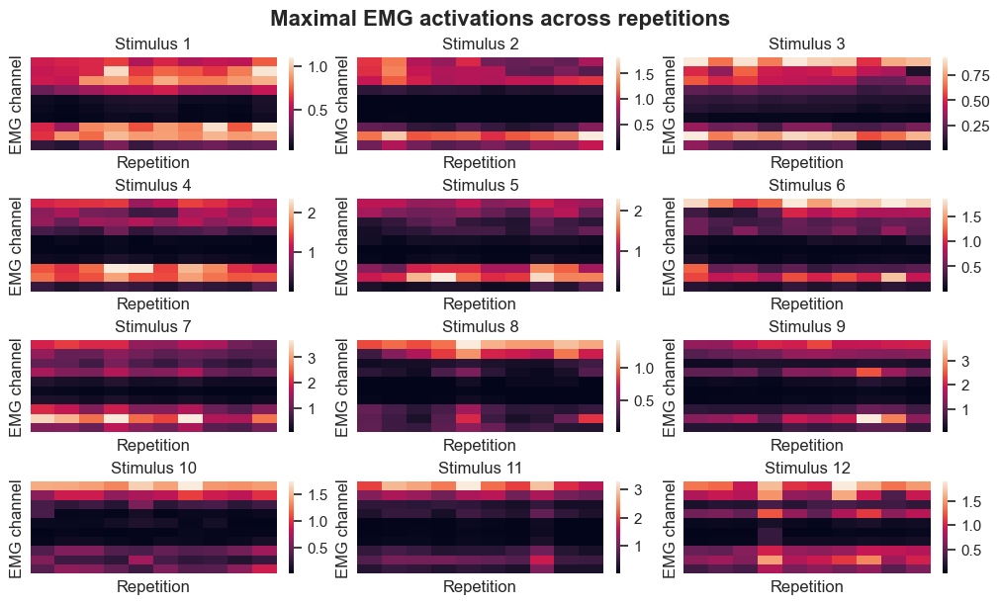

In [304]:
fig, ax = plt.subplots(4, 3, figsize=(10, 6), constrained_layout=True, sharex=True, sharey=True)
ax = ax.ravel()
fig.suptitle("Maximal EMG activations across repetitions", fontsize=16, fontweight='bold')
for stimuli_idx in range(n_stimuli):
    sns.heatmap(np.squeeze(emg_max_activations[:, stimuli_idx, :]), ax=ax[stimuli_idx] ,xticklabels=False, yticklabels=False, cbar = True)
    ax[stimuli_idx].title.set_text("Stimulus " + str(stimuli_idx + 1))
    ax[stimuli_idx].set_xlabel("Repetition")
    ax[stimuli_idx].set_ylabel("EMG channel")

There seems to be no saturation of any channels, so we dont need to remove any trials

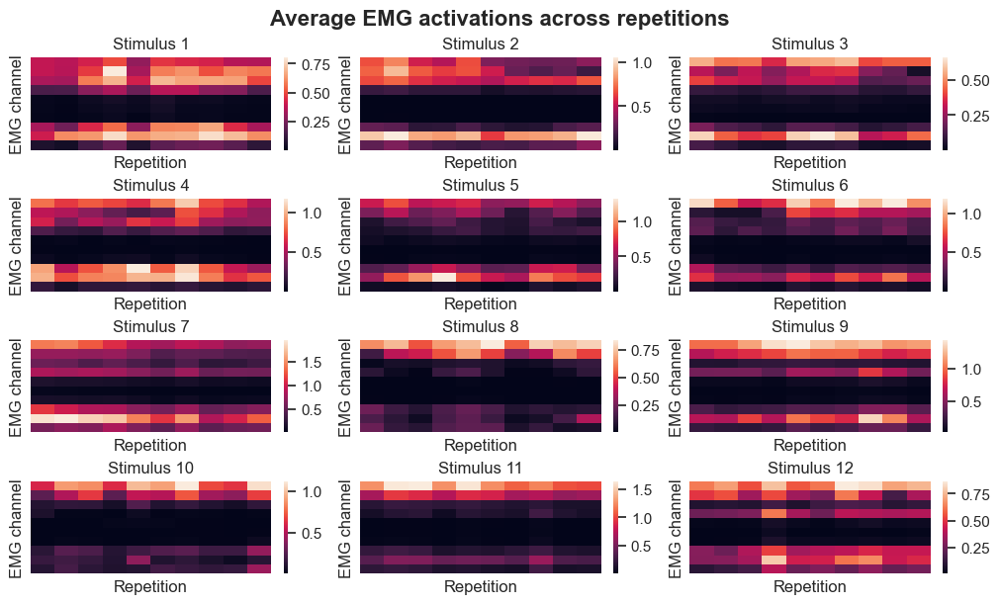

In [305]:
fig, ax = plt.subplots(4, 3, figsize=(10, 6), constrained_layout=True, sharex=True, sharey=True)
ax = ax.ravel()
fig.suptitle("Average EMG activations across repetitions", fontsize=16, fontweight='bold')

for stimuli_idx in range(n_stimuli):
    sns.heatmap(np.squeeze(emg_average_activations[:, stimuli_idx, :]), ax=ax[stimuli_idx] ,xticklabels=False, yticklabels=False, cbar = True)
    ax[stimuli_idx].title.set_text("Stimulus " + str(stimuli_idx + 1))
    ax[stimuli_idx].set_xlabel("Repetition")
    ax[stimuli_idx].set_ylabel("EMG channel")

## Feature exctraction and visualization

### Extract features and build the dataset for classification 

In [306]:
def build_dataset_from_ninapro(emg, stimulus, repetition, features=None):
    # Calculate the number of unique stimuli and repetitions, subtracting 1 to exclude the resting condition
    n_stimuli = np.unique(stimulus).size - 1
    n_repetitions = np.unique(repetition).size - 1
    # Total number of samples is the product of stimuli and repetitions
    n_samples = n_stimuli * n_repetitions
    
    # Number of channels in the EMG data
    n_channels = emg.shape[1]
    # Calculate the total number of features by summing the number of channels for each feature
    n_features = sum(n_channels for feature in features)
    
    # Initialize the dataset and labels arrays with zeros
    dataset = np.zeros((n_samples, n_features))
    labels = np.zeros(n_samples)
    current_sample_index = 0
    
    # Loop over each stimulus and repetition to extract features
    for i in range(n_stimuli):
        for j in range(n_repetitions):
            # Assign the label for the current sample
            labels[current_sample_index] = i + 1
            # Calculate the current sample index based on stimulus and repetition
            current_sample_index = i * n_repetitions + j
            current_feature_index = 0
            # Select the time steps corresponding to the current stimulus and repetition
            selected_tsteps = np.logical_and(stimulus == i + 1, repetition == j + 1).squeeze()
            
            # Loop over each feature function provided
            for feature in features:
                # Determine the indices in the dataset where the current feature will be stored
                selected_features = np.arange(current_feature_index, current_feature_index + n_channels)
                # Apply the feature function to the selected EMG data and store the result
                dataset[current_sample_index, selected_features] = feature(emg[selected_tsteps, :])
                # Update the feature index for the next feature
                current_feature_index += n_channels

            # Move to the next sample
            current_sample_index += 1
            
    # Return the constructed dataset and corresponding labels
    return dataset, labels

In [307]:
# Define the features 

# Mean absolute value (MAV)
mav = lambda x: np.mean(np.abs(x), axis=0)
# Standard Deviation (STD)
std = lambda x: np.std(x, axis=0)
# Maximum absolute Value (MaxAV)
maxav = lambda x: np.max(np.abs(x), axis=0)
# Root mean square (RMS)
rms = lambda x: np.sqrt(np.mean(x**2, axis=0))
# Waveform length (WL)
wl = lambda x: np.sum(np.abs(np.diff(x, axis=0)), axis=0)
# Slope sign changes (SSC)
ssc = lambda x: np.sum((np.diff(x, axis=0)[:-1, :] * np.diff(x, axis=0)[1:, :]) < 0, axis=0)

#Feel free to add more features, e.g. frequency domain features. (See https://doi.org/10.3390/s19204596 and https://doi.org/10.1088/0967-3334/24/2/307)


dataset, labels = build_dataset_from_ninapro(
    emg=emg,
    stimulus=stimulus,
    repetition=repetition,
    #features=[mav, std]
    features=[mav, std, maxav, rms, wl, ssc] # Uncomment this line to use all features once implemented
)

print(f"dataset dimension: {dataset.shape}")
print(f"labels dimension: {labels.shape}")

dataset dimension: (120, 60)
labels dimension: (120,)


### Visualization of the features

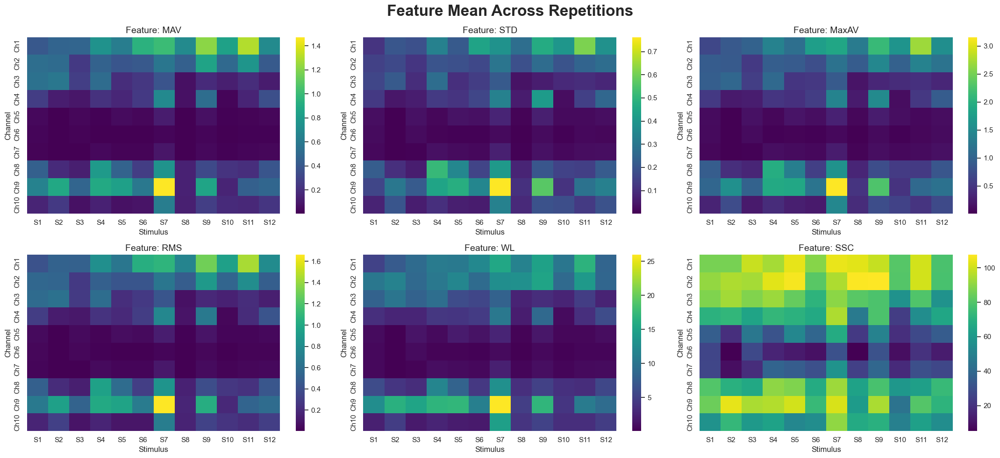

In [308]:
features = {
    "MAV": mav,
    "STD": std,
    "MaxAV": maxav,
    "RMS": rms,
    "WL": wl,
    "SSC": ssc
}

# -------- Identifying stimuli and repetitions --------
stimuli = np.unique(stimulus)
stimuli = stimuli[stimuli != 0]
reps = np.unique(repetition)
reps = reps[reps != 0]

channels_to_use = [i for i in range(emg.shape[1])]
n_channels = len(channels_to_use)

# Slice EMG to remove channel 9
emg_used = emg[:, channels_to_use]

# -------- Compute variance of each feature across repetitions --------

variance_maps = {}
mean_maps = {}

for fname, func in features.items():
    var_matrix = np.zeros((n_channels, len(stimuli)))
    mean_matrix = np.zeros((n_channels, len(stimuli)))

    for s_i, stim_val in enumerate(stimuli):
        feature_values_per_rep = np.zeros((len(reps), n_channels))

        for r_i, rep_val in enumerate(reps):
            mask = np.logical_and(stimulus == stim_val, repetition == rep_val).squeeze()
            segment = emg_used[mask, :]

            if segment.size > 0:
                feature_values_per_rep[r_i, :] = func(segment)
            else:
                feature_values_per_rep[r_i, :] = np.nan

        # variance across repetitions
        var_matrix[:, s_i] = np.nanvar(feature_values_per_rep, axis=0)
        mean_matrix[:, s_i] = np.mean(feature_values_per_rep, axis=0)

    variance_maps[fname] = var_matrix
    mean_maps[fname] = mean_matrix

# -------- Plot 6 heatmaps --------

fig, axes = plt.subplots(2, 3, figsize=(22, 10))
axes = axes.flatten()
fig.suptitle("Feature Mean Across Repetitions", fontsize=24, fontweight='bold')

for ax, (fname, mat) in zip(axes, mean_maps.items()):
    sns.heatmap(
        mat,
        ax=ax,
        cmap="viridis",
        xticklabels=[f"S{int(s)}" for s in stimuli],
        yticklabels=[f"Ch{channels_to_use[c]+1}" for c in range(n_channels)],
        cbar=True
    )
    ax.set_title(f"Feature: {fname}", fontsize=14)
    ax.set_xlabel("Stimulus")
    ax.set_ylabel("Channel")

plt.tight_layout()
plt.show()



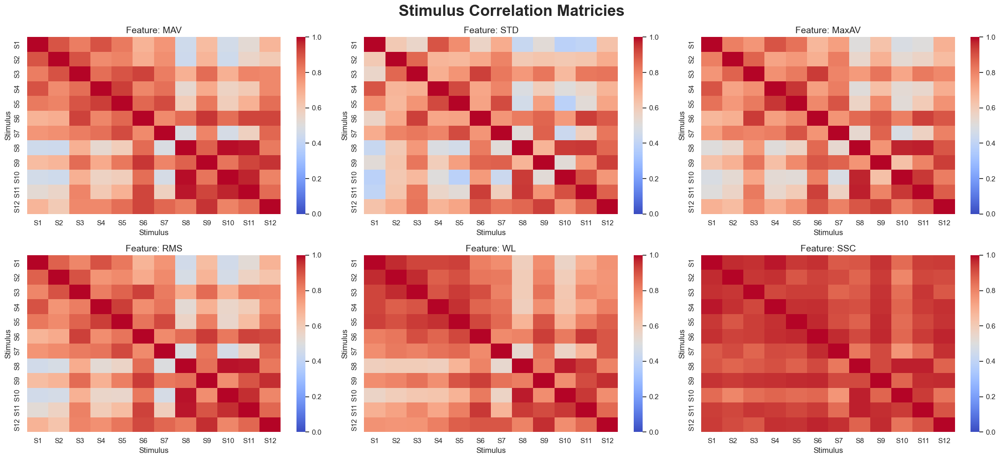

In [309]:
# ------------------------------------------------------------
# Compute correlation matrices between stimuli for each feature
# ------------------------------------------------------------

correlation_matrices = {}   # will hold 6 matrices

for fname, mean_matrix in mean_maps.items():
    # mean_matrix has shape (channels, stimuli)
    # We want stimulus vectors → transpose
    stim_vectors = mean_matrix.T   # shape: (stimuli, channels)

    # Compute correlation matrix (stimulus × stimulus)
    corr = np.corrcoef(stim_vectors)
    correlation_matrices[fname] = corr

# ------------------------------------------------------------
# Plot the 6 correlation matrices
# ------------------------------------------------------------

fig, axes = plt.subplots(2, 3, figsize=(22, 10))
axes = axes.flatten()
fig.suptitle("Stimulus Correlation Matricies", fontsize=24, fontweight='bold')

for ax, (fname, corrmat) in zip(axes, correlation_matrices.items()):
    sns.heatmap(
        corrmat,
        ax=ax,
        cmap="coolwarm",
        vmin=0, vmax=1,
        xticklabels=[f"S{int(s)}" for s in stimuli],
        yticklabels=[f"S{int(s)}" for s in stimuli],
        annot=False, fmt=".2f", cbar=True
    )

    ax.set_title(f"Feature: {fname}", fontsize=14)
    ax.set_xlabel("Stimulus")
    ax.set_ylabel("Stimulus")

plt.tight_layout()
plt.show()


By calculating the correlation matrix, we find out how similar the different stimuli are (depending on the feature). The low correlation values translate as having distinct signals created for each stimulus. What we dont want are high correlation values. This indicates high similarity between the signals created by the different stimuli, which will make it harder for the classifier to predict. 

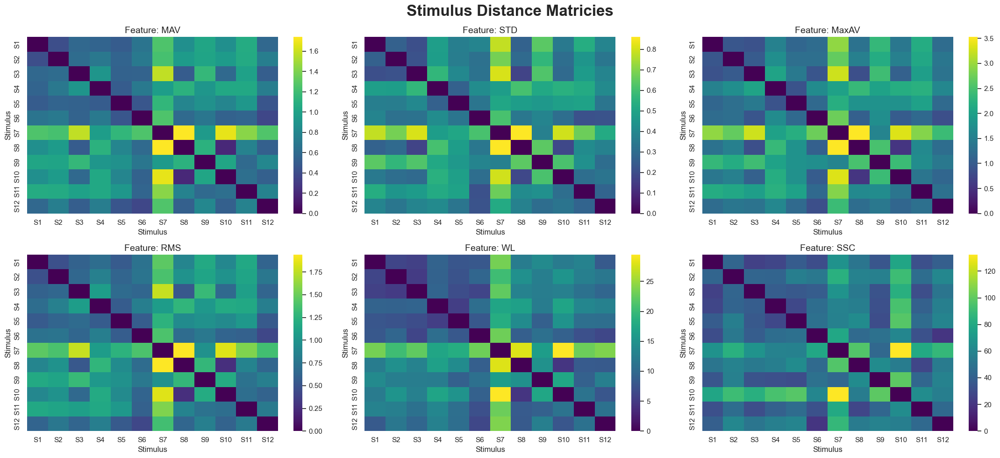

In [310]:
from scipy.spatial.distance import cdist

distance_matrices = {}

for fname, mean_matrix in mean_maps.items():
    # Transpose: stimuli × channels
    stim_vectors = mean_matrix.T  
    
    # Euclidean distance matrix
    dist_mat = cdist(stim_vectors, stim_vectors, metric='euclidean')
    distance_matrices[fname] = dist_mat

# Plot
fig, axes = plt.subplots(2, 3, figsize=(22, 10))
axes = axes.flatten()
fig.suptitle("Stimulus Distance Matricies", fontsize=24, fontweight='bold')

for ax, (fname, distmat) in zip(axes, distance_matrices.items()):
    sns.heatmap(
        distmat,
        ax=ax,
        cmap="viridis",
        xticklabels=[f"S{int(s)}" for s in stimuli],
        yticklabels=[f"S{int(s)}" for s in stimuli],
        annot=False, fmt=".2f",
        cbar=True
    )
    ax.set_title(f"Feature: {fname}", fontsize=14)
    ax.set_xlabel("Stimulus")
    ax.set_ylabel("Stimulus")

plt.tight_layout()
plt.show()


A different way to look at similarity between stimuli is to calculate the distance (in our case Eucledian distance). It calculates the absolute distance in space between the different stimuli.

In combination with the correlation matricies, all 6 features seem to show sufficient difference between the different stimuli to justify using them all for the classificaiton.

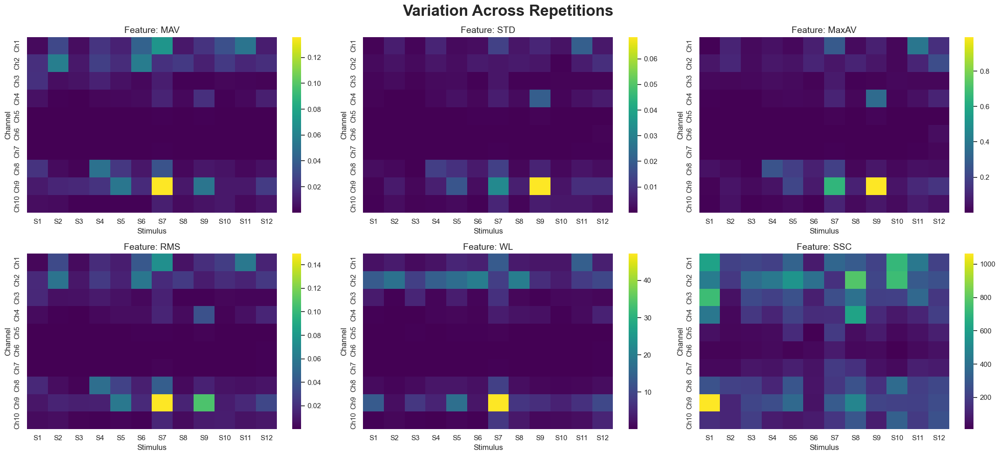

In [311]:
fig, axes = plt.subplots(2, 3, figsize=(22, 10))
axes = axes.flatten()
fig.suptitle("Variation Across Repetitions", fontsize=24, fontweight='bold')

for ax, (fname, mat) in zip(axes, variance_maps.items()):
    sns.heatmap(
        mat,
        ax=ax,
        cmap="viridis",
        xticklabels=[f"S{int(s)}" for s in stimuli],
        yticklabels=[f"Ch{channels_to_use[c]+1}" for c in range(n_channels)],
        cbar=True
    )
    ax.set_title(f"Feature: {fname}", fontsize=14)
    ax.set_xlabel("Stimulus")
    ax.set_ylabel("Channel")

plt.tight_layout()
plt.show()

This shows us variation across repetitions for the different features. The goal would be to have little variance across repetitions. That would tell us that the input data for the classifier is good. It makes sense that the SSC feature shows an overall higher variance as it produces higher values. The same reasoning can be used for high variances in channels that have higher values than others.

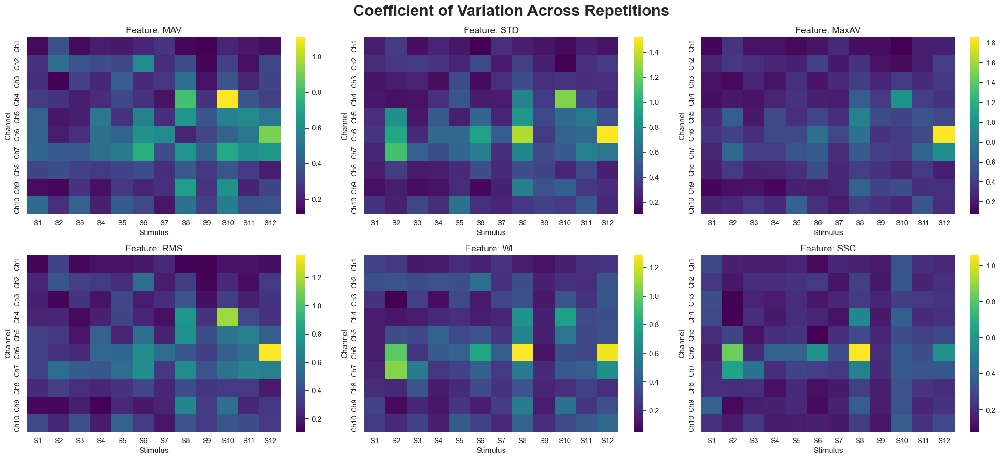

In [312]:
# -------- Identifying stimuli and repetitions --------
stimuli = np.unique(stimulus)
stimuli = stimuli[stimuli != 0]
reps = np.unique(repetition)
reps = reps[reps != 0]

# Remove channel 9 (index=8) if you want to exclude it like before
channels_to_use = [i for i in range(emg.shape[1])]
n_channels = len(channels_to_use)
emg_used = emg[:, channels_to_use]

# -------- Compute coefficient of variation (CV) of each feature across repetitions --------
cv_maps = {}

for fname, func in features.items():
    cv_matrix = np.zeros((n_channels, len(stimuli)))
    for s_i, stim_val in enumerate(stimuli):
        # collect feature value per repetition (reps × channels)
        feature_values_per_rep = np.full((len(reps), n_channels), np.nan)
        for r_i, rep_val in enumerate(reps):
            mask = np.logical_and(stimulus == stim_val, repetition == rep_val).squeeze()
            segment = emg_used[mask, :]
            if segment.size > 0:
                feature_values_per_rep[r_i, :] = func(segment)
        # compute mean and std across repetitions for each channel
        mean_vals = np.nanmean(feature_values_per_rep, axis=0)
        std_vals = np.nanstd(feature_values_per_rep, axis=0)
        # CV = std / mean ; avoid division by zero
        with np.errstate(divide='ignore', invalid='ignore'):
            cv = std_vals / mean_vals
            cv[~np.isfinite(cv)] = np.nan
        cv_matrix[:, s_i] = cv
    cv_maps[fname] = cv_matrix

# -------- Plot heatmaps of CV for each feature --------
fig, axes = plt.subplots(2, 3, figsize=(22, 10))
axes = axes.flatten()
fig.suptitle("Coefficient of Variation Across Repetitions", fontsize=24, fontweight='bold')

for ax, (fname, mat) in zip(axes, cv_maps.items()):
    sns.heatmap(
        mat,
        ax=ax,
        cmap="viridis",
        xticklabels=[f"S{int(s)}" for s in stimuli],
        yticklabels=[f"Ch{channels_to_use[c]+1}" for c in range(n_channels)],
        cbar=True
    )
    ax.set_title(f"Feature: {fname}", fontsize=14)
    ax.set_xlabel("Stimulus")
    ax.set_ylabel("Channel")

plt.tight_layout()
plt.show()

If we now normalize it and calculate the coefficient of variation (CV = std/mean) per channel for each stimulus, the channels 4 to 6 show higher variation. This can be explained by the overall lower signal in those channels (see graph depicting "Envelopes of EMG Signals").

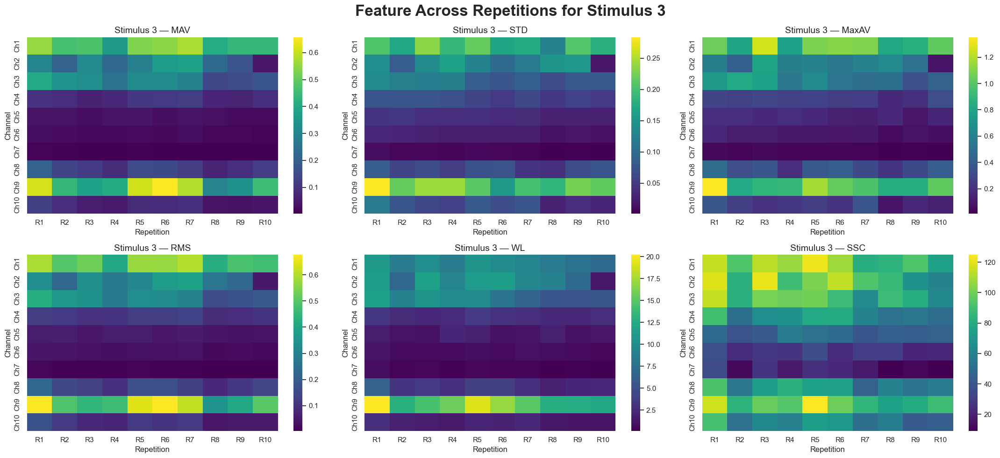

In [313]:
# --------- Prepare axes ---------
stim_to_plot = 3
reps = np.unique(repetition)
reps = reps[reps != 0]
n_reps = len(reps)
n_channels = emg.shape[1]

fig, axes = plt.subplots(2, 3, figsize=(22, 10))
axes = axes.flatten()
fig.suptitle("Feature Across Repetitions for Stimulus 3", fontsize=24, fontweight='bold')

# --------- Loop over features ---------
for ax, (fname, func) in zip(axes, features.items()):

    heatmap_data = np.zeros((n_channels, n_reps))

    for r_i, rep in enumerate(reps):

        mask = np.logical_and(stimulus == stim_to_plot, repetition == rep).squeeze()
        segment = emg[mask, :]

        if segment.size > 0:
            heatmap_data[:, r_i] = func(segment)
        else:
            heatmap_data[:, r_i] = np.nan

    sns.heatmap(
        heatmap_data,
        ax=ax,
        cmap="viridis",
        cbar=True,
        xticklabels=[f"R{int(r)}" for r in reps],
        yticklabels=[f"Ch{c+1}" for c in range(n_channels)]
    )

    ax.set_title(f"Stimulus {stim_to_plot} — {fname}", fontsize=14)
    ax.set_xlabel("Repetition")
    ax.set_ylabel("Channel")

plt.tight_layout()
plt.show()


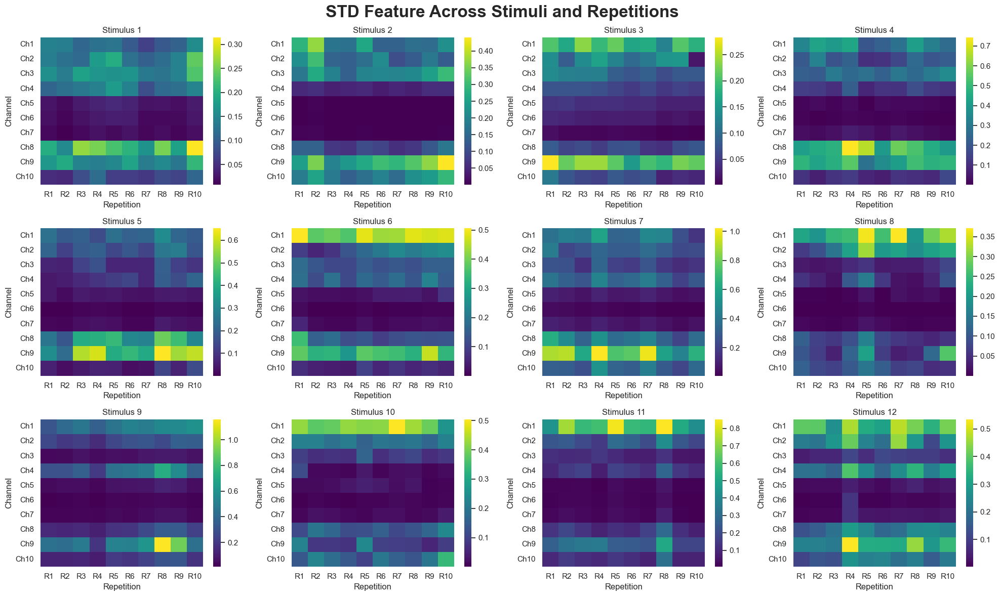

In [314]:
# --------- Plot STD feature across all stimuli and repetitions ---------
# ----- Identify number of stimuli and repetitions -----
stimuli = np.unique(stimulus)
stimuli = stimuli[stimuli != 0]  # remove resting class 0
reps = np.unique(repetition)
reps = reps[reps != 0]

n_stimuli = len(stimuli)
n_reps = len(reps)
n_channels = emg.shape[1]

# ----- Prepare the figure: 12 heatmaps -----
fig, axes = plt.subplots(3, 4, figsize=(20, 12))
axes = axes.flatten()
fig.suptitle("STD Feature Across Stimuli and Repetitions", fontsize=24, fontweight='bold')

for idx, stim in enumerate(stimuli):
    # Create matrix: channels × repetitions
    heatmap_data = np.zeros((n_channels, n_reps))
    
    for r_i, rep in enumerate(reps):
        # select timepoints for this stimulus & repetition
        mask = np.logical_and(stimulus == stim, repetition == rep).squeeze()
        emg_seg = emg[mask, :]
        
        if emg_seg.size > 0:
            heatmap_data[:, r_i] = std(emg_seg)
        else:
            heatmap_data[:, r_i] = np.nan

    ax = axes[idx]
    sns.heatmap(
        heatmap_data,
        ax=ax,
        cmap="viridis",
        cbar=True,
        xticklabels=[f"R{r}" for r in reps],
        yticklabels=[f"Ch{c+1}" for c in range(n_channels)]
    )

    ax.set_title(f"Stimulus {stim}")
    ax.set_xlabel("Repetition")
    ax.set_ylabel("Channel")

plt.tight_layout()
plt.show()


## Classification

Now that we have created the dataset, we need to split it into training, validation and testing data.

In [329]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import StandardScaler

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(dataset, labels, test_size=0.1)

# The training set will later be split into training and validation when doing crossvalidation
# Now we will do one training split for the hyperparametr sweep:
X1_train, X_val, y1_train, y_val = train_test_split(X_train, y_train, test_size=1/5)

print(f"Size of test data set: ", X_test.shape)
print(f"Size of training data set: ", X1_train.shape)
print(f"Size of validation data set: ", X_val.shape)

# Normalizing the data
# StandardScaler is used to scale the features so that they have a mean of 0 and a standard deviation of 1
scaler = StandardScaler()
X_train_z = scaler.fit_transform(X_train)
X1_train_z = scaler.fit_transform(X1_train)  # Fit the scaler on the training data and transform it
X_val_z = scaler.transform(X_val)        # Transform the test data using the same scaler
X_test_z = scaler.transform(X_test)

# Finally we can initialize the random forest classifier
clf = RandomForestClassifier()


Size of test data set:  (12, 60)
Size of training data set:  (86, 60)
Size of validation data set:  (22, 60)


Lets to a hyperparameter sweep

In [330]:
# Lets find the best hyperparameters for the random forest classifier
from sklearn.model_selection import GridSearchCV

param_grid = {
    "n_estimators": [60,70, 80 ,90,100,110,120,130,140],
    "max_features": ['sqrt', 'log2', None],
}

grid = GridSearchCV(RandomForestClassifier(), param_grid)
grid.fit(X1_train_z, y1_train)

print(f"Best hyperparameters: {grid.best_params_}")

y_pred = grid.predict(X_val_z)

accuracy = accuracy_score(y_val, y_pred)
print(f"Accuracy score of best model: {accuracy}")

Best hyperparameters: {'max_features': 'log2', 'n_estimators': 90}
Accuracy score of best model: 0.9090909090909091


Now we can evaluate the classifier parameters by doing a 5-fold cross-validaiton

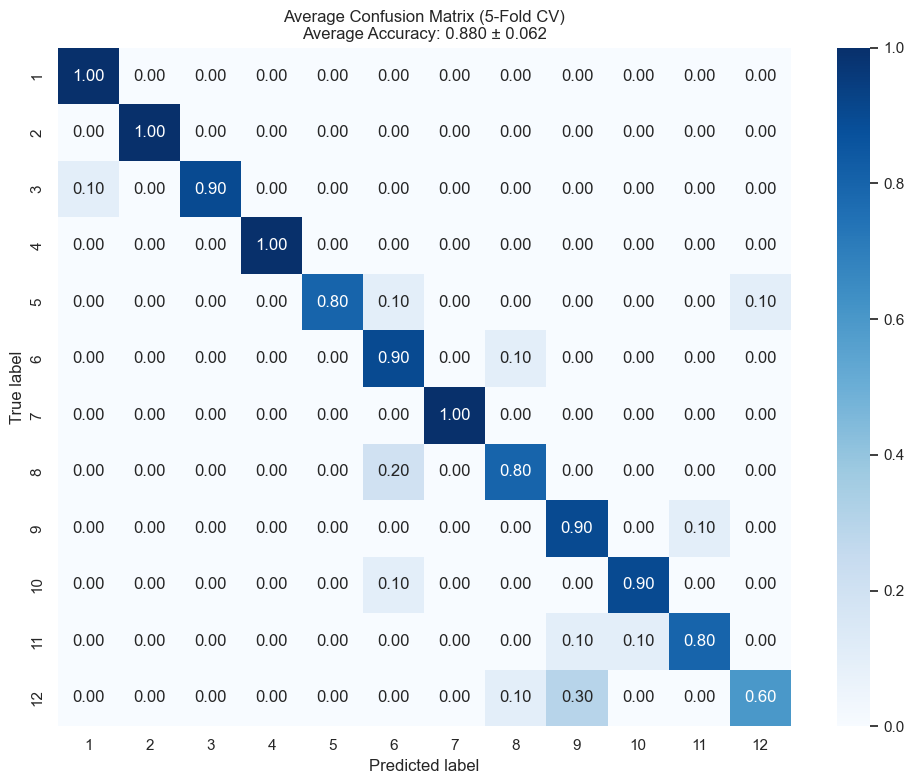

In [331]:
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import confusion_matrix

# Initialize cross-validation splitter
n_splits = 5
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Get all unique labels
all_labels = np.unique(y_train).astype(int)

# Store confusion matrices and accuracies from each fold
confusion_matrices = []
fold_accuracies = []

# Iterate through each fold
for fold, (train_idx, val_idx) in enumerate(skf.split(X_train_z, y_train)):
    # Split data for this fold
    X_fold_train = X_train_z[train_idx]
    y_fold_train = y_train[train_idx]
    X_fold_val = X_train_z[val_idx]
    y_fold_val = y_train[val_idx]
    
    # Train classifier on this fold
    clf.fit(X_fold_train, y_fold_train)
    
    # Predict on validation set
    y_pred = clf.predict(X_fold_val)
    
    # Compute confusion matrix with fixed labels
    cm = confusion_matrix(y_fold_val, y_pred, labels=all_labels, normalize='true')
    confusion_matrices.append(cm)
    
    # Compute accuracy for this fold
    fold_acc = np.mean(y_pred == y_fold_val)
    fold_accuracies.append(fold_acc)

# Average confusion matrix and accuracy
avg_confusion_matrix = np.mean(confusion_matrices, axis=0)
avg_accuracy = np.mean(fold_accuracies)
std_accuracy = np.std(fold_accuracies)

# Plot the average confusion matrix with accuracy
fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(avg_confusion_matrix, annot=True, fmt='.2f', cmap='Blues', ax=ax,
            xticklabels=all_labels, yticklabels=all_labels)
ax.set_ylabel("True label")
ax.set_xlabel("Predicted label")
ax.set_title(f"Average Confusion Matrix ({n_splits}-Fold CV)\nAverage Accuracy: {avg_accuracy:.3f} ± {std_accuracy:.3f}")
plt.tight_layout()
plt.show()


## Feature Selection / Dimensionnality reduction

### Method 1: Feature Selection

Same as before, we'll do 5-fold cross-validation, but this time we will only include 20 features with the most information

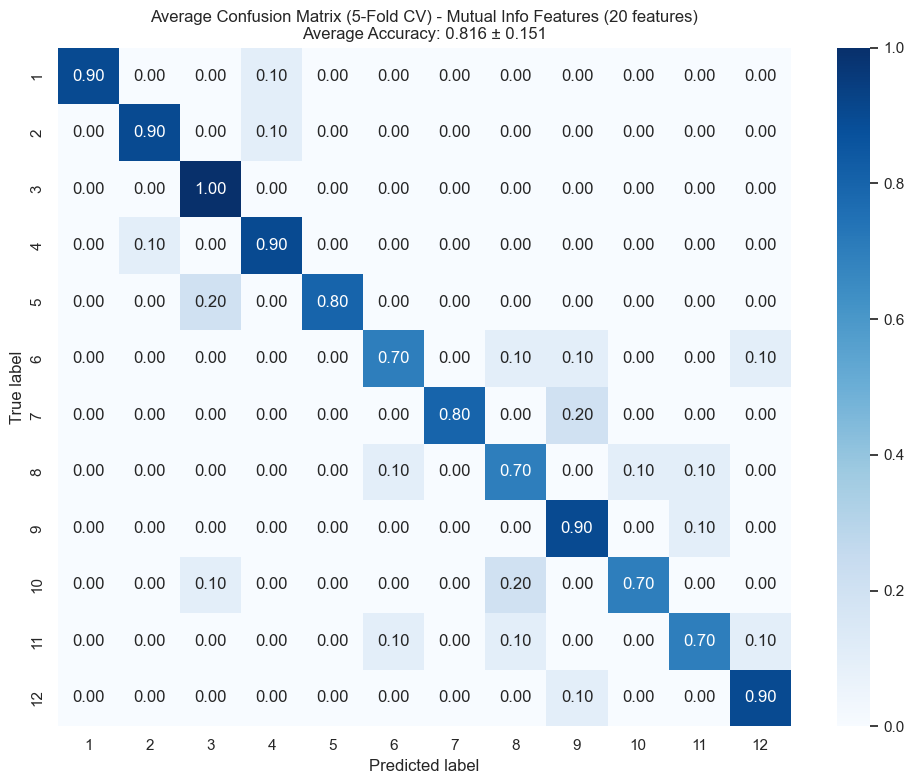

In [332]:
from sklearn.feature_selection import mutual_info_classif, SelectKBest

confusion_matrices_kbest = []
fold_accuracies_kbest = []

for fold, (train_idx, val_idx) in enumerate(skf.split(X_train_z, y_train)):

    # Split raw features (NO feature selection yet)
    X_fold_train = X_train_z[train_idx]
    y_fold_train = y_train[train_idx]
    X_fold_val = X_train_z[val_idx]
    y_fold_val = y_train[val_idx]

    # -------- Feature selection FIT ONLY on training fold --------
    k_best = SelectKBest(score_func=mutual_info_classif, k=20)
    X_fold_train_best = k_best.fit_transform(X_fold_train, y_fold_train)
    X_fold_val_best = k_best.transform(X_fold_val)
    # -------------------------------------------------------------

    clf.fit(X_fold_train_best, y_fold_train)

    y_pred = clf.predict(X_fold_val_best)

    cm = confusion_matrix(
        y_fold_val,
        y_pred,
        labels=all_labels,
        normalize="true"
    )
    confusion_matrices_kbest.append(cm)

    fold_acc = np.mean(y_pred == y_fold_val)
    fold_accuracies_kbest.append(fold_acc)

avg_confusion_matrix_kbest = np.mean(confusion_matrices_kbest, axis=0)
avg_accuracy_kbest = np.mean(fold_accuracies_kbest)
std_accuracy_kbest = np.std(fold_accuracies_kbest)

fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(avg_confusion_matrix_kbest, annot=True, fmt='.2f', cmap='Blues', ax=ax,
            xticklabels=all_labels, yticklabels=all_labels)
ax.set_ylabel("True label")
ax.set_xlabel("Predicted label")
ax.set_title(f"Average Confusion Matrix ({n_splits}-Fold CV) - Mutual Info Features (20 features)\nAverage Accuracy: {avg_accuracy_kbest:.3f} ± {std_accuracy_kbest:.3f}")
plt.tight_layout()
plt.show()


 ### Method 2 : PCA

Another method is to reduce the dimensions before doing the prediciton, here done with PCA

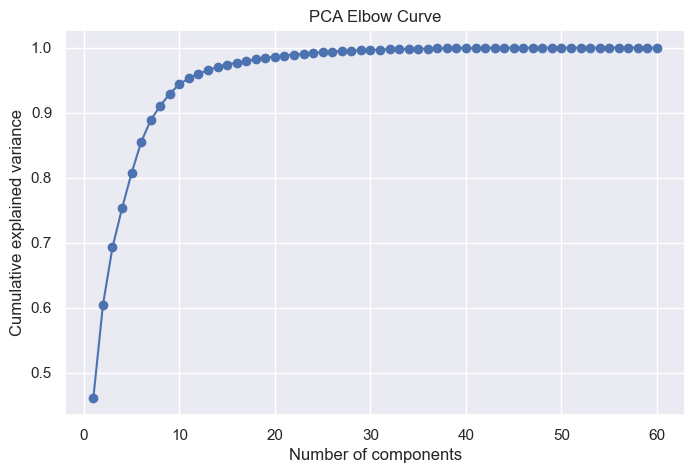

In [333]:
from sklearn.decomposition import PCA

# We already have the standardized data (X_train_z, X_val_z, X_test_z)

n_components = X1_train_z.shape[1]
pca_test = PCA(n_components=n_components) # full PCA to plot the elbow curve
pca_test.fit(X1_train_z)

explained_var = np.cumsum(pca_test.explained_variance_ratio_)

plt.figure(figsize=(8,5))
plt.plot(range(1, len(explained_var)+1), explained_var, marker='o')
plt.xlabel("Number of components")
plt.ylabel("Cumulative explained variance")
plt.title("PCA Elbow Curve")
plt.grid(True)
plt.show()



Reduce the number of components

Number of components to reach 90% variance: 8


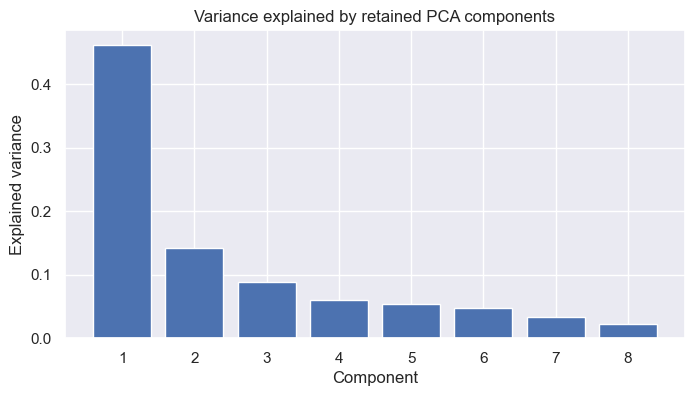

In [334]:
n_components_reduced = np.argmax(explained_var >= 0.9) + 1
print("Number of components to reach 90% variance:", n_components_reduced)

# Fit PCA with chosen number of components
pca = PCA(n_components=n_components_reduced)
X1_train_pca = pca.fit_transform(X1_train_z)
# X_val_pca   = pca.transform(X_val_z)
# X_test_pca  = pca.transform(X_test_z)

# Visualize relativ importance of each components kept
plt.figure(figsize=(8,4))
plt.bar(range(1, n_components_reduced+1), pca.explained_variance_ratio_)
plt.xlabel("Component")
plt.ylabel("Explained variance")
plt.title("Variance explained by retained PCA components")
plt.grid(True)
plt.show()

Same as for the Feature Extraction, we did a 5-fold cross-validation and only using the first 8 components of the PCA.

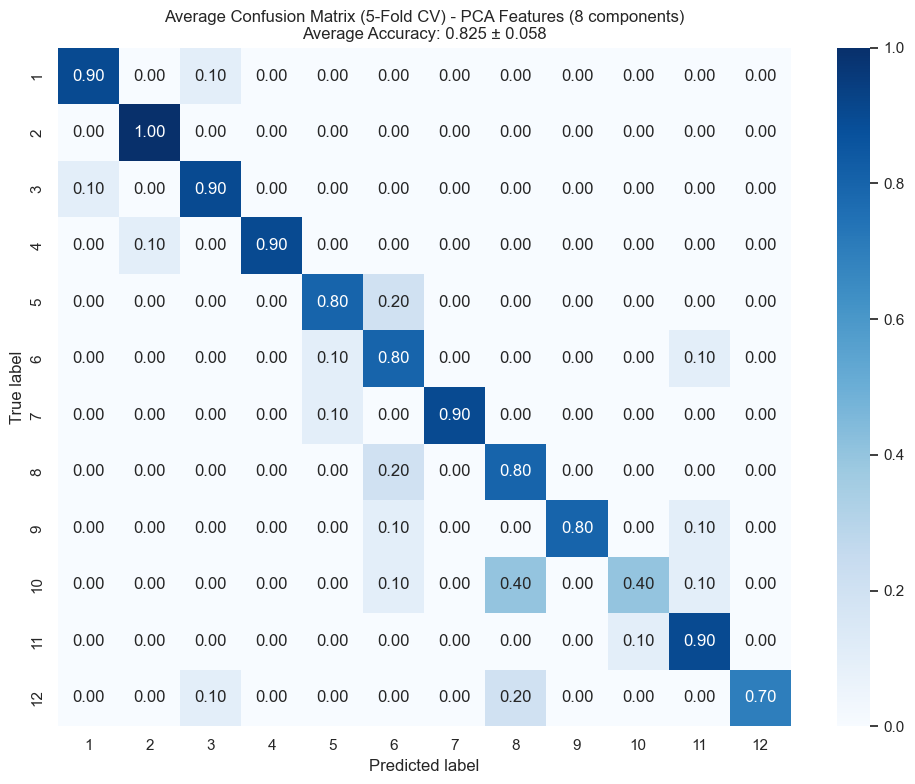

In [338]:
confusion_matrices_pca = []
fold_accuracies_pca = []

for fold, (train_idx, val_idx) in enumerate(skf.split(X_train_z, y_train)):

    # Split raw standardized data
    X_fold_train = X_train_z[train_idx]
    y_fold_train = y_train[train_idx]
    X_fold_val = X_train_z[val_idx]
    y_fold_val = y_train[val_idx]

    # -------- PCA FIT ONLY on training fold --------
    pca = PCA(n_components=n_components_reduced, random_state=42)
    X_fold_train_pca = pca.fit_transform(X_fold_train)
    X_fold_val_pca = pca.transform(X_fold_val)
    # ----------------------------------------------

    clf.fit(X_fold_train_pca, y_fold_train)

    y_pred = clf.predict(X_fold_val_pca)

    cm = confusion_matrix(
        y_fold_val,
        y_pred,
        labels=all_labels,
        normalize="true"
    )
    confusion_matrices_pca.append(cm)

    fold_acc = np.mean(y_pred == y_fold_val)
    fold_accuracies_pca.append(fold_acc)

avg_confusion_matrix_pca = np.mean(confusion_matrices_pca, axis=0)
avg_accuracy_pca = np.mean(fold_accuracies_pca)
std_accuracy_pca = np.std(fold_accuracies_pca)

# Plot the average confusion matrix with accuracy
fig, ax = plt.subplots(figsize=(10, 8))
sns.heatmap(avg_confusion_matrix_pca, annot=True, fmt='.2f', cmap='Blues', ax=ax,
            xticklabels=all_labels, yticklabels=all_labels)
ax.set_ylabel("True label")
ax.set_xlabel("Predicted label")
ax.set_title(f"Average Confusion Matrix ({n_splits}-Fold CV) - PCA Features ({n_components_reduced} components)\nAverage Accuracy: {avg_accuracy_pca:.3f} ± {std_accuracy_pca:.3f}")
plt.tight_layout()
plt.show()


Because we found that the highest accuracies came from the first classification we will predict our test set on the first classifier 

Accuracy score: 0.9166666666666666


Text(0.5, 1.0, 'Confusion Matrix of test set')

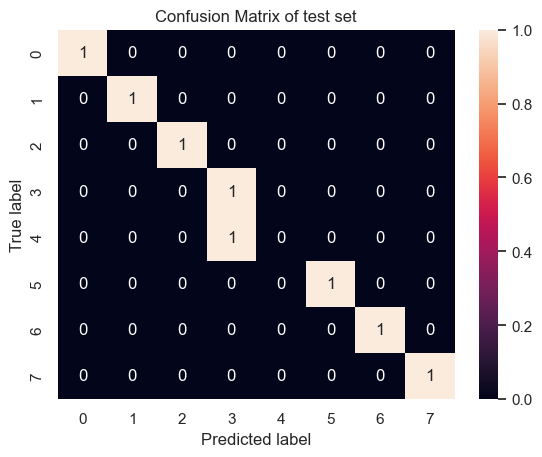

In [271]:
clf.fit(X1_train, y1_train)

# Predict the labels for the test set using the trained model.
y_pred = clf.predict(X_test)

# Calculate the accuracy of the model with the selected features.
# Accuracy is the ratio of correctly predicted instances to the total instances.
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy score: {accuracy}")

# Create a confusion matrix to visualize the performance of the classification model.
# The confusion matrix shows the true vs predicted labels.
confmat = confusion_matrix(y_test, y_pred, normalize="true")

# Plot the confusion matrix using a heatmap for better visualization.
fig, ax = plt.subplots()
sns.heatmap(confmat, annot=True, ax=ax)
ax.set_ylabel("True label")
ax.set_xlabel("Predicted label")
ax.set_title("Confusion Matrix of test set")

# Part 2
## Part 1 : Visualization and Preprocessing of the Data with the 27 Subjects

#### Downloading of Data

In [4]:
import os
from scipy.io import loadmat

# Loop over subjects 1 to 27
for subject in range(1, 28):
    # Construct the path for each subject
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    # Check if the file exists before trying to load it
    if os.path.exists(data_path):
        data = loadmat(data_path)
        print(f"\nDataset variables for Subject {subject}:")
        
        # Iterate through the keys of the loaded data and print the relevant ones
        for key in data.keys():
            if not key.startswith("__"):
                print(f"  {key}")
        
        # Extract EMG data
        emg = data["emg"]
        print(f"EMG data for Subject {subject}:")

        # Print the EMG data dimension and type
        print("EMG data dimension: {}".format(emg.shape))
        print("EMG data type: {}".format(type(emg)))
        
        # Get the shape information for EMG
        data_shape = emg.shape
        n_timepoints = emg.shape[0]
        n_channels = emg.shape[1]

        # Print the shape and other details
        print(f'The shape of the EMG data is {data_shape}')
        print(f'There are {n_timepoints} timepoints')
        print(f'There are {n_channels} channels\n')
        
    else:
        print(f"File for Subject {subject} does not exist: {data_path}")



Dataset variables for Subject 1:
  emg
  stimulus
  glove
  subject
  exercise
  repetition
  restimulus
  rerepetition
EMG data for Subject 1:
EMG data dimension: (101014, 10)
EMG data type: <class 'numpy.ndarray'>
The shape of the EMG data is (101014, 10)
There are 101014 timepoints
There are 10 channels


Dataset variables for Subject 2:
  subject
  exercise
  stimulus
  emg
  glove
  restimulus
  repetition
  rerepetition
EMG data for Subject 2:
EMG data dimension: (100686, 10)
EMG data type: <class 'numpy.ndarray'>
The shape of the EMG data is (100686, 10)
There are 100686 timepoints
There are 10 channels


Dataset variables for Subject 3:
  subject
  exercise
  stimulus
  emg
  glove
  restimulus
  repetition
  rerepetition
EMG data for Subject 3:
EMG data dimension: (100720, 10)
EMG data type: <class 'numpy.ndarray'>
The shape of the EMG data is (100720, 10)
There are 100720 timepoints
There are 10 channels


Dataset variables for Subject 4:
  subject
  exercise
  stimulus
  em

## Preprocessing of the Data 

As in part 1, the data are partially preprocessed, i.e. already amplified, bandpass-filtered and RMS rectified. The signals were also cleaned  from 50 Hz (and harmonics) power-line interference using a Hampel filter. 

### Visualization of the EMG Signal on One Channel

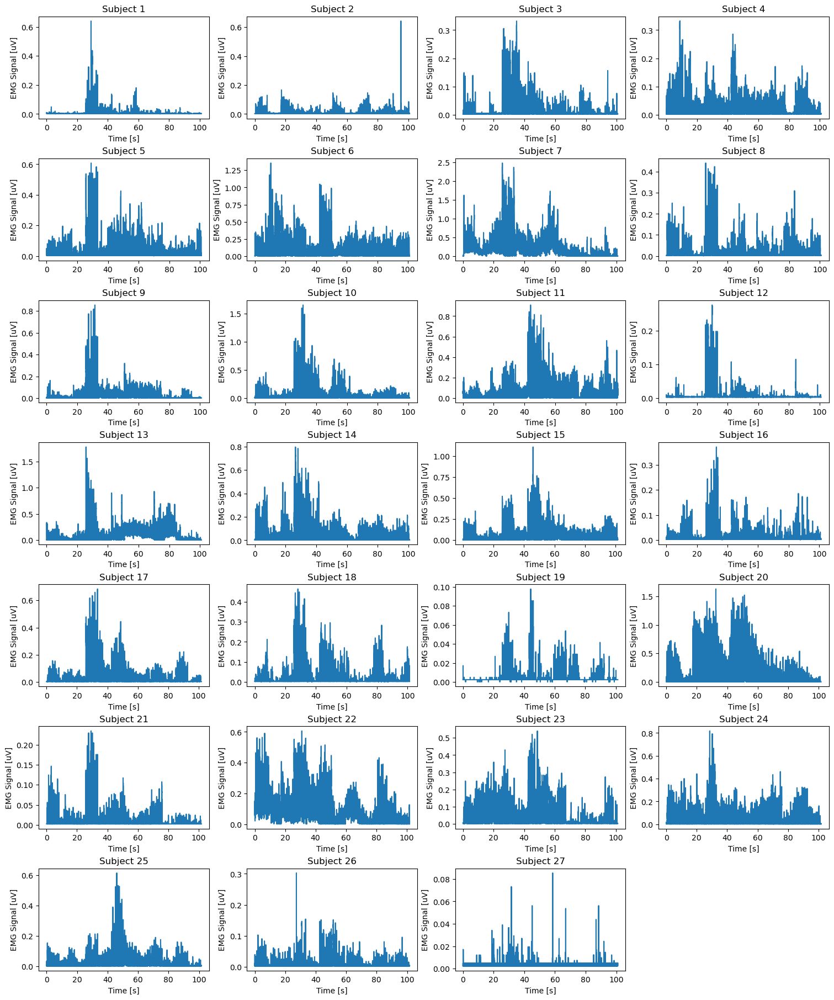

In [5]:
import os
import matplotlib.pyplot as plt
from scipy.io import loadmat
import numpy as np

# Loop over subjects 1 to 27
fig, axes = plt.subplots(7, 4, figsize=(15, 18), constrained_layout=True)  # 7 rows, 4 columns
axes = axes.flatten()  # Flatten to easily index axes

# Assuming fs (sampling frequency) is known, for example:
fs = 1000  # 1000 Hz (samples per second)

# Loop through each subject and plot one channel
for subject in range(1, 28):
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        data = loadmat(data_path)
        emg = data["emg"]
        
        # Specify the channel you want to visualize (for example, channel 5)
        EMG_channel = 5
        
        # Time vector for plotting (create evenly spaced time bins from 0 to the total duration of the signal in s)
        time_steps = np.arange(0, emg.shape[0] / fs, 1 / fs)

        # Get the corresponding axis for this subject
        ax = axes[subject - 1]  # axes are zero-indexed, so we subtract 1
        
        # Plot the selected channel for this subject
        ax.plot(time_steps, emg[:, EMG_channel])
        ax.set_title(f"Subject {subject}")
        ax.set_xlabel("Time [s]")
        ax.set_ylabel("EMG Signal [uV]")
        
    else:
        print(f"File for Subject {subject} does not exist: {data_path}")

# Hide any unused subplots (for example, the last subplot if you use a 7x4 grid for 27 subjects)
for i in range(27, 28):  # 28 total plots, 27 used
    axes[i].axis('off')  # Hide the remaining unused axes

# Show the plot
plt.show()


### Envelop Extraction by Applying a Moving Average

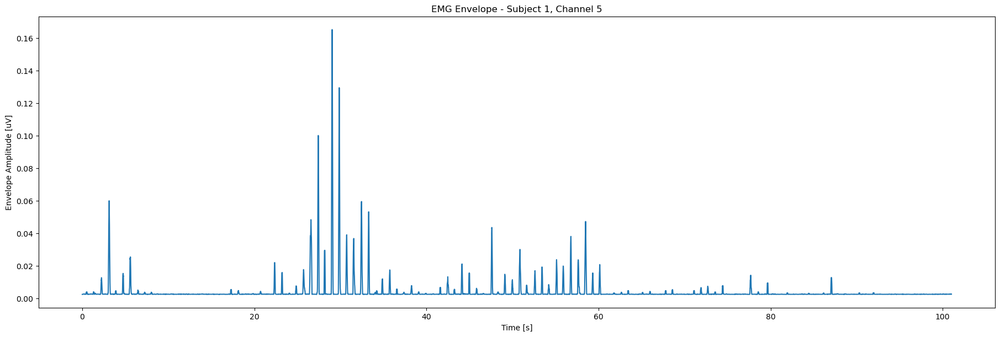

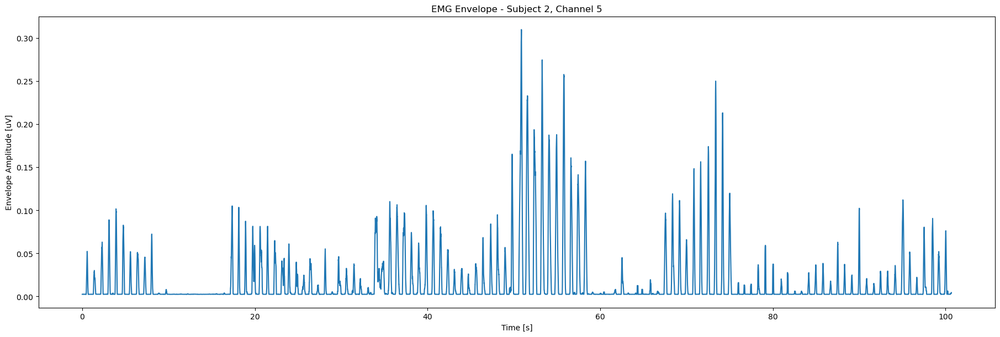

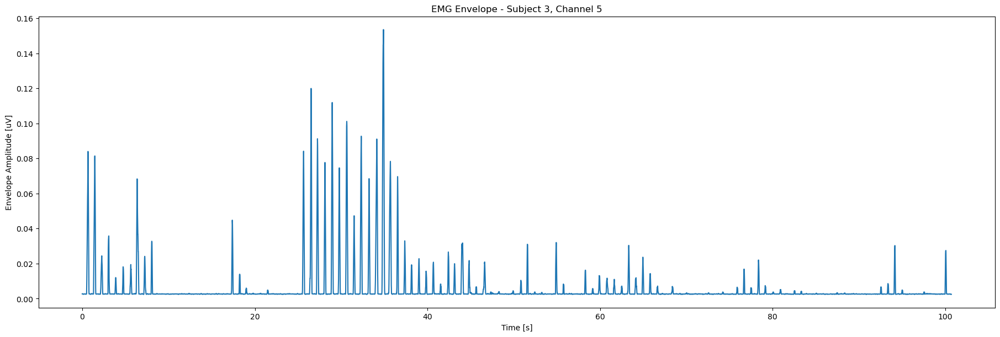

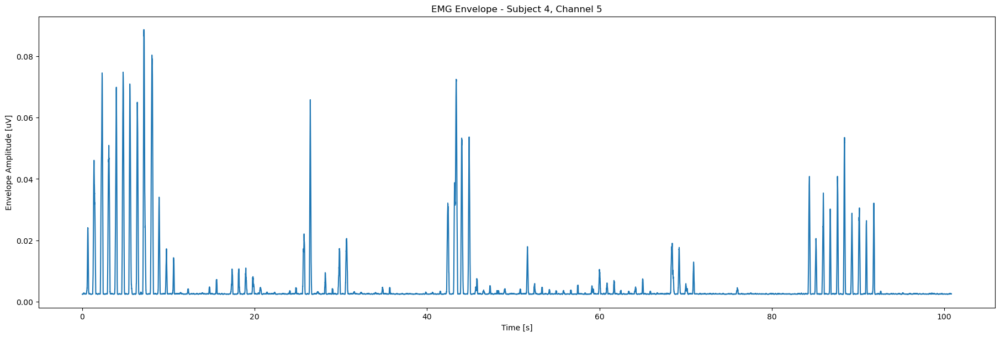

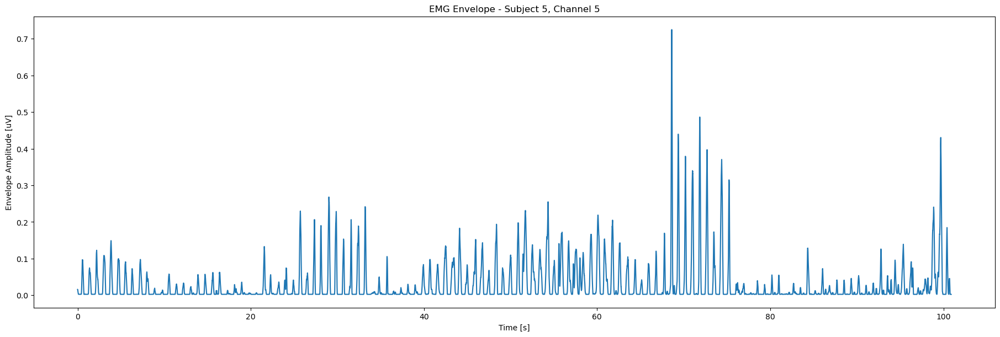

...

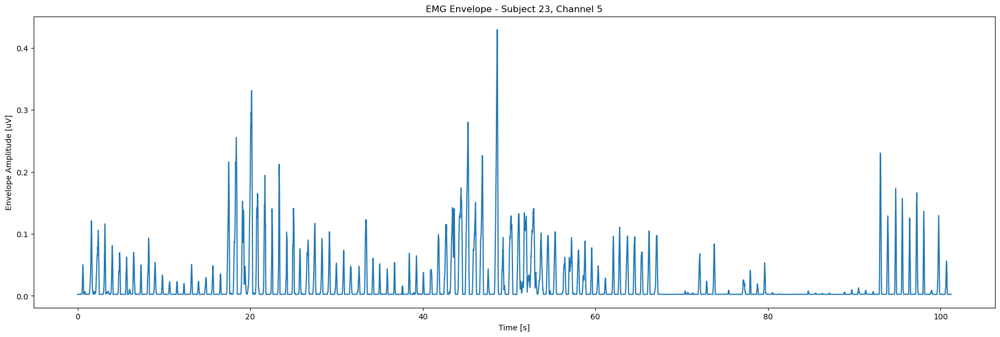

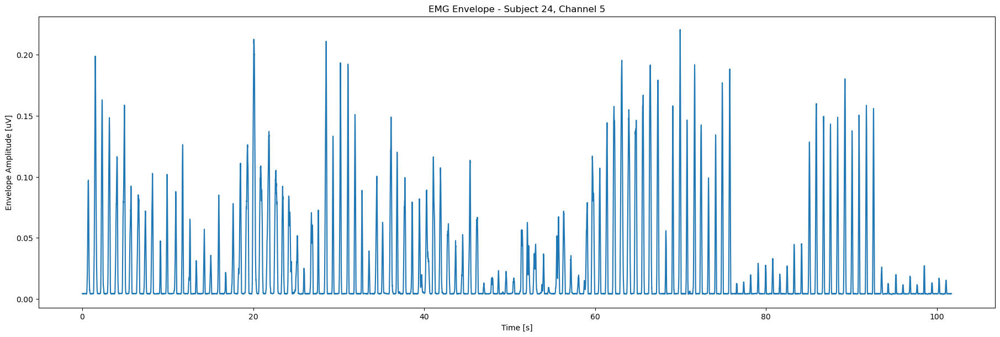

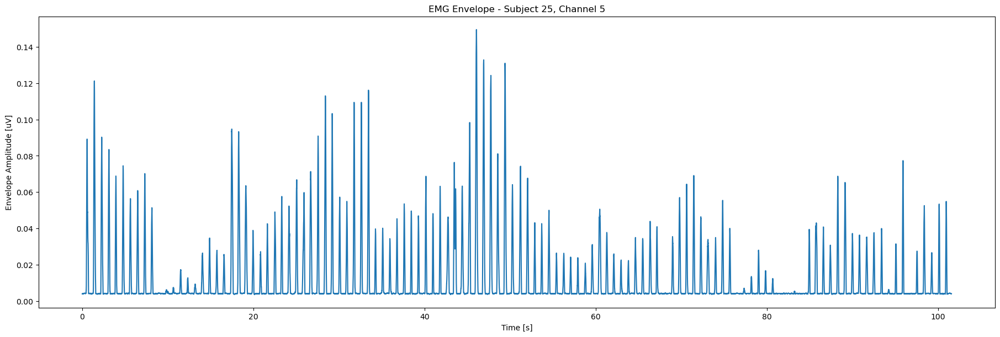

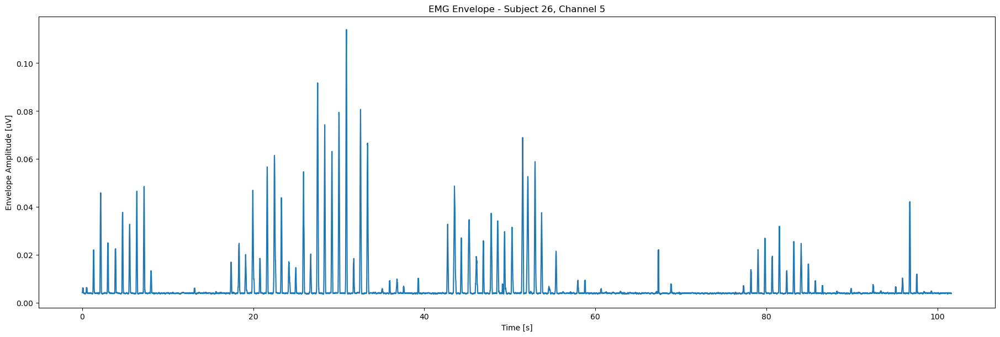

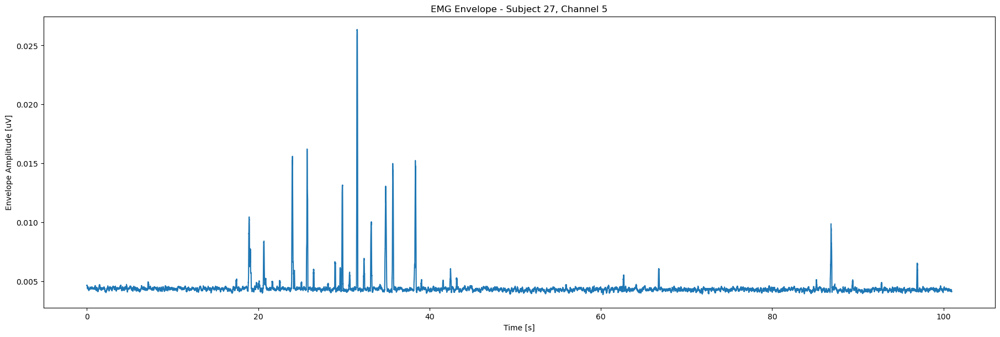

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat
from scipy.ndimage import convolve1d
import os

# Sampling frequency (Hz)
fs = 1000  # Update as needed for your data

# Moving average size for envelope extraction (window size in samples)
mov_mean_size = 100  # You can adjust this value for more or less smoothing
mov_mean_weights = np.ones(mov_mean_size) / mov_mean_size

# Loop over subjects 1 to 27
for subject in range(1, 28):
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"  # Path to subject's data
    
    if os.path.exists(data_path):
        # Load the data for each subject
        data = loadmat(data_path)
        emg = data["emg"]
        
        # Time vector for plotting (create evenly spaced time bins from 0 to the total duration of the signal in s)
        time_steps = np.arange(0, emg.shape[0] / fs, 1 / fs)
        
        # Select the 5th channel (index 4)
        channel_idx = 4
        emg_channel = emg[:, channel_idx]
        
        # Step 1: Rectify the EMG signal (take absolute value)
        emg_rectified = np.abs(emg_channel)
        
        # Step 2: Apply moving average (convolution) to the rectified EMG signal (envelope extraction)
        emg_envelope = convolve1d(emg_rectified, weights=mov_mean_weights, axis=0)
        
        # Create a figure with a single subplot for the envelope
        # Increase figure size to make the plot larger
        fig, ax = plt.subplots(figsize=(18, 6), constrained_layout=True)
        
        # Plot the envelope of the 5th channel
        ax.plot(time_steps, emg_envelope)
        ax.set_xlabel("Time [s]")
        ax.set_ylabel("Envelope Amplitude [uV]")
        ax.set_title(f"EMG Envelope - Subject {subject}, Channel 5")
        
        # Show the plot for the current subject
        plt.show()

    else:
        print(f"File for Subject {subject} does not exist: {data_path}")


### Rectification and Envelope Extraction of EMG Data Across 27 Subjects

In [7]:
import numpy as np
from scipy.io import loadmat
import os

# Number of subjects
n_subjects = 27

# Initialize a list to store the results for each subject
all_number_of_samples_per_trial = []

# Loop through all 27 subjects
for subject in range(1, n_subjects + 1):
    # Path to the subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        # Load the data for the current subject
        data = loadmat(data_path)
        stimulus = data['stimulus'].flatten()  # Ensure it's a 1D array
        repetition = data['repetition'].flatten()  # Ensure it's a 1D array
        
        # Calculate number of unique stimulus types and repetitions (excluding 0)
        n_stimuli = len(np.unique(stimulus)) - 1  # Exclude 0 (resting condition)
        n_repetitions = len(np.unique(repetition)) - 1  # Exclude 0 (non-repetition)

        print(f"Subject {subject}:")
        print(f"How many types of movement are there? {n_stimuli}") 
        print(f"How many repetitions are there? {n_repetitions}")
        
        # Initialize array to store the number of samples per trial for this subject
        number_of_samples_per_trial = np.zeros((n_stimuli, n_repetitions))
        
        # Calculate the number of samples per trial for this subject
        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Find indices for the current stimulus and repetition combination
                idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1)
                
                # Store the number of samples for the current trial
                number_of_samples_per_trial[stimuli_idx, repetition_idx] = np.sum(idx.astype(int))
        
        # Store the results for this subject
        all_number_of_samples_per_trial.append(number_of_samples_per_trial)
        
        # Print the results for this subject
        print(f"Number of samples per trial (Subject {subject}):\n", number_of_samples_per_trial)
    else:
        print(f"Data file for Subject {subject} not found at {data_path}")
        

Subject 1:
How many types of movement are there? 12
How many repetitions are there? 10
Number of samples per trial (Subject 1):
 [[516. 516. 517. 512. 516. 512. 516. 512. 516. 516.]
 [516. 516. 516. 517. 520. 520. 516. 517. 520. 516.]
 [516. 516. 516. 516. 517. 516. 516. 516. 513. 516.]
 [520. 516. 520. 516. 520. 517. 516. 516. 516. 516.]
 [516. 516. 516. 524. 516. 516. 517. 516. 516. 520.]
 [520. 516. 516. 517. 516. 516. 516. 517. 520. 516.]
 [516. 517. 520. 516. 516. 521. 516. 516. 516. 517.]
 [516. 520. 516. 520. 516. 516. 516. 520. 516. 516.]
 [512. 513. 516. 516. 516. 513. 512. 512. 512. 513.]
 [512. 512. 512. 513. 512. 512. 516. 516. 516. 516.]
 [516. 516. 516. 516. 521. 516. 516. 516. 517. 516.]
 [516. 520. 517. 516. 520. 516. 516. 516. 516. 520.]]
Subject 2:
How many types of movement are there? 12
How many repetitions are there? 10
Number of samples per trial (Subject 2):
 [[512. 512. 512. 512. 512. 512. 512. 512. 512. 512.]
 [516. 517. 516. 516. 516. 516. 516. 520. 516. 520.]

/tmp/ipykernel_416/2076013057.py:54: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True)


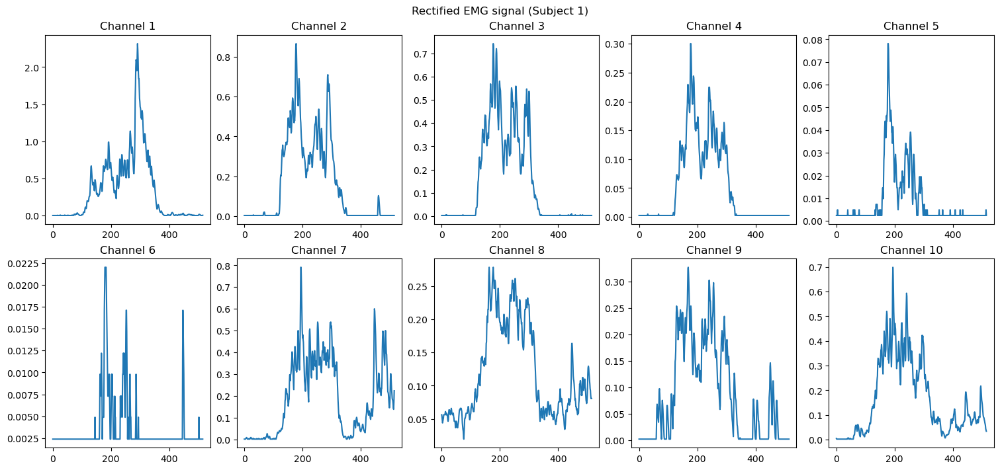

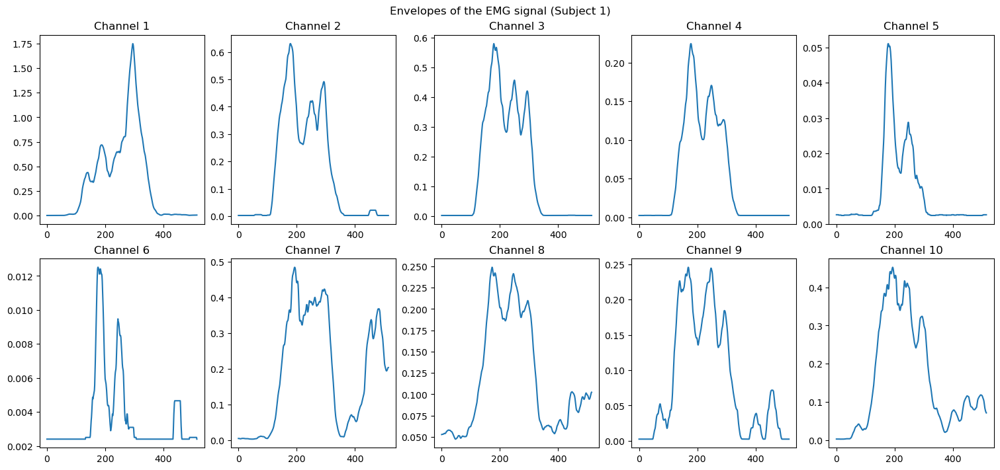

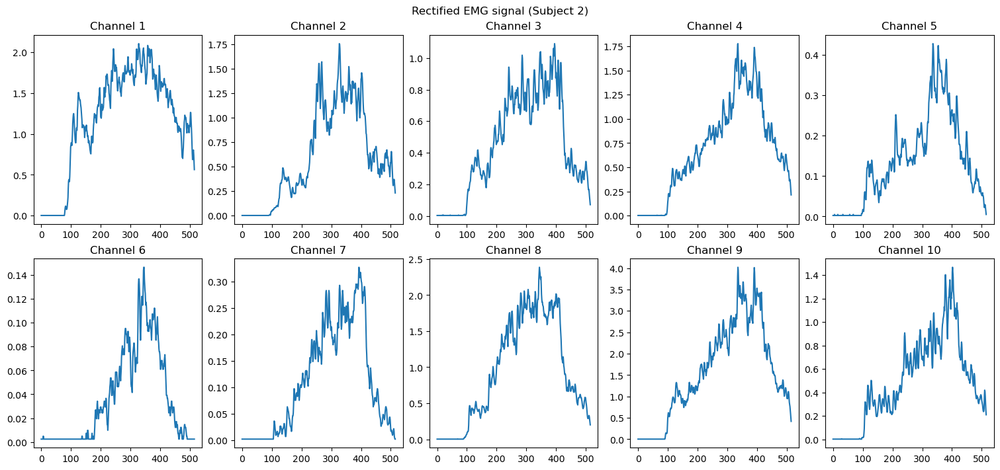

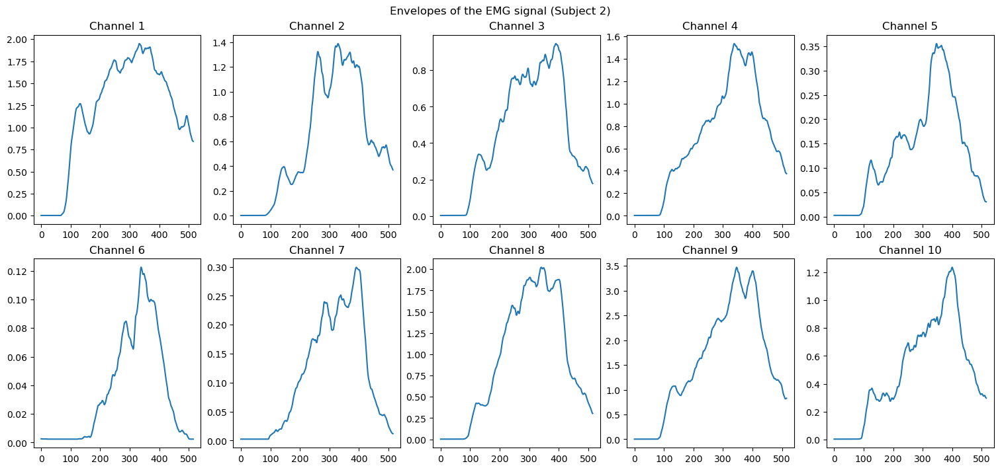

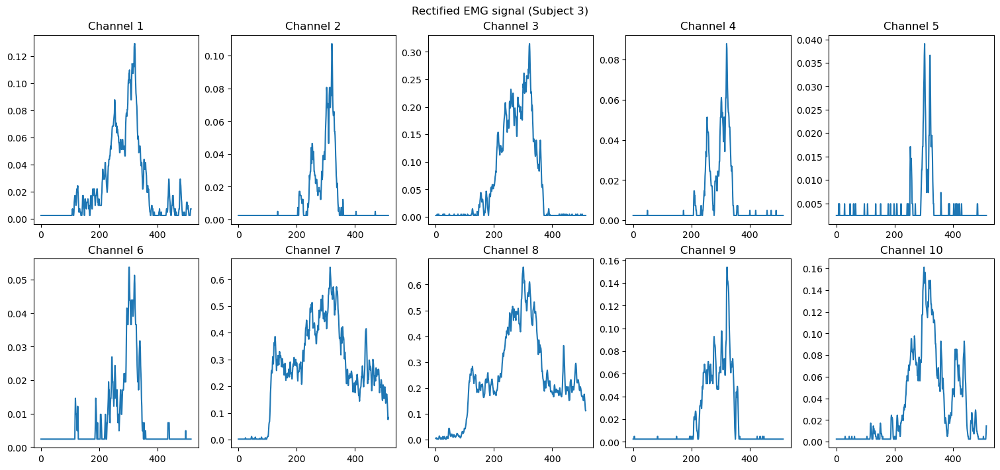

...

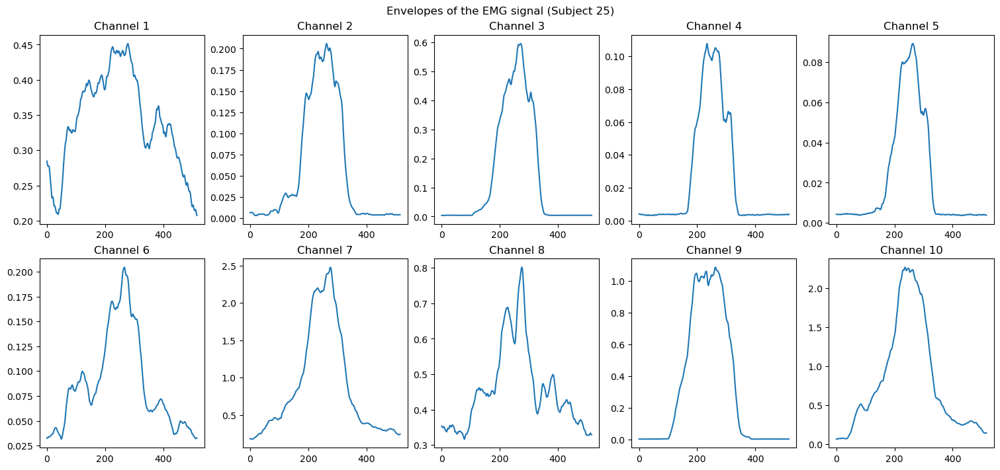

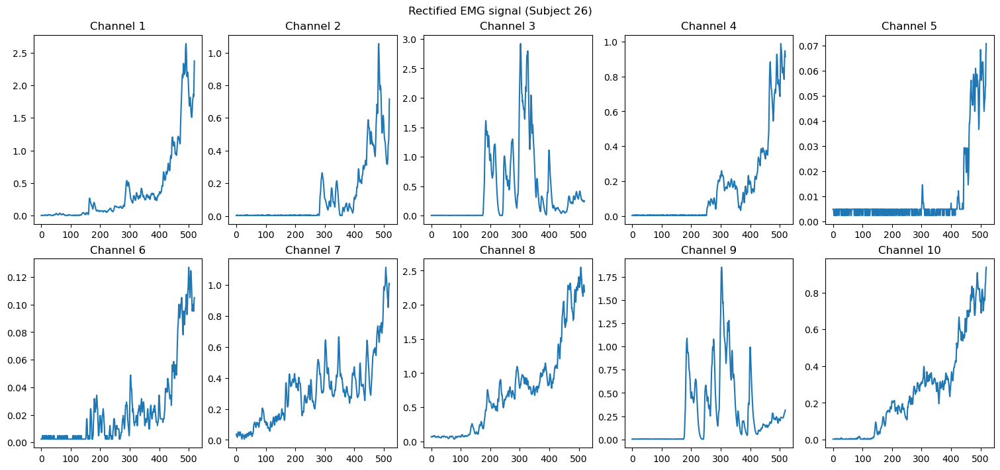

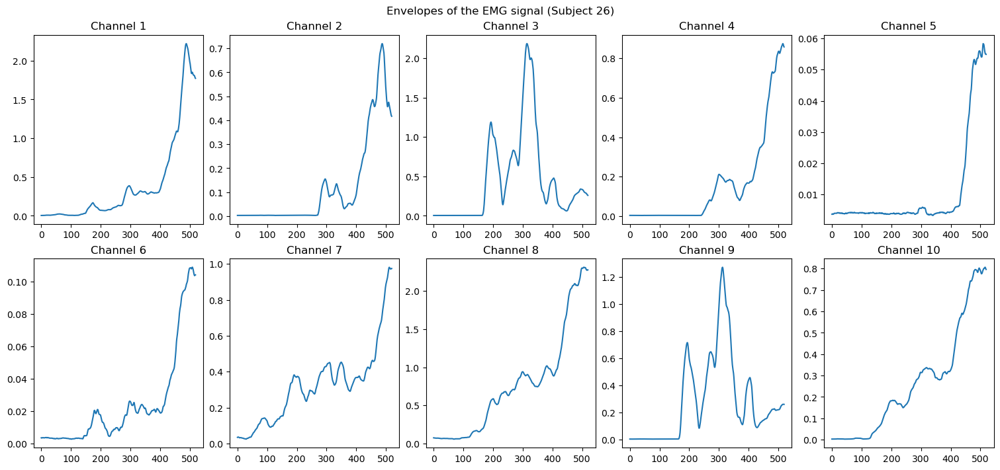

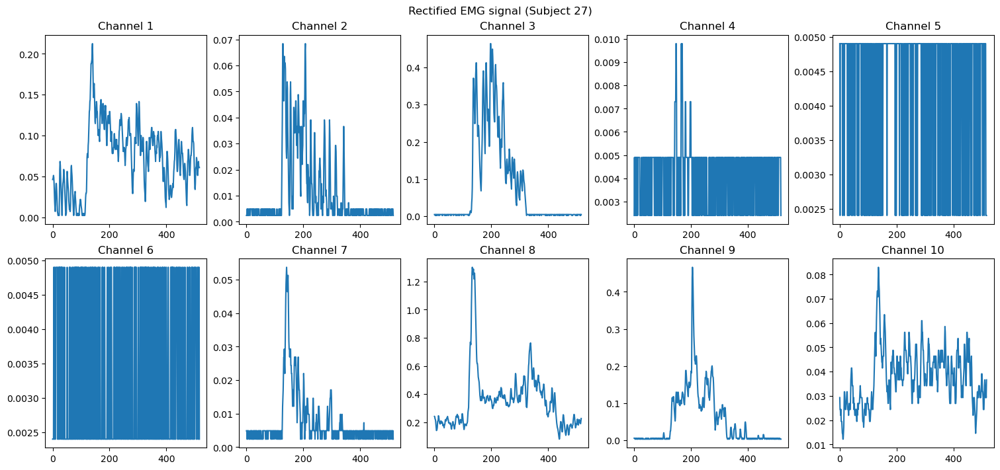

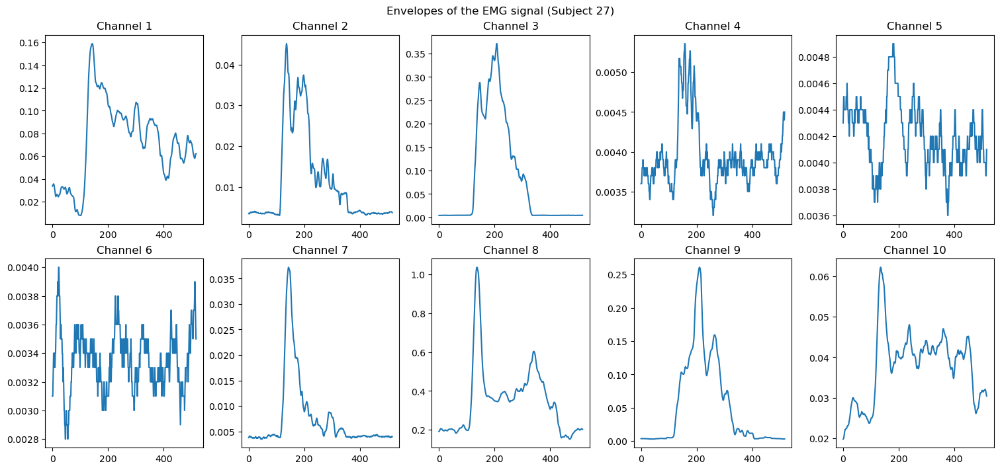

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import convolve1d

# Number of subjects
n_subjects = 27

# Define moving average window size for envelope extraction
mov_mean_length = 25
mov_mean_weights = np.ones(mov_mean_length) / mov_mean_length

# Initialize lists to store the data
all_emg_windows = []
all_emg_envelopes = []

# Loop through all 27 subjects
for subject in range(1, n_subjects + 1):
    # Path to the subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        # Load the data for the current subject
        data = loadmat(data_path)
        stimulus = data['stimulus'].flatten()  # Ensure it's a 1D array
        repetition = data['repetition'].flatten()  # Ensure it's a 1D array
        emg = data['emg']  # Assuming 'emg' is the name of the EMG data in the file

        # Calculate the number of unique stimulus types and repetitions (excluding 0)
        n_stimuli = len(np.unique(stimulus)) - 1  # Exclude 0 (resting condition)
        n_repetitions = len(np.unique(repetition)) - 1  # Exclude 0 (non-repetition)
        
        # Initialize arrays to store the EMG windows and envelopes
        emg_windows = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        emg_envelopes = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        
        # Calculate the number of samples per trial and preprocess the EMG signal
        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Find indices for the current stimulus and repetition combination
                idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1)
                
                # Store the EMG data window for the current trial
                emg_windows[stimuli_idx][repetition_idx] = emg[idx, :]
                # Apply moving average to extract the envelope
                emg_envelopes[stimuli_idx][repetition_idx] = convolve1d(emg_windows[stimuli_idx][repetition_idx], mov_mean_weights, axis=0)
        
        # Store the results for this subject
        all_emg_windows.append(emg_windows)
        all_emg_envelopes.append(emg_envelopes)

        # Plotting Rectified EMG and Envelopes for a specific trial (subject, stimuli_idx, repetition_idx)
        trial = emg_windows[6][0]  # Example: Subject 6, first stimulus, first repetition
        
        fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True)
        ax = ax.ravel()

        # Plot Rectified EMG signals (one for each channel)
        for channel_idx in range(emg.shape[1]):  # Loop through EMG channels
            ax[channel_idx].plot(trial[:, channel_idx])   
            ax[channel_idx].set_title(f"Channel {channel_idx + 1}")
        plt.suptitle(f"Rectified EMG signal (Subject {subject})")

        # Plot Envelopes of the EMG signal (one for each channel)
        fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True)
        ax = ax.ravel()
        for channel_idx in range(emg.shape[1]):  # Loop through EMG channels
            ax[channel_idx].plot(emg_envelopes[6][0][:, channel_idx])   
            ax[channel_idx].set_title(f"Channel {channel_idx + 1}")
        plt.suptitle(f"Envelopes of the EMG signal (Subject {subject})")
    else:
        print(f"Data file for Subject {subject} not found at {data_path}")


All the channels on the same y-scale

/tmp/ipykernel_416/267955415.py:47: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True, sharex=True, sharey=True)


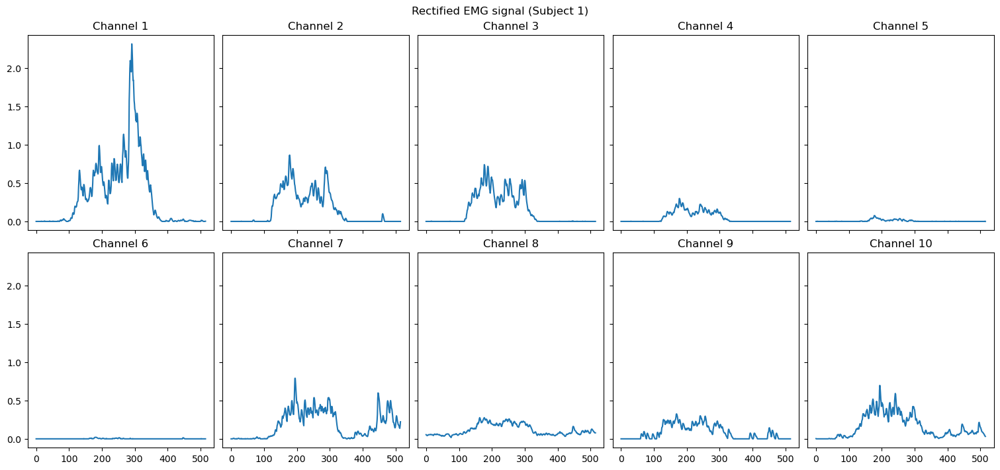

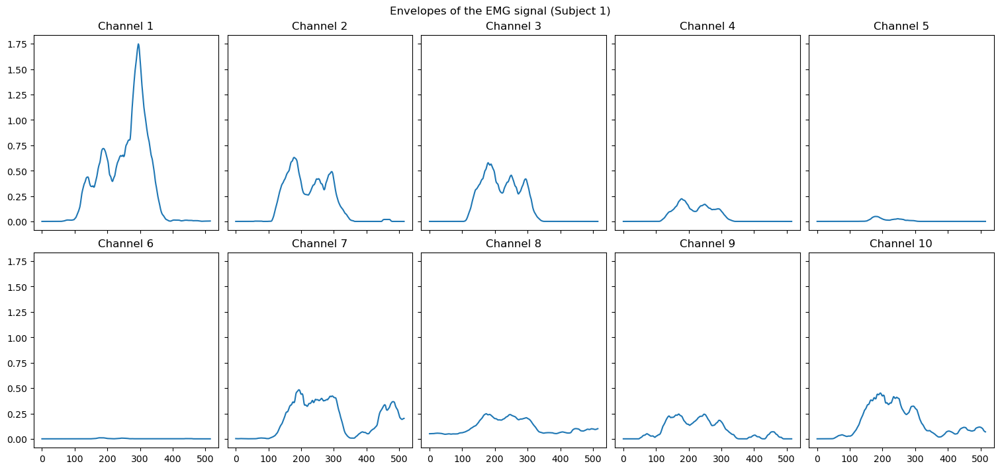

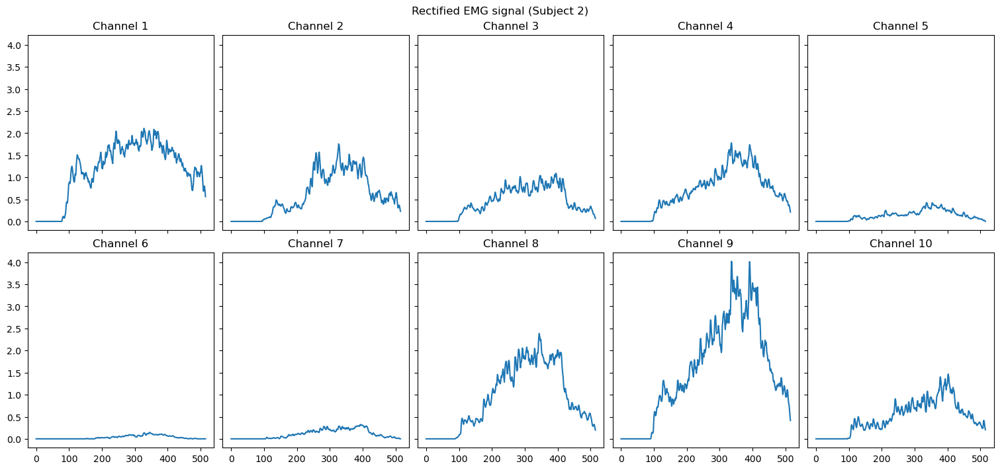

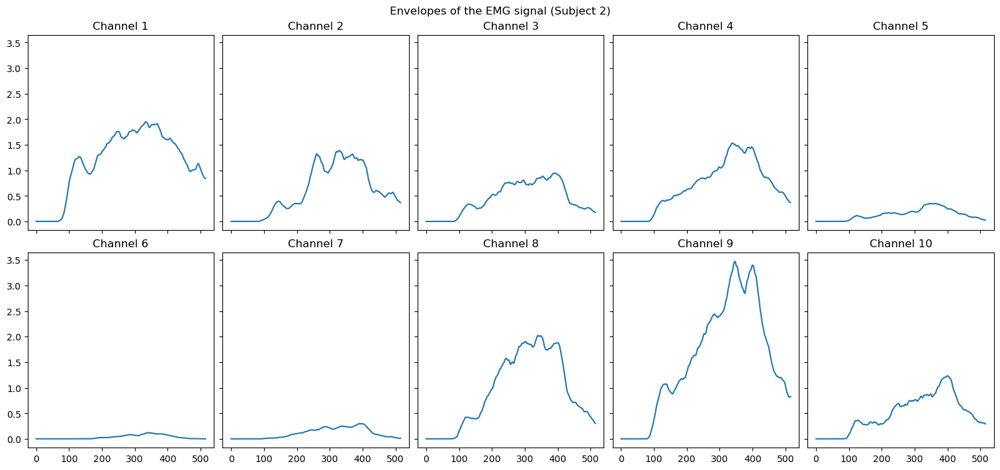

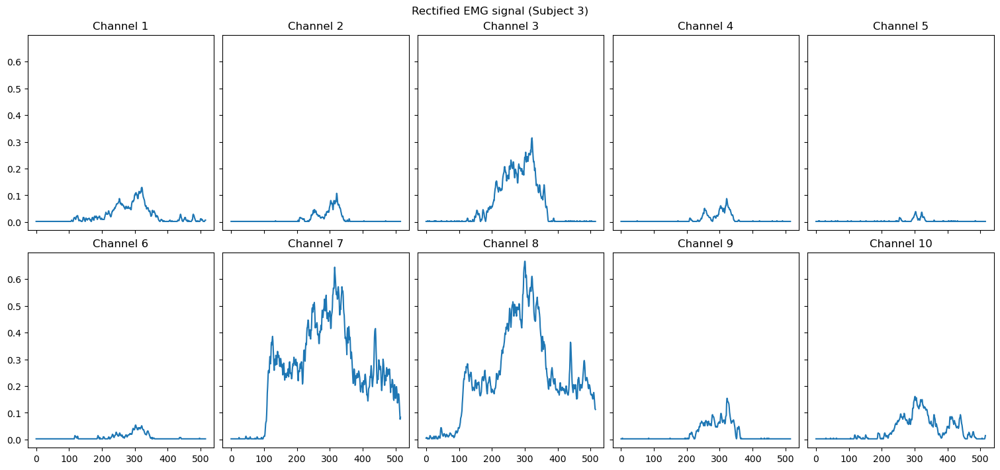

...

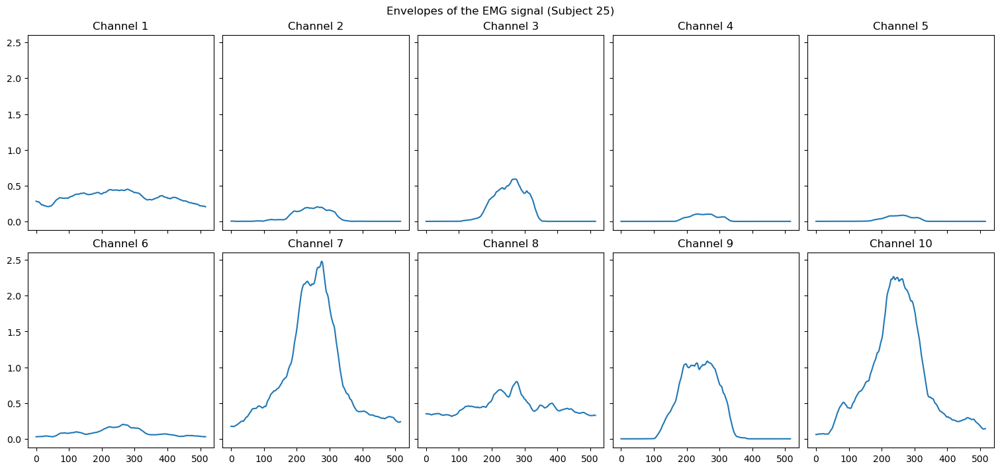

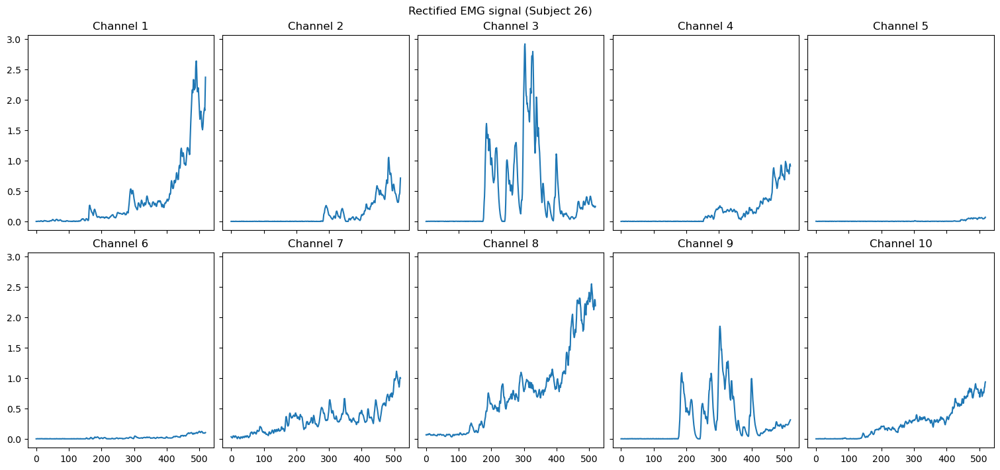

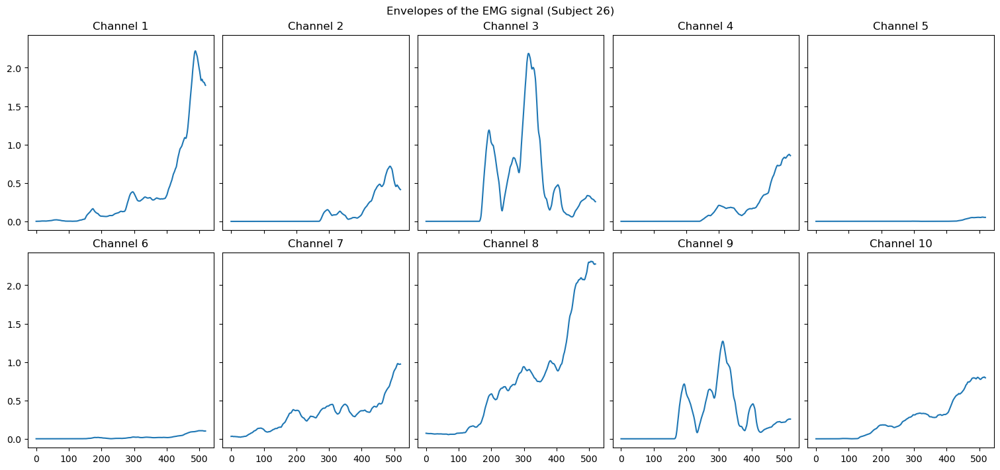

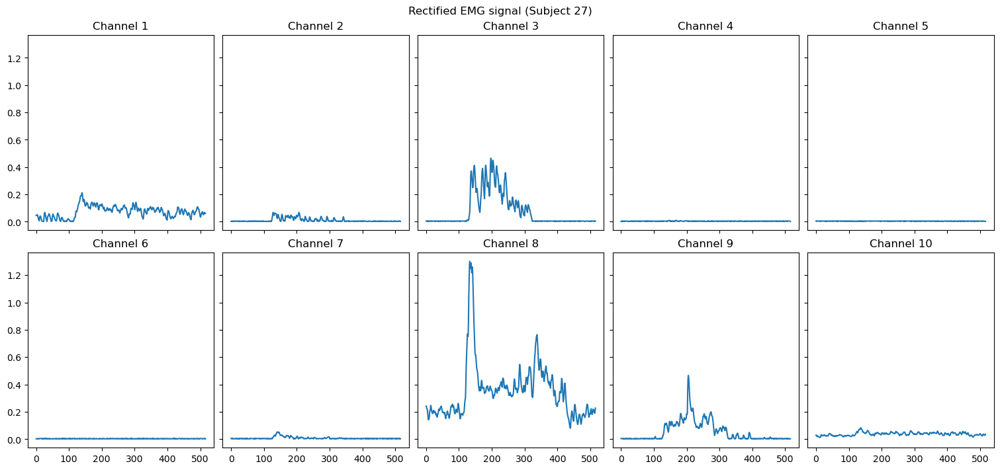

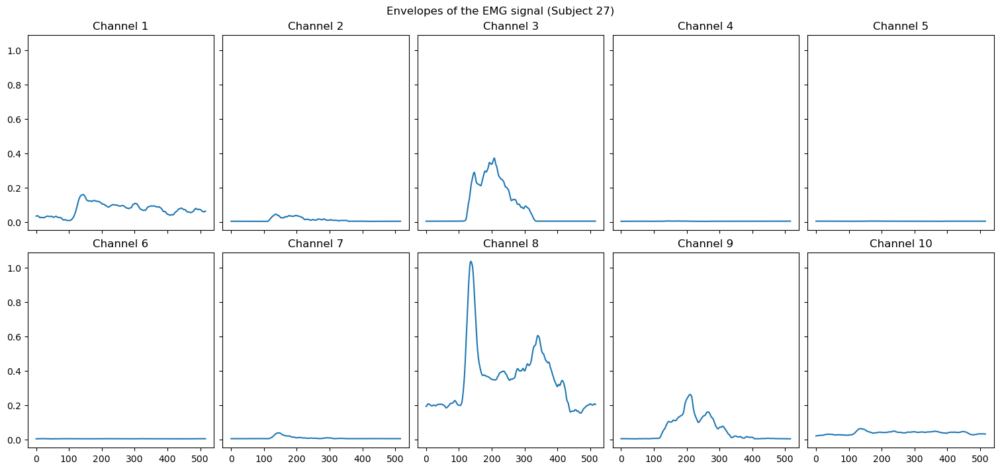

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io import loadmat
from scipy.ndimage import convolve1d

# Number of subjects
n_subjects = 27

# Define moving average window size for envelope extraction
mov_mean_length = 25
mov_mean_weights = np.ones(mov_mean_length) / mov_mean_length

# Loop through all 27 subjects
for subject in range(1, n_subjects + 1):
    # Path to the subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        # Load the data for the current subject
        data = loadmat(data_path)
        stimulus = data['stimulus'].flatten()  # Ensure it's a 1D array
        repetition = data['repetition'].flatten()  # Ensure it's a 1D array
        emg = data['emg']  # Assuming 'emg' is the name of the EMG data in the file

        # Calculate the number of unique stimulus types and repetitions (excluding 0)
        n_stimuli = len(np.unique(stimulus)) - 1  # Exclude 0 (resting condition)
        n_repetitions = len(np.unique(repetition)) - 1  # Exclude 0 (non-repetition)
        
        # Initialize arrays to store the EMG windows and envelopes
        emg_windows = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        emg_envelopes = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        
        # Calculate the number of samples per trial and preprocess the EMG signal
        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Find indices for the current stimulus and repetition combination
                idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1)
                
                # Store the EMG data window for the current trial
                emg_windows[stimuli_idx][repetition_idx] = emg[idx, :]
                # Apply moving average to extract the envelope
                emg_envelopes[stimuli_idx][repetition_idx] = convolve1d(emg_windows[stimuli_idx][repetition_idx], mov_mean_weights, axis=0)
        
        # Plot Rectified EMG signals for the subject
        trial = emg_windows[6][0]  # Example: Subject 6, first stimulus, first repetition
        
        fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True, sharex=True, sharey=True)
        ax = ax.ravel()

        number_of_emg_channels = emg.shape[-1]
        
        # Plot Rectified EMG signals (one for each channel)
        for channel_idx in range(number_of_emg_channels): 
            ax[channel_idx].plot(trial[:, channel_idx])   
            ax[channel_idx].set_title(f"Channel {channel_idx + 1}")
        plt.suptitle(f"Rectified EMG signal (Subject {subject})")

        # Plot Envelopes of the EMG signals for the subject
        fig, ax = plt.subplots(2, 5, figsize=(15, 7), constrained_layout=True, sharex=True, sharey=True)
        ax = ax.ravel()

        # Plot Envelopes of the EMG signal (one for each channel)
        for channel_idx in range(number_of_emg_channels): 
            ax[channel_idx].plot(emg_envelopes[6][0][:, channel_idx])   
            ax[channel_idx].set_title(f"Channel {channel_idx + 1}")
        plt.suptitle(f"Envelopes of the EMG signal (Subject {subject})")

    else:
        print(f"Data file for Subject {subject} not found at {data_path}")


### Average EMG Activation Across Stimuli and Repetitions

In [104]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.io import loadmat
from scipy.ndimage import convolve1d
import os

# Number of subjects
n_subjects = 27

# Define moving average window size for envelope extraction
mov_mean_length = 25
mov_mean_weights = np.ones(mov_mean_length) / mov_mean_length

# Loop through all 27 subjects
for subject in range(1, n_subjects + 1):
    # Path to the subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    if os.path.exists(data_path):
        # Load the data for the current subject
        data = loadmat(data_path)
        stimulus = data['stimulus'].flatten()  # Ensure it's a 1D array
        repetition = data['repetition'].flatten()  # Ensure it's a 1D array
        emg = data['emg']  # Assuming 'emg' is the name of the EMG data in the file

        # Calculate the number of unique stimulus types and repetitions (excluding 0)
        n_stimuli = len(np.unique(stimulus)) - 1  # Exclude 0 (resting condition)
        n_repetitions = len(np.unique(repetition)) - 1  # Exclude 0 (non-repetition)
        
        # Initialize arrays to store the EMG windows and envelopes
        emg_windows = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        emg_envelopes = [[None for _ in range(n_repetitions)] for _ in range(n_stimuli)]
        
        # Calculate the number of samples per trial and preprocess the EMG signal
        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Find indices for the current stimulus and repetition combination
                idx = np.logical_and(stimulus == stimuli_idx + 1, repetition == repetition_idx + 1)
                
                # Store the EMG data window for the current trial
                emg_windows[stimuli_idx][repetition_idx] = emg[idx, :]
                # Apply moving average to extract the envelope
                emg_envelopes[stimuli_idx][repetition_idx] = convolve1d(emg_windows[stimuli_idx][repetition_idx], mov_mean_weights, axis=0)
        
        # Now calculate the average activation across time for each channel, stimulus, and repetition
        n_channels = emg.shape[1]  # Number of EMG channels
        emg_average_activations = np.zeros((n_channels, n_stimuli, n_repetitions))

        for stimuli_idx in range(n_stimuli):
            for repetition_idx in range(n_repetitions):
                # Mean across time for each channel
                emg_average_activations[:, stimuli_idx, repetition_idx] = np.mean(emg_envelopes[stimuli_idx][repetition_idx], axis=0)

        # Plot the heatmaps for each stimulus
        fig, ax = plt.subplots(4, 3, figsize=(15, 12), constrained_layout=True, sharex=True, sharey=True)
        ax = ax.ravel()

        for stimuli_idx in range(n_stimuli):
            sns.heatmap(np.squeeze(emg_average_activations[:, stimuli_idx, :]), ax=ax[stimuli_idx],
                        xticklabels=False, yticklabels=False, cbar=True)
            ax[stimuli_idx].title.set_text("Stimulus " + str(stimuli_idx + 1))
            ax[stimuli_idx].set_xlabel("Repetition")
            ax[stimuli_idx].set_ylabel("EMG channel")
        
        plt.suptitle(f"Average EMG Activation for Subject {subject}", fontsize=16)
        plt.show()  # Display the heatmaps for the current subject
    
    else:
        print(f"Data file for Subject {subject} not found at {data_path}")


Data file for Subject 1 not found at data/s1/S1_A1_E1.mat
Data file for Subject 2 not found at data/s2/S2_A1_E1.mat
Data file for Subject 3 not found at data/s3/S3_A1_E1.mat
Data file for Subject 4 not found at data/s4/S4_A1_E1.mat
Data file for Subject 5 not found at data/s5/S5_A1_E1.mat
Data file for Subject 6 not found at data/s6/S6_A1_E1.mat
Data file for Subject 7 not found at data/s7/S7_A1_E1.mat
Data file for Subject 8 not found at data/s8/S8_A1_E1.mat
Data file for Subject 9 not found at data/s9/S9_A1_E1.mat
Data file for Subject 10 not found at data/s10/S10_A1_E1.mat
Data file for Subject 11 not found at data/s11/S11_A1_E1.mat
Data file for Subject 12 not found at data/s12/S12_A1_E1.mat
Data file for Subject 13 not found at data/s13/S13_A1_E1.mat
Data file for Subject 14 not found at data/s14/S14_A1_E1.mat
Data file for Subject 15 not found at data/s15/S15_A1_E1.mat
Data file for Subject 16 not found at data/s16/S16_A1_E1.mat
Data file for Subject 17 not found at data/s17/S17_

### Extraction of Features

In [11]:
import os
import numpy as np
from scipy.io import loadmat

# Feature functions (same as before)
mav = lambda x: np.mean(np.abs(x), axis=0)
std = lambda x: np.std(x, axis=0)
maxav = lambda x: np.max(np.abs(x), axis=0)
rms = lambda x: np.sqrt(np.mean(x**2, axis=0))
wl = lambda x: np.sum(np.abs(np.diff(x, axis=0)), axis=0)
ssc = lambda x: np.sum((np.diff(x, axis=0)[:-1, :] * np.diff(x, axis=0)[1:, :]) < 0, axis=0)

# Define the feature extraction function for one subject
def build_dataset_from_ninapro(emg, stimulus, repetition, features=None):
    # Calculate the number of unique stimuli and repetitions, subtracting 1 to exclude the resting condition
    n_stimuli = np.unique(stimulus).size - 1  # excluding resting condition (0 or 1)
    n_repetitions = np.unique(repetition).size - 1
    # Total number of samples is the product of stimuli and repetitions
    n_samples = n_stimuli * n_repetitions
    
    # Number of channels in the EMG data
    n_channels = emg.shape[1]
    # Calculate the total number of features by summing the number of channels for each feature
    n_features = sum(n_channels for feature in features)
    
    # Initialize the dataset and labels arrays with zeros
    dataset = np.zeros((n_samples, n_features))
    labels = np.zeros(n_samples)
    current_sample_index = 0
    
    # Loop over each stimulus and repetition to extract features
    for i in range(n_stimuli):
        for j in range(n_repetitions):
            # Assign the label for the current sample (the stimulus label is i + 1)
            labels[current_sample_index] = i + 1  # Label should range from 1 to 12 (assuming 12 stimuli)
            current_sample_index += 1
            current_feature_index = 0
            # Select the time steps corresponding to the current stimulus and repetition
            selected_tsteps = np.logical_and(stimulus == i + 1, repetition == j + 1).squeeze()
            
            # Loop over each feature function provided
            for feature in features:
                # Determine the indices in the dataset where the current feature will be stored
                selected_features = np.arange(current_feature_index, current_feature_index + n_channels)
                # Apply the feature function to the selected EMG data and store the result
                dataset[current_sample_index-1, selected_features] = feature(emg[selected_tsteps, :])
                # Update the feature index for the next feature
                current_feature_index += n_channels

    return dataset, labels

# Function to extract features for all subjects
def build_dataset_from_ninapro_all_subjects(subject_data_list, features=None):
    all_datasets = []
    all_labels = []
    
    # Loop over all subjects' data
    for subject_index, (emg, stimulus, repetition) in enumerate(subject_data_list):
        # Extract features for the current subject using the provided feature functions
        dataset, labels = build_dataset_from_ninapro(
            emg=emg,
            stimulus=stimulus,
            repetition=repetition,
            features=features
        )
        
        # Append the dataset and labels for this subject to the overall lists
        all_datasets.append(dataset)
        all_labels.append(labels)
    
    # Concatenate all datasets and labels from all subjects
    final_dataset = np.vstack(all_datasets)
    final_labels = np.concatenate(all_labels)
    
    return final_dataset, final_labels


# Initialize a list to store data for all subjects
subject_data_list = []

# Loop over subjects 1 to 27 and load the data for each subject
for subject in range(1, 28):
    # Construct the path for each subject's data file
    data_path = f"data/s{subject}/S{subject}_A1_E1.mat"
    
    # Check if the file exists before trying to load it
    if os.path.exists(data_path):
        data = loadmat(data_path)
        
        # Extract EMG data
        emg = data["emg"]
        stimulus = data["stimulus"].squeeze()  # Assuming stimulus is stored under the key 'stimulus'
        repetition = data["repetition"].squeeze()  # Assuming repetition is under the key 'repetition'
        
        # Add the subject data to the list
        subject_data_list.append((emg, stimulus, repetition))
    else:
        print(f"File for Subject {subject} does not exist: {data_path}")

# After this loop, subject_data_list contains the (emg, stimulus, repetition) tuples for each subject

# Now we can call the function to extract features for all subjects
final_dataset, final_labels = build_dataset_from_ninapro_all_subjects(
    subject_data_list,
    features=[mav, std, maxav, rms, wl, ssc]  # List of features to extract
)

print(f"Final dataset shape: {final_dataset.shape}")
print(f"Final labels shape: {final_labels.shape}")
print(f"Unique labels: {np.unique(final_labels)}")


Final dataset shape: (3240, 60)
Final labels shape: (3240,)
Unique labels: [ 1.  2.  3.  4.  5.  6.  7.  8.  9. 10. 11. 12.]


### Visualization of Features across the 27 Subjects

1) Visualize the Variance of Features Across Repetitions (Heatmap)

In [12]:
import os
from scipy.io import loadmat

# Path to the data folder
data_base_path = "data"

def load_subject(subj_id):
    """
    Loads EMG, stimulus, and repetition for a given subject.
    Returns: emg, stimulus, repetition
    """
    data_path = os.path.join(data_base_path, f"s{subj_id}", f"S{subj_id}_A1_E1.mat")
    
    if not os.path.exists(data_path):
        raise FileNotFoundError(f"File does not exist: {data_path}")
    
    data = loadmat(data_path)
    
    # Extract relevant variables
    emg = data["emg"]
    stimulus = data["stimulus"]
    repetition = data["repetition"]
    
    return emg, stimulus, repetition


In [13]:
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

# Define your features
features = {
    "MAV": mav,
    "STD": std,
    "MaxAV": maxav,
    "RMS": rms,
    "WL": wl,
    "SSC": ssc
}

# List of subjects (1 to 27)
subjects = range(1, 28)

# Dictionaries to store results per subject
all_variance_maps = {}
all_mean_maps = {}
all_correlation_matrices = {}

for subj in subjects:
    #print(f"Processing Subject {subj}...")
    
    # ----- Load subject data -----
    emg, stimulus, repetition = load_subject(subj)
    
    # ----- Prepare channels (remove ch9) -----
    channels_to_use = [i for i in range(emg.shape[1]) if i != 8]
    n_channels = len(channels_to_use)
    emg_used = emg[:, channels_to_use]

    # ----- Extract valid stimuli & repetitions -----
    stimuli = np.unique(stimulus)
    stimuli = stimuli[stimuli != 0]      
    reps = np.unique(repetition)
    reps = reps[reps != 0]

    # ----- Compute variance maps -----
    variance_maps = {}
    for fname, func in features.items():
        var_matrix = np.zeros((n_channels, len(stimuli)))
        for s_i, stim_val in enumerate(stimuli):
            feature_values_per_rep = np.zeros((len(reps), n_channels))
            for r_i, rep_val in enumerate(reps):
                mask = np.logical_and(stimulus == stim_val, repetition == rep_val).squeeze()
                segment = emg_used[mask, :]
                if segment.size > 0:
                    feature_values_per_rep[r_i, :] = func(segment)
                else:
                    feature_values_per_rep[r_i, :] = np.nan
            var_matrix[:, s_i] = np.nanvar(feature_values_per_rep, axis=0)
        variance_maps[fname] = var_matrix
    all_variance_maps[subj] = variance_maps

    # ----- Compute mean maps -----
    mean_maps = {}
    for fname, func in features.items():
        mean_matrix = np.zeros((n_channels, len(stimuli)))
        for s_i, stim_val in enumerate(stimuli):
            rep_values = []
            for rep_val in reps:
                mask = np.logical_and(stimulus == stim_val, repetition == rep_val).squeeze()
                segment = emg_used[mask, :]
                if segment.size > 0:
                    rep_values.append(func(segment))
            if rep_values:
                rep_values = np.vstack(rep_values)  # (reps × channels)
                mean_matrix[:, s_i] = np.nanmean(rep_values, axis=0)
            else:
                mean_matrix[:, s_i] = np.nan
        mean_maps[fname] = mean_matrix
    all_mean_maps[subj] = mean_maps

    # ----- Compute stimulus × stimulus correlation matrices -----
    correlation_matrices = {}
    for fname, mean_matrix in mean_maps.items():
        stim_vectors = mean_matrix.T   # (stimuli × channels)
        corr = np.corrcoef(stim_vectors)  # (stimuli × stimuli)
        correlation_matrices[fname] = corr
    all_correlation_matrices[subj] = correlation_matrices

### Step 1: Mean Feature Maps (Across Repetitions) 

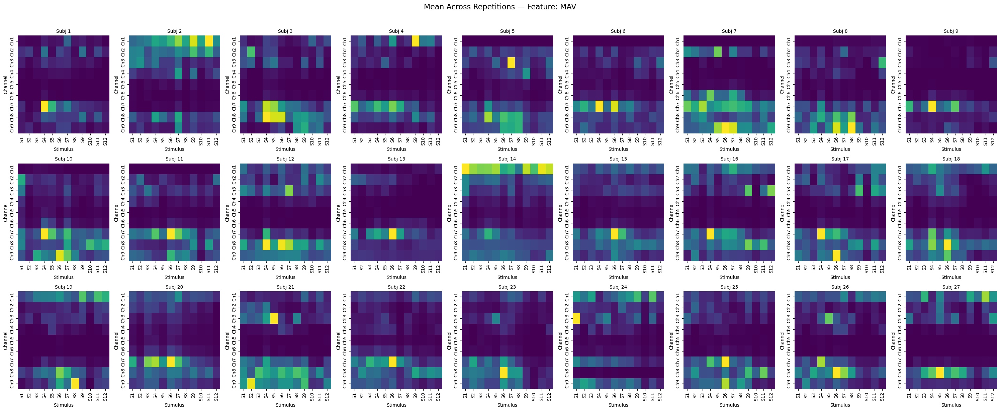

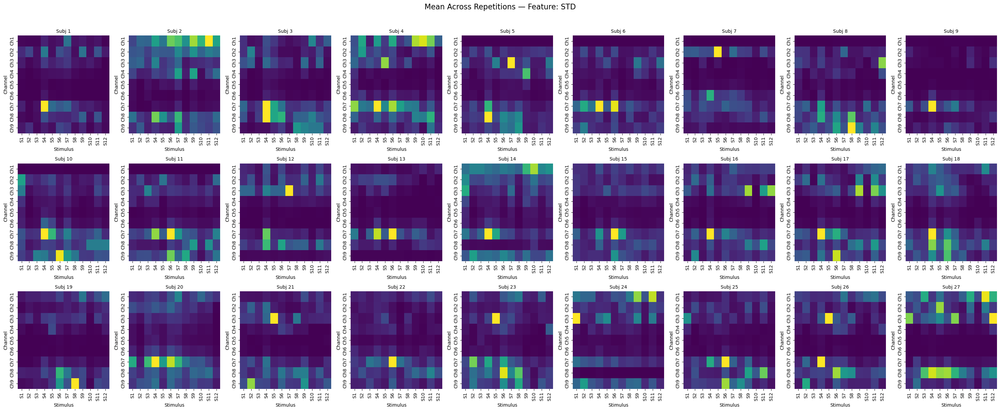

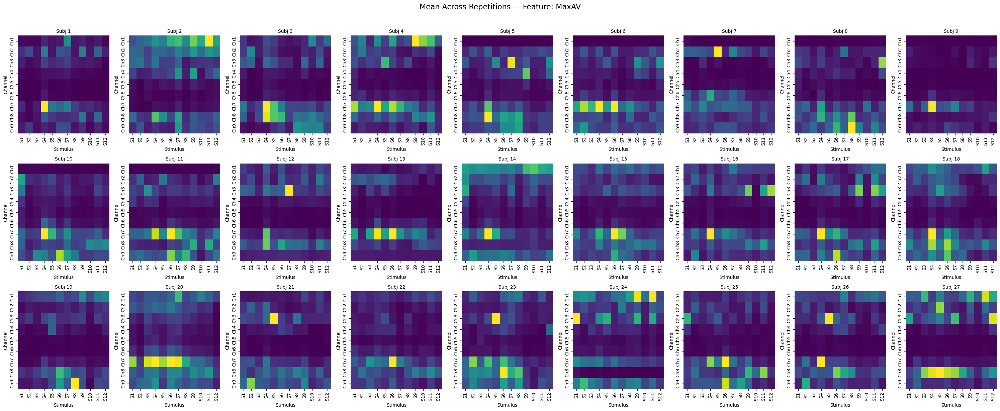

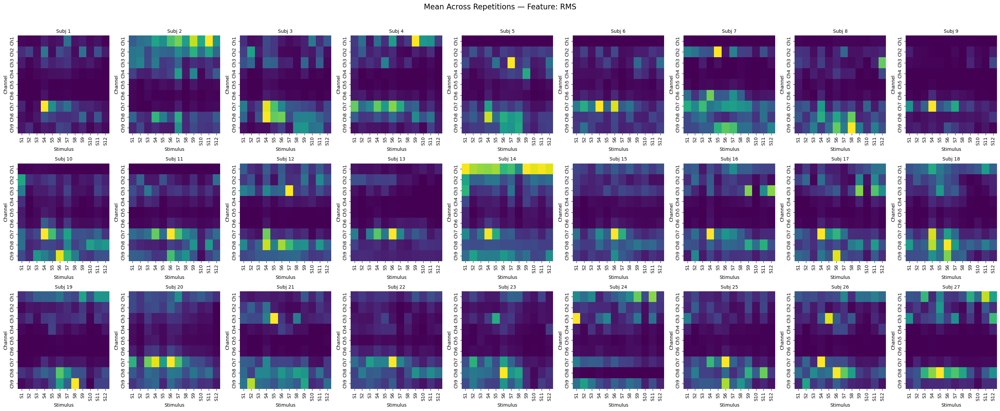

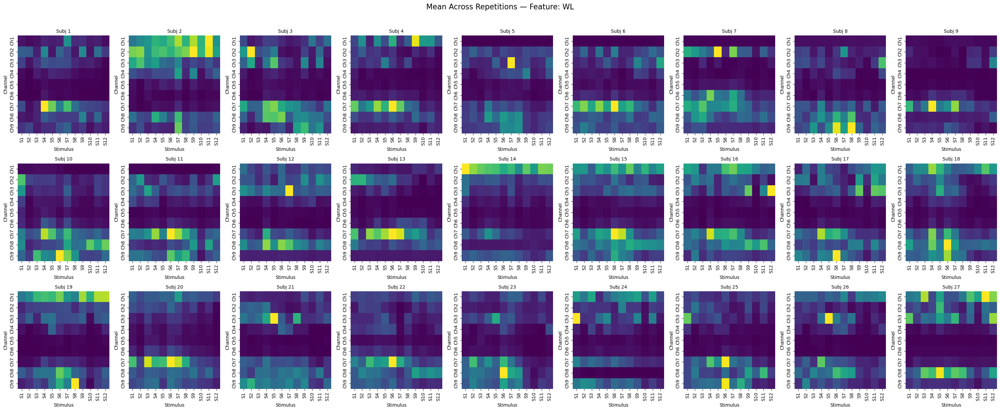

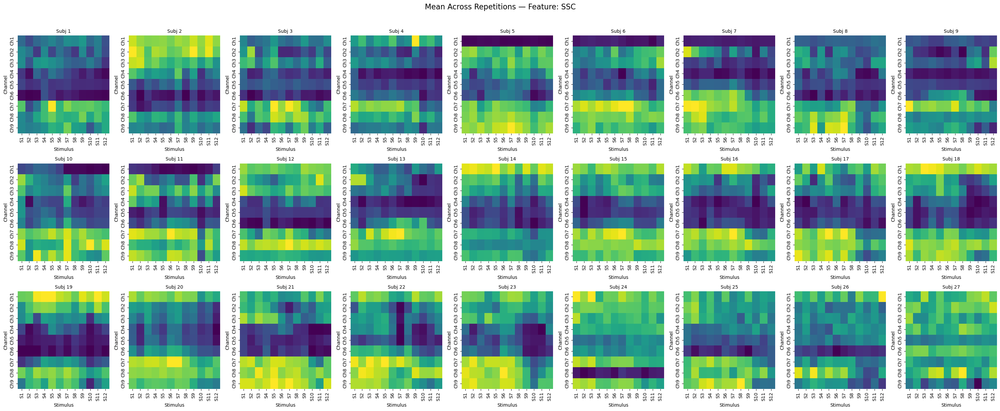

In [14]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Loop over features
for feature_name in features.keys():
    fig, axes = plt.subplots(3, 9, figsize=(30, 12))
    axes = axes.flatten()

    for i, subj in enumerate(range(1, 28)):
        # Get mean maps for this subject and feature
        mean_matrix = all_mean_maps[subj][feature_name]

        sns.heatmap(
            mean_matrix,
            ax=axes[i],
            cmap="viridis",
            xticklabels=[f"S{int(s)}" for s in stimuli],
            yticklabels=[f"Ch{c+1}" for c in range(n_channels)],
            cbar=False  # hide individual colorbars for clarity
        )
        axes[i].set_title(f"Subj {subj}", fontsize=10)
        axes[i].set_xlabel("Stimulus")
        axes[i].set_ylabel("Channel")

    # Add a big figure title for the feature
    fig.suptitle(f"Mean Across Repetitions — Feature: {feature_name}", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


### Step 2: Variance of Features Across Repetitions

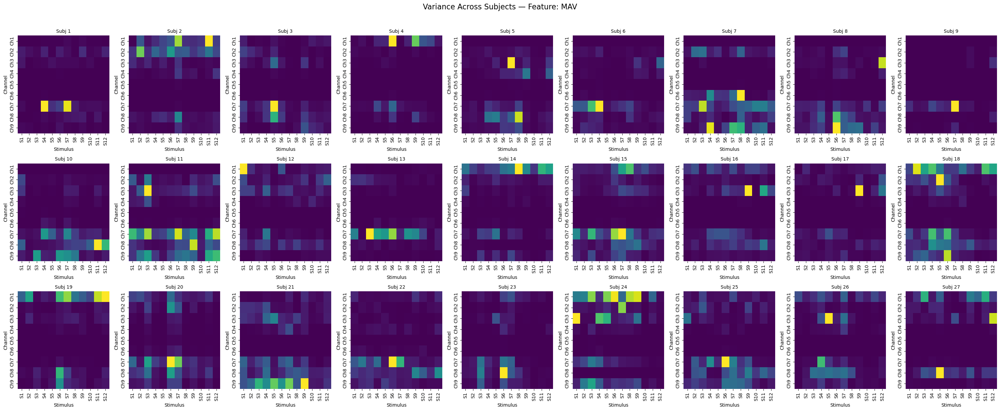

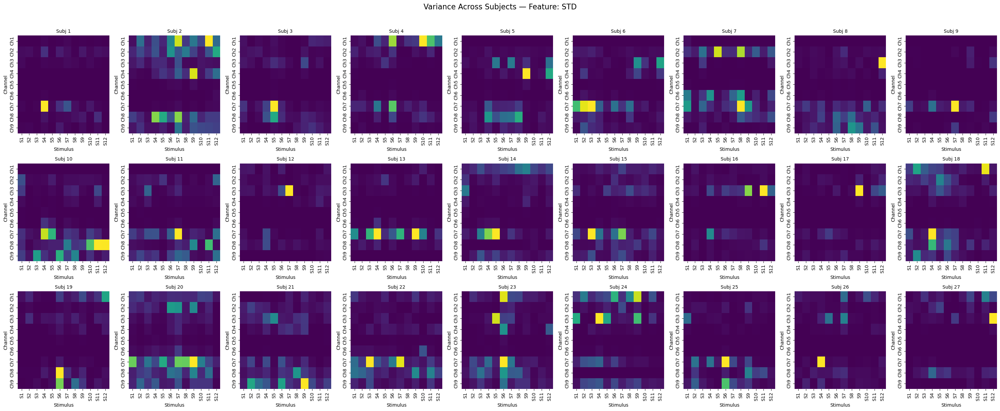

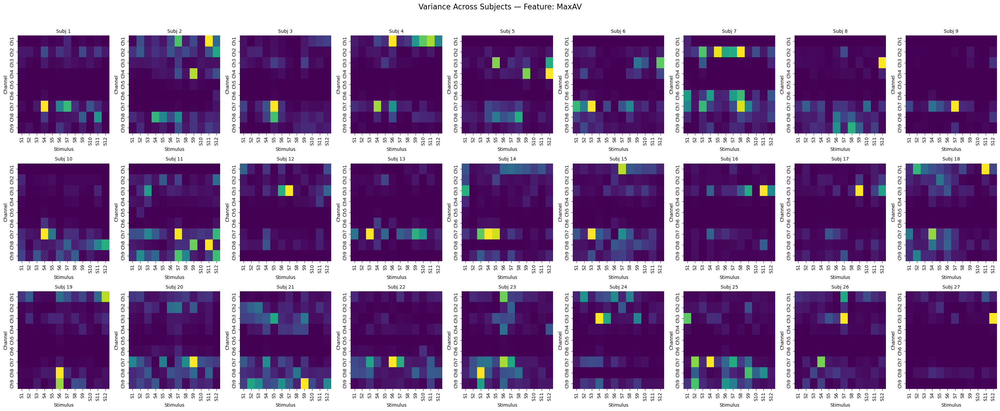

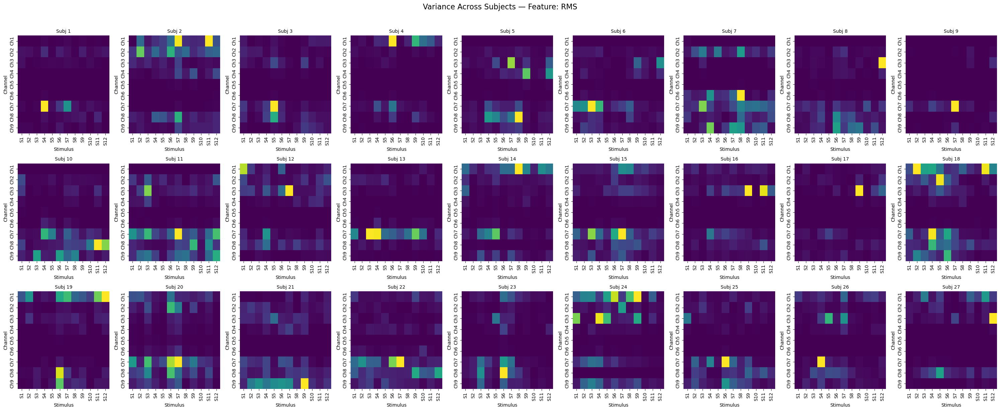

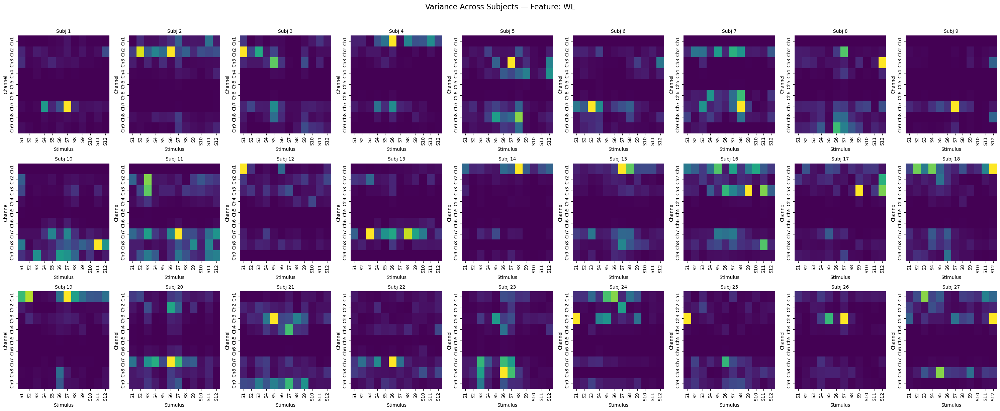

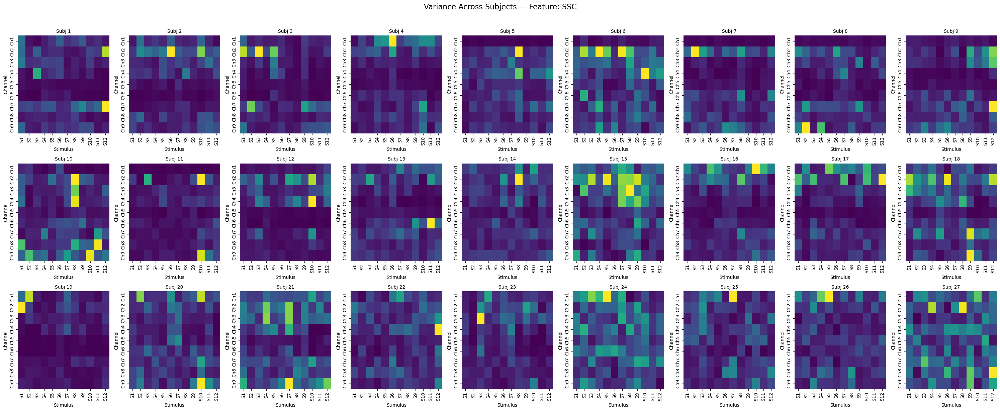

In [15]:
import matplotlib.pyplot as plt
import seaborn as sns

# Loop over features
for feature_name in features.keys():
    # Prepare figure: 3 rows × 9 columns = 27 subjects
    fig, axes = plt.subplots(3, 9, figsize=(30, 12))
    axes = axes.flatten()

    for i, subj in enumerate(range(1, 28)):
        mat = all_variance_maps[subj][feature_name]  # variance matrix for this feature
        sns.heatmap(
            mat,
            ax=axes[i],
            cmap="viridis",
            xticklabels=[f"S{int(s)}" for s in stimuli],
            yticklabels=[f"Ch{c+1}" for c in range(n_channels)],
            cbar=False  # hide individual colorbars for clarity
        )
        axes[i].set_title(f"Subj {subj}", fontsize=10)
        axes[i].set_xlabel("Stimulus")
        axes[i].set_ylabel("Channel")

    # Add a big title for the whole figure
    fig.suptitle(f"Variance Across Subjects — Feature: {feature_name}", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


### Step 3: Coefficient of Variation (CV)

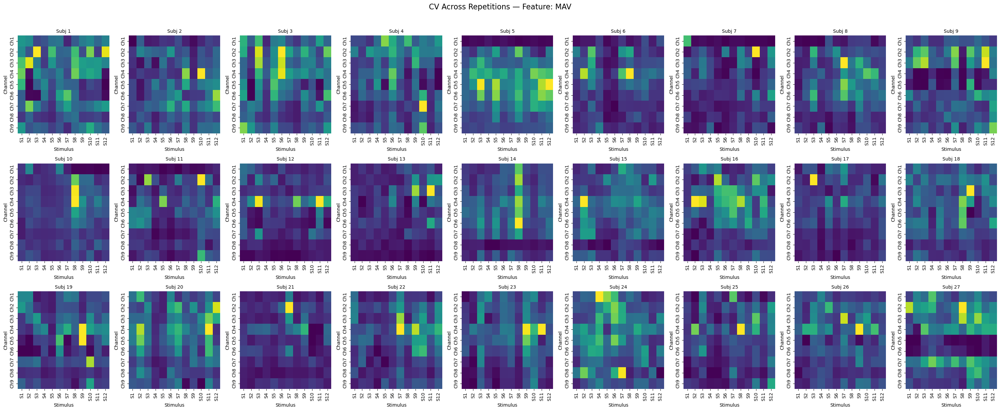

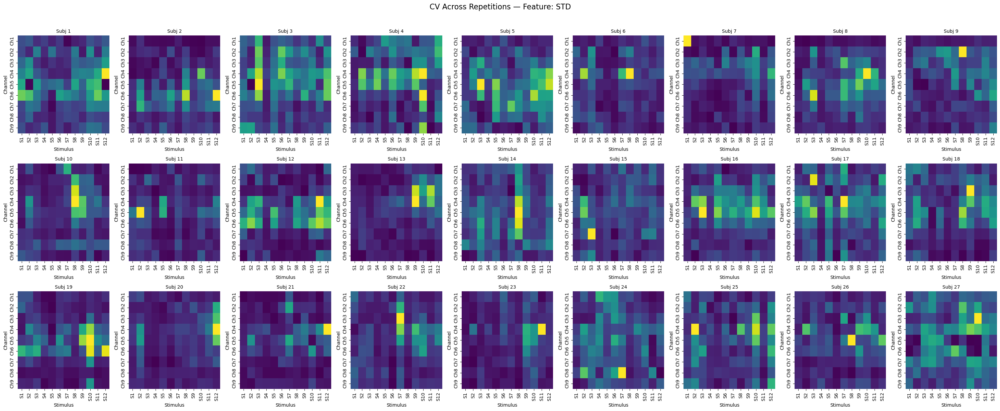

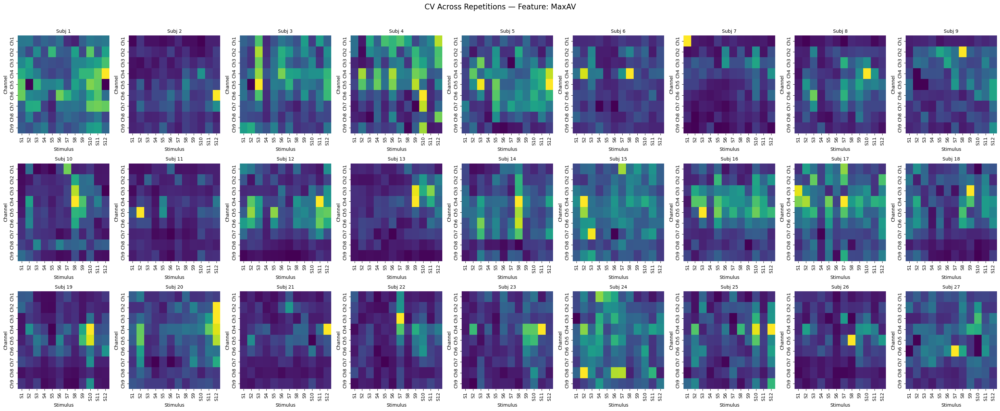

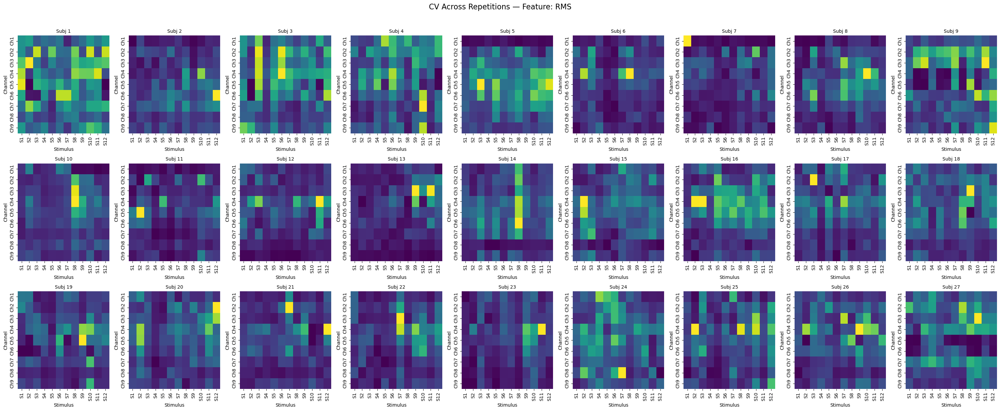

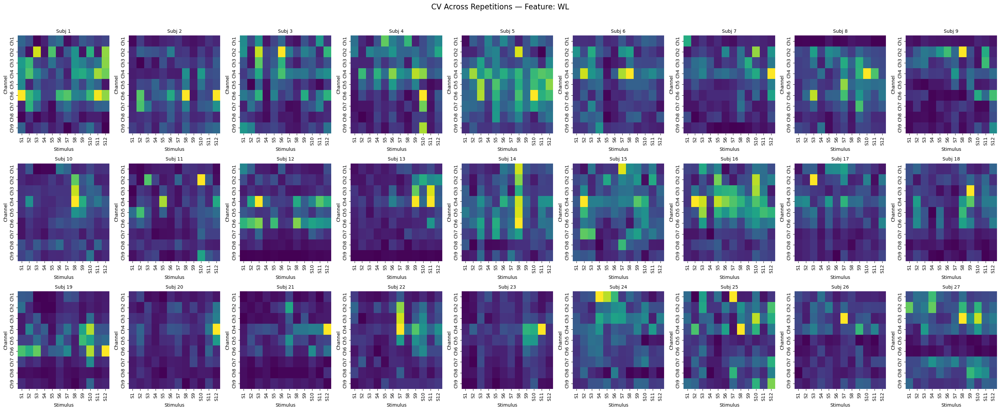

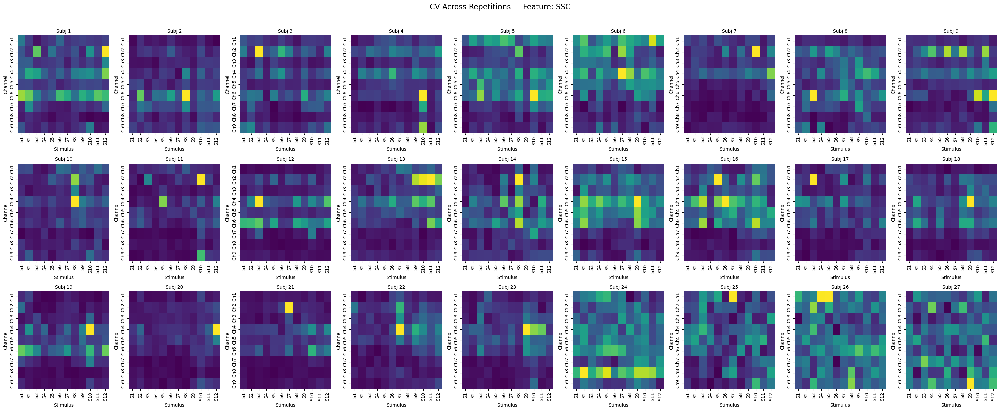

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Loop over features
for feature_name in features.keys():
    fig, axes = plt.subplots(3, 9, figsize=(30, 12))
    axes = axes.flatten()

    for i, subj in enumerate(range(1, 28)):
        # Get EMG, stimulus, repetition for this subject
        emg, stimulus, repetition = load_subject(subj)  # or use your existing loader
        channels_to_use = [c for c in range(emg.shape[1]) if c != 8]  # remove ch9
        n_channels = len(channels_to_use)
        emg_used = emg[:, channels_to_use]

        reps = np.unique(repetition)
        reps = reps[reps != 0]
        stimuli_subj = np.unique(stimulus)
        stimuli_subj = stimuli_subj[stimuli_subj != 0]

        # Collect feature values per repetition
        feature_func = features[feature_name]
        cv_matrix = np.zeros((n_channels, len(stimuli_subj)))

        for s_i, stim_val in enumerate(stimuli_subj):
            feature_values_per_rep = np.full((len(reps), n_channels), np.nan)

            for r_i, rep_val in enumerate(reps):
                mask = np.logical_and(stimulus == stim_val, repetition == rep_val).squeeze()
                segment = emg_used[mask, :]
                if segment.size > 0:
                    feature_values_per_rep[r_i, :] = feature_func(segment)

            # Compute CV: std / mean across repetitions
            mean_vals = np.nanmean(feature_values_per_rep, axis=0)
            std_vals = np.nanstd(feature_values_per_rep, axis=0)
            with np.errstate(divide='ignore', invalid='ignore'):
                cv = std_vals / mean_vals
                cv[~np.isfinite(cv)] = np.nan
            cv_matrix[:, s_i] = cv

        # Plot CV heatmap for this subject
        sns.heatmap(
            cv_matrix,
            ax=axes[i],
            cmap="viridis",
            xticklabels=[f"S{int(s)}" for s in stimuli_subj],
            yticklabels=[f"Ch{c+1}" for c in range(n_channels)],
            cbar=False
        )
        axes[i].set_title(f"Subj {subj}", fontsize=10)
        axes[i].set_xlabel("Stimulus")
        axes[i].set_ylabel("Channel")

    # Big title for the feature
    fig.suptitle(f"CV Across Repetitions — Feature: {feature_name}", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


### Step 4: Stimulus Correlation Matrices

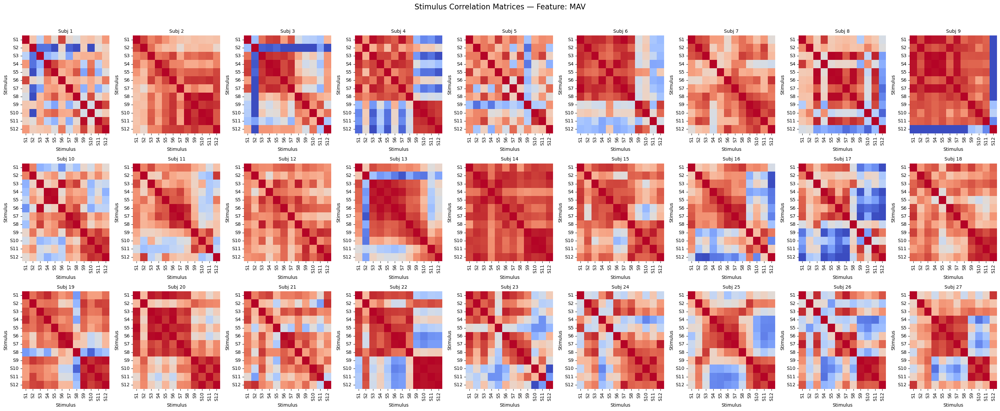

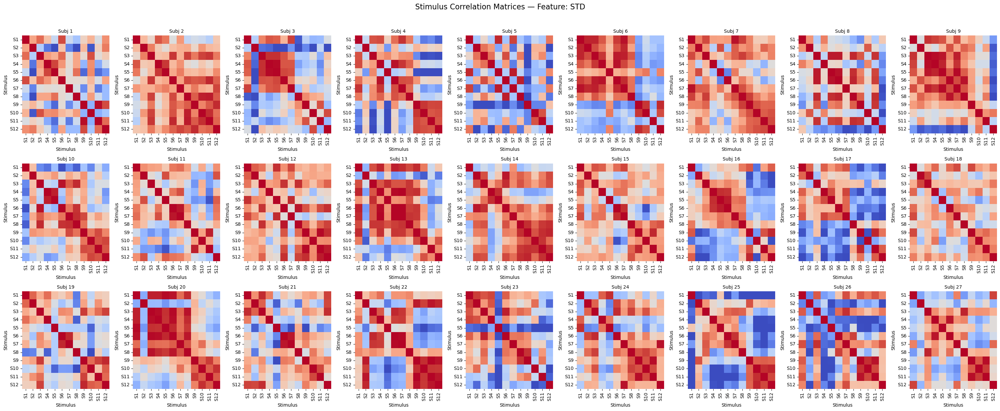

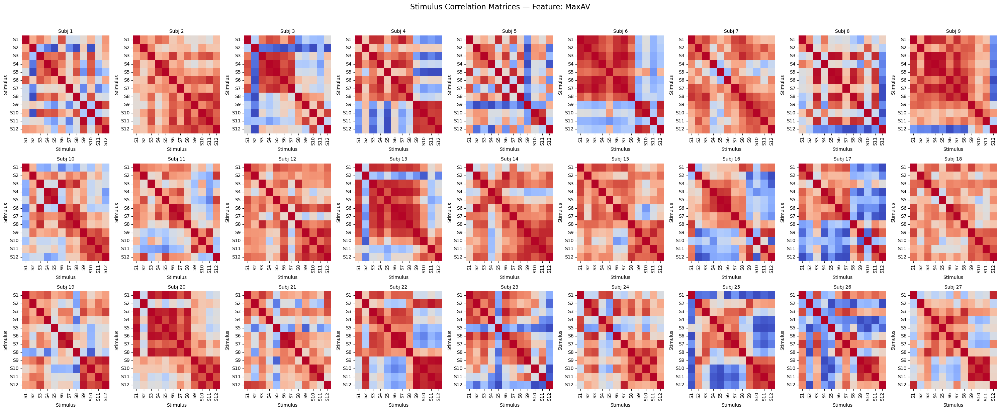

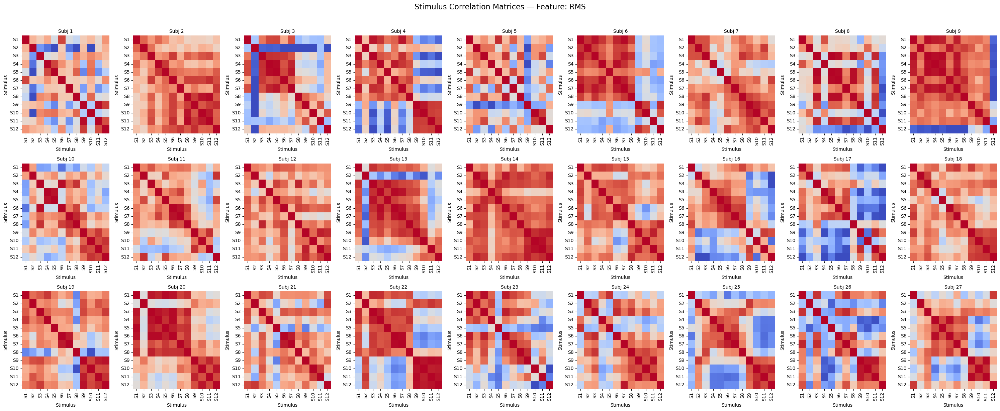

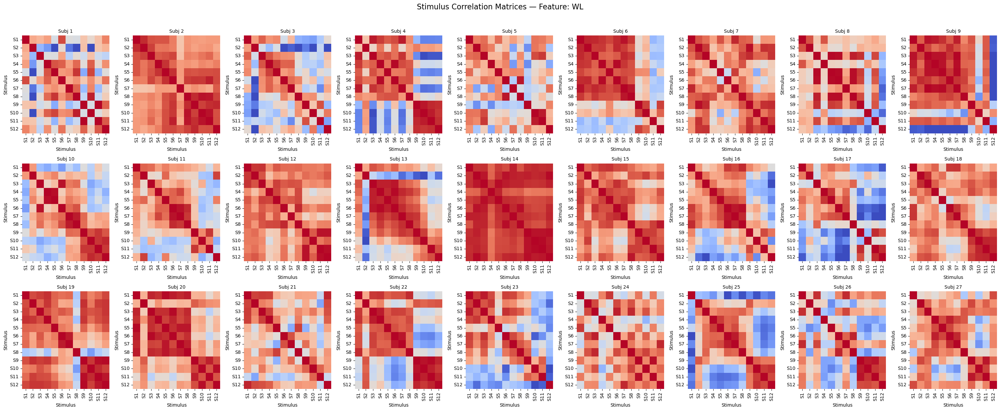

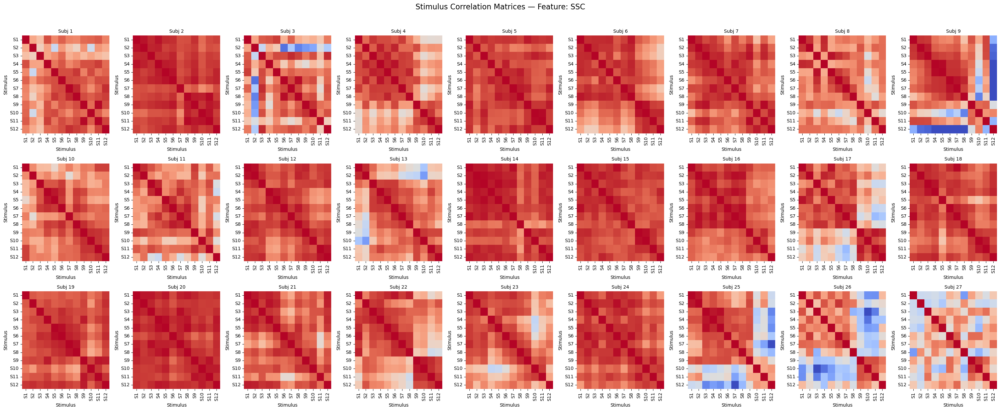

In [17]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# Loop over features
for feature_name in features.keys():
    fig, axes = plt.subplots(3, 9, figsize=(30, 12))
    axes = axes.flatten()

    for i, subj in enumerate(range(1, 28)):
        # Get the mean map for this subject and feature
        mean_matrix = all_mean_maps[subj][feature_name]  # shape: channels × stimuli

        # Compute stimulus × stimulus correlation
        stim_vectors = mean_matrix.T   # shape: stimuli × channels
        corr_matrix = np.corrcoef(stim_vectors)  # stimuli × stimuli

        # Plot
        sns.heatmap(
            corr_matrix,
            ax=axes[i],
            cmap="coolwarm",
            vmin=0, vmax=1,
            xticklabels=[f"S{int(s)}" for s in stimuli],
            yticklabels=[f"S{int(s)}" for s in stimuli],
            cbar=False
        )
        axes[i].set_title(f"Subj {subj}", fontsize=10)
        axes[i].set_xlabel("Stimulus")
        axes[i].set_ylabel("Stimulus")

    # Big figure title for this feature
    fig.suptitle(f"Stimulus Correlation Matrices — Feature: {feature_name}", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


### Step 5: Stimulus Distance Matrices

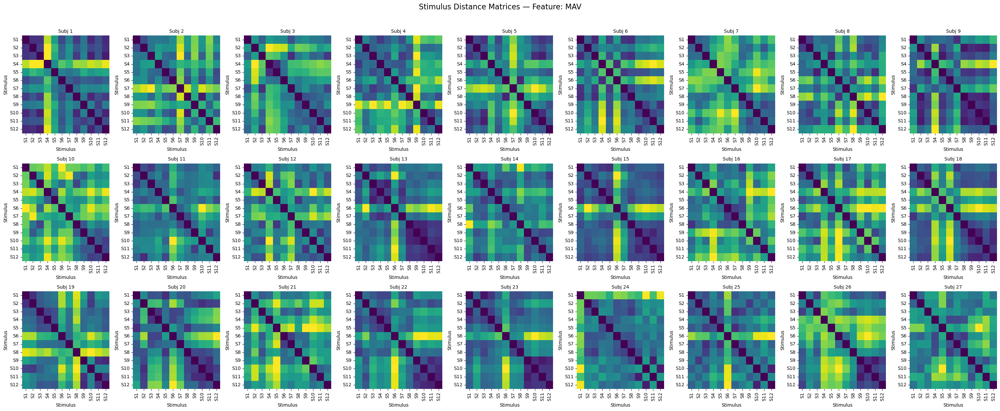

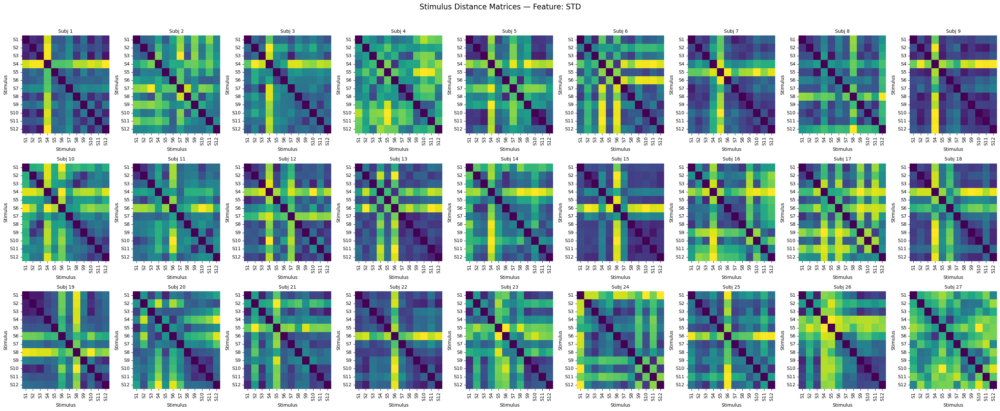

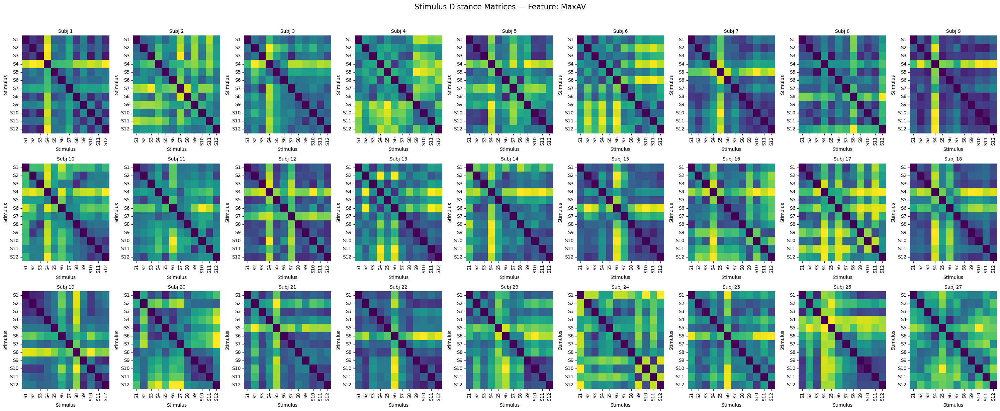

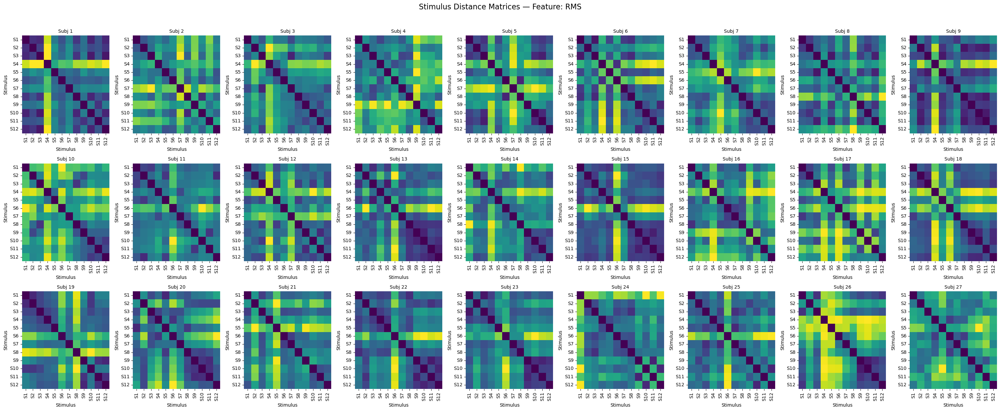

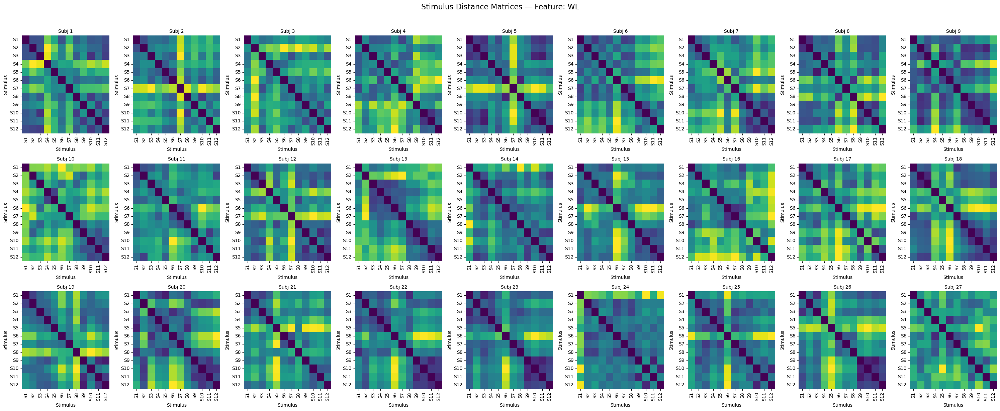

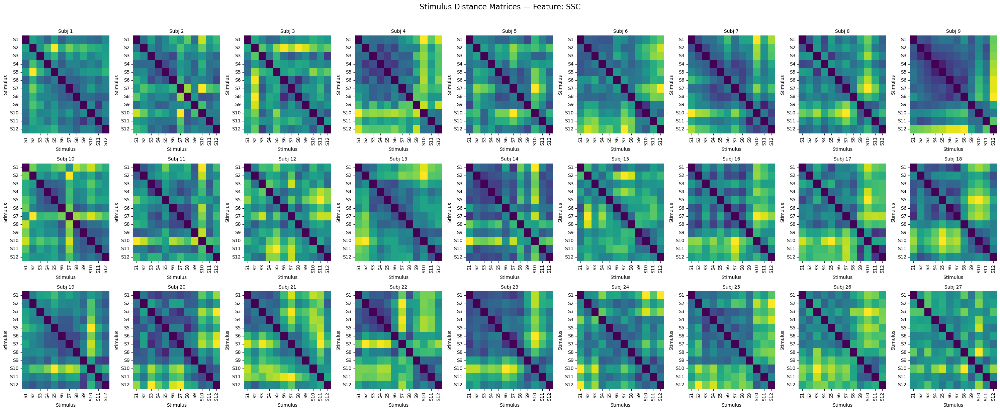

In [18]:
distance_matrices = {}
for feature_name in features.keys():
    fig, axes = plt.subplots(3, 9, figsize=(30, 12))
    axes = axes.flatten()

    for i, subj in enumerate(range(1, 28)):
        mean_matrix = all_mean_maps[subj][feature_name]
        stim_vectors = mean_matrix.T
        dist_matrix = cdist(stim_vectors, stim_vectors, metric='euclidean')
        
        sns.heatmap(
            dist_matrix,
            ax=axes[i],
            cmap="viridis",
            xticklabels=[f"S{int(s)}" for s in stimuli],
            yticklabels=[f"S{int(s)}" for s in stimuli],
            cbar=False
        )
        axes[i].set_title(f"Subj {subj}", fontsize=10)
        axes[i].set_xlabel("Stimulus")
        axes[i].set_ylabel("Stimulus")

    fig.suptitle(f"Stimulus Distance Matrices — Feature: {feature_name}", fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()


### Classification : Trained on 26 Subjects, Tested on 1 Subject 
### &
### Leave-One-Subject-Out (LOSO) Cross-Validation : Rotating Test Subject for Model Evaluation 

Subject  1 | Cross-subject Accuracy: 0.383 | F1-score: 0.329
Subject  1 | Within-subject Accuracy: 0.833 | F1-score: 0.789
Subject  2 | Cross-subject Accuracy: 0.133 | F1-score: 0.115
Subject  2 | Within-subject Accuracy: 0.908 | F1-score: 0.879
Subject  3 | Cross-subject Accuracy: 0.383 | F1-score: 0.303
Subject  3 | Within-subject Accuracy: 0.817 | F1-score: 0.772
Subject  4 | Cross-subject Accuracy: 0.525 | F1-score: 0.465
Subject  4 | Within-subject Accuracy: 0.858 | F1-score: 0.821
Subject  5 | Cross-subject Accuracy: 0.375 | F1-score: 0.331
Subject  5 | Within-subject Accuracy: 0.867 | F1-score: 0.825
Subject  6 | Cross-subject Accuracy: 0.358 | F1-score: 0.347
Subject  6 | Within-subject Accuracy: 0.917 | F1-score: 0.890
Subject  7 | Cross-subject Accuracy: 0.183 | F1-score: 0.124
Subject  7 | Within-subject Accuracy: 0.867 | F1-score: 0.833
Subject  8 | Cross-subject Accuracy: 0.358 | F1-score: 0.361
Subject  8 | Within-subject Accuracy: 0.900 | F1-score: 0.869
Subject  9 | Cro

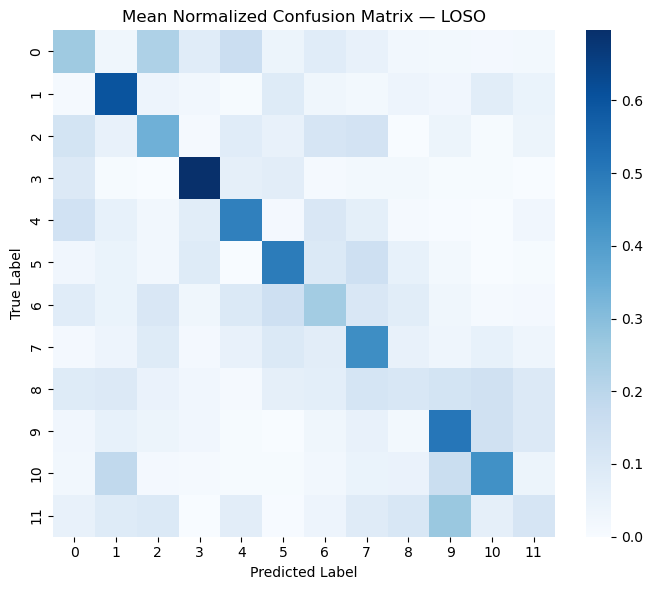

In [26]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, f1_score, confusion_matrix
from sklearn.model_selection import StratifiedKFold, cross_val_score

# --------------------------------------------------
# Feature functions (NO SSC)
# --------------------------------------------------
features = {
    "MAV": mav,
    "STD": std,
    "MaxAV": maxav,
    "RMS": rms,
    "WL": wl
}

# --------------------------------------------------
# Feature extraction per subject
# --------------------------------------------------
def extract_features(emg, stimulus, repetition, features, remove_ch9=True):
    emg = (emg - np.mean(emg, axis=0)) / (np.std(emg, axis=0) + 1e-8)

    if remove_ch9 and emg.shape[1] > 8:
        channels_to_use = [i for i in range(emg.shape[1]) if i != 8]
    else:
        channels_to_use = list(range(emg.shape[1]))

    emg_used = emg[:, channels_to_use]

    stimuli = np.unique(stimulus)
    stimuli = stimuli[stimuli != 0]

    reps = np.unique(repetition)
    reps = reps[reps != 0]

    X_list, y_list = [], []

    for stim in stimuli:
        for rep in reps:
            mask = np.logical_and(stimulus == stim, repetition == rep).squeeze()
            segment = emg_used[mask, :]

            if segment.size == 0:
                continue

            feat_vec = [func(segment) for func in features.values()]

            X_list.append(np.hstack(feat_vec))
            y_list.append(stim)

    return np.vstack(X_list), np.array(y_list), repetition

# --------------------------------------------------
# LOSO Cross-Subject Evaluation
# --------------------------------------------------
all_subjects = range(1, 28)

cross_acc_scores = []
cross_f1_scores  = []
within_acc_scores = []
within_f1_scores  = []
confmat_sum = None

for test_subj in all_subjects:
    X_train_list, y_train_list = [], []

    for subj in all_subjects:
        emg, stimulus, repetition = load_subject(subj)
        X, y, reps = extract_features(emg, stimulus, repetition, features)

        if subj == test_subj:
            X_test, y_test, repetition_test = X, y, reps
        else:
            X_train_list.append(X)
            y_train_list.append(y)

    X_train = np.vstack(X_train_list)
    y_train = np.hstack(y_train_list)

    # Feature standardization
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test  = scaler.transform(X_test)

    # Random Forest classifier
    clf = RandomForestClassifier(
        n_estimators=300,
        max_depth=15,
        min_samples_leaf=5,
        max_features="sqrt",
        class_weight="balanced",
        random_state=42,
        n_jobs=-1
    )

    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)

    # Cross-subject metrics
    acc = accuracy_score(y_test, y_pred)
    f1  = f1_score(y_test, y_pred, average="macro")
    cross_acc_scores.append(acc)
    cross_f1_scores.append(f1)

    print(f"Subject {test_subj:2d} | Cross-subject Accuracy: {acc:.3f} | F1-score: {f1:.3f}")

    # Confusion matrix
    cm = confusion_matrix(y_test, y_pred, normalize="true")
    confmat_sum = cm if confmat_sum is None else confmat_sum + cm

    # -----------------------------
    # Within-subject evaluation
    # -----------------------------
    unique_classes, class_counts = np.unique(y_test, return_counts=True)
    min_samples_per_class = np.min(class_counts)

    if min_samples_per_class < 2:
        within_acc_scores.append(np.nan)
        within_f1_scores.append(np.nan)
    else:
        n_splits = min(min_samples_per_class, len(np.unique(repetition_test[repetition_test != 0])))
        skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

        clf_ws = RandomForestClassifier(
            n_estimators=300,
            max_depth=15,
            min_samples_leaf=5,
            max_features="sqrt",
            class_weight="balanced",
            random_state=42,
            n_jobs=-1
        )

        scores_acc = cross_val_score(clf_ws, X_test, y_test, cv=skf, scoring='accuracy')
        scores_f1  = cross_val_score(clf_ws, X_test, y_test, cv=skf, scoring='f1_macro')

        within_acc_scores.append(np.mean(scores_acc))
        within_f1_scores.append(np.mean(scores_f1))

        print(f"Subject {test_subj:2d} | Within-subject Accuracy: {np.mean(scores_acc):.3f} | F1-score: {np.mean(scores_f1):.3f}")

# --------------------------------------------------
# Final Results
# --------------------------------------------------
print("\n=== LOSO Cross-Subject Summary ===")
print(f"Mean Cross-subject Accuracy: {np.nanmean(cross_acc_scores):.3f}")
print(f"Mean Cross-subject F1-score: {np.nanmean(cross_f1_scores):.3f}")
print(f"Mean Within-subject Accuracy: {np.nanmean(within_acc_scores):.3f}")
print(f"Mean Within-subject F1-score: {np.nanmean(within_f1_scores):.3f}")

# Confusion matrix visualization
confmat_mean = confmat_sum / len(all_subjects)
plt.figure(figsize=(7, 6))
sns.heatmap(confmat_mean, cmap="Blues")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Mean Normalized Confusion Matrix — LOSO")
plt.tight_layout()
plt.show()


## Part 5 : Impact of Training Set Size on Cross-Subject Performance

Training subjects:  1 | Accuracy: 0.108 | F1: 0.048
Training subjects:  2 | Accuracy: 0.100 | F1: 0.097
Training subjects:  3 | Accuracy: 0.258 | F1: 0.211
Training subjects:  4 | Accuracy: 0.242 | F1: 0.184
Training subjects:  5 | Accuracy: 0.233 | F1: 0.194
Training subjects:  6 | Accuracy: 0.225 | F1: 0.176
Training subjects:  7 | Accuracy: 0.258 | F1: 0.198
Training subjects:  8 | Accuracy: 0.283 | F1: 0.225
Training subjects:  9 | Accuracy: 0.217 | F1: 0.173
Training subjects: 10 | Accuracy: 0.183 | F1: 0.124
Training subjects: 11 | Accuracy: 0.175 | F1: 0.139
Training subjects: 12 | Accuracy: 0.167 | F1: 0.130
Training subjects: 13 | Accuracy: 0.192 | F1: 0.134
Training subjects: 14 | Accuracy: 0.192 | F1: 0.135
Training subjects: 15 | Accuracy: 0.200 | F1: 0.146
Training subjects: 16 | Accuracy: 0.175 | F1: 0.119
Training subjects: 17 | Accuracy: 0.192 | F1: 0.139
Training subjects: 18 | Accuracy: 0.192 | F1: 0.143
Training subjects: 19 | Accuracy: 0.183 | F1: 0.126
Training sub

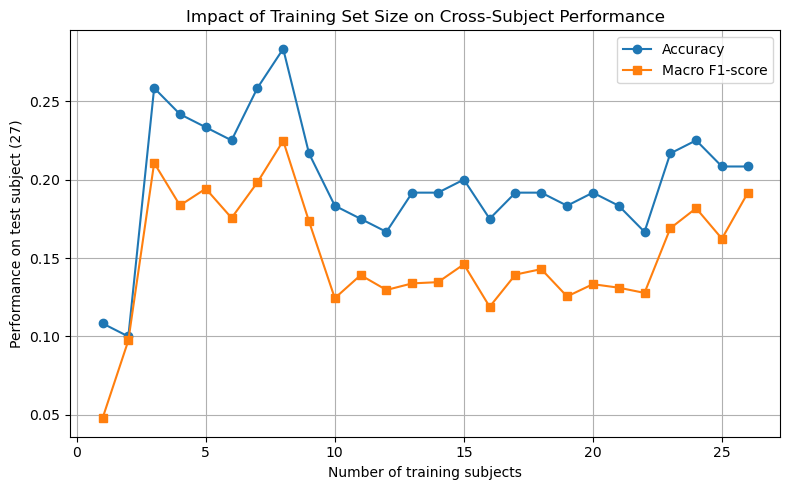

In [29]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, f1_score

#Fixed test subject & training order
test_subject = 27
training_subjects = list(range(1, 27))  # subjects 1 → 26

#storage
train_sizes = []
acc_scores = []
f1_scores = []

#progressive training loop
for k in range(1, len(training_subjects) + 1):

    current_train_subjects = training_subjects[:k]

    X_train_list, y_train_list = [], []

    # ---------- Training data ----------
    for subj in current_train_subjects:
        emg, stimulus, repetition = load_subject(subj)
        X, y, _ = extract_features(emg, stimulus, repetition, features)
        X_train_list.append(X)
        y_train_list.append(y)

    X_train = np.vstack(X_train_list)
    y_train = np.hstack(y_train_list)

    # ---------- Test data ----------
    emg, stimulus, repetition = load_subject(test_subject)
    X_test, y_test, _ = extract_features(emg, stimulus, repetition, features)

    # ---------- Scaling ----------
    scaler = StandardScaler()
    X_train = scaler.fit_transform(X_train)
    X_test  = scaler.transform(X_test)

    # ---------- Classifier ----------
    clf = RandomForestClassifier(
        n_estimators=300,
        max_depth=15,
        min_samples_leaf=5,
        max_features="sqrt",
        class_weight="balanced",
        random_state=42,
        n_jobs=-1
    )

    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)

    # ---------- Metrics ----------
    acc = accuracy_score(y_test, y_pred)
    f1  = f1_score(y_test, y_pred, average="macro")

    train_sizes.append(k)
    acc_scores.append(acc)
    f1_scores.append(f1)

    print(f"Training subjects: {k:2d} | Accuracy: {acc:.3f} | F1: {f1:.3f}")

#Plot: Performance vs training size
plt.figure(figsize=(8, 5))
plt.plot(train_sizes, acc_scores, marker="o", label="Accuracy")
plt.plot(train_sizes, f1_scores, marker="s", label="Macro F1-score")

plt.xlabel("Number of training subjects")
plt.ylabel("Performance on test subject (27)")
plt.title("Impact of Training Set Size on Cross-Subject Performance")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()



# Part 3 Regression for joint angles

### Download the data

In [57]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

from scipy.io import loadmat 
from scipy.ndimage import convolve1d
from scipy.signal import butter
from scipy.signal import sosfiltfilt
from scipy.signal import welch
from scipy.fft import fft, fftfreq
import pandas as pd

from sklearn.model_selection import train_test_split

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFE

# import pywt
import random

In [58]:
data_path = "data/s1/S1_E1_A1.mat"
data = loadmat(data_path)
print("Dataset variables:")
for key in data.keys():
    if not key.startswith("__"):
        print(key)

Dataset variables:
subject
exercise
emg
acc
gyro
mag
glove
stimulus
repetition
restimulus
rerepetition


In [59]:
#Exploring the number of repetitions of the train set

print("List of repetition values: ", np.unique(data["repetition"]))
print("List of rerepetition values: ", np.unique(data["rerepetition"]))
print("List of restimulus values: ", np.unique(data["restimulus"]))
print("List of stimulus values: ", np.unique(data["stimulus"]))

print("Repetition: ", data["repetition"].shape)
print("Rerepetition: ", data["rerepetition"].shape)
print("Restimulus: ", data["restimulus"].shape)
print("stimulus: ", data["stimulus"].shape)

print("Number of repetition per label:  ", np.bincount(data["repetition"].flatten()))
print("Number of rerepetition per label:  ", np.bincount(data["rerepetition"].flatten()))
print("Number of restimulus per label:  ", np.bincount(data["restimulus"].flatten()))
print("Number of stimulus per label:  ", np.bincount(data["stimulus"].flatten()))



List of repetition values:  [ 0  1  2  3  4  5  6  7  8  9 10]
List of rerepetition values:  [ 0  1  2  3  4  5  6  7  8  9 10]
List of restimulus values:  [0 1 2 3 4 5 6 7 8 9]
List of stimulus values:  [0 1 2 3 4 5 6 7 8 9]
Repetition:  (2292526, 1)
Rerepetition:  (2292526, 1)
Restimulus:  (2292526, 1)
stimulus:  (2292526, 1)
Number of repetition per label:   [796495 150618 148904 149479 149564 150387 149926 149655 149503 148356
 149639]
Number of rerepetition per label:   [  9878 291411 219693 216540 231914 215265 235135 209056 225229 213469
 224936]
Number of restimulus per label:   [1188175   82564   93842  160468  120850  112737   88592  175325  120336
  149637]
Number of stimulus per label:   [796495 139161 141287 168908 147710 147201 147253 218899 181869 203743]


In [60]:
#Train set key filtering
useless_keys = ['exercise', 'stimulus', 'repetition', 'restimulus', 'rerepetition', 'subject',
                'gyro', 'acc', 'mag']

data = {key: value for key, value in data.items() if not key.startswith("__")}
data = {key: value for key, value in data.items() if not key in useless_keys}

print([key for key in data.keys()])

['emg', 'glove']


### Preprocess the data

In [61]:
emg_data = data["emg"]
print("dimenstions EMG original", emg_data.shape)
glove = data['glove']          # joint angles
print("dimenstions GLOVE original", glove.shape)

dimenstions EMG original (2292526, 16)
dimenstions GLOVE original (2292526, 18)


In [62]:
# Only regressing on finger joint 3,6,8,11,14
glove_data_index = data["glove"][:, [2,5,7,10,13]]

print("Glove data dimension: {}".format(glove_data_index.shape))
print("Glove data type: {}".format(type(glove_data_index)))

Glove data dimension: (2292526, 5)
Glove data type: <class 'numpy.ndarray'>


### Visualize the data

Text(0, 0.5, 'Amplitude')

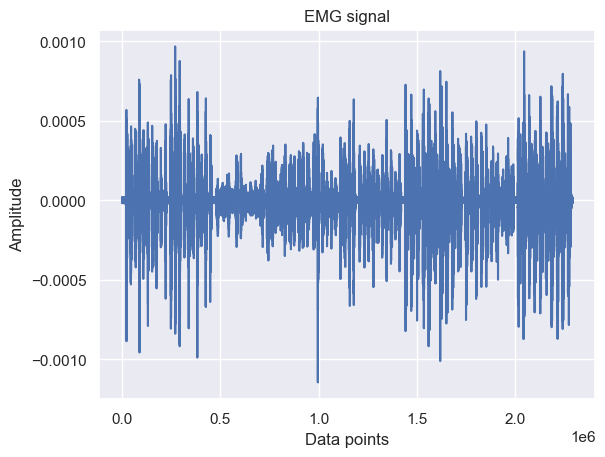

In [63]:
# Plot first channel to get a sense of the data
fs = 2000

emg_data = emg_data[:,:]
plt.close("all")
fig, ax = plt.subplots()
ax.plot(emg_data[:, 5])   
ax.set_title("EMG signal")
ax.set_xlabel("Data points")
ax.set_ylabel("Amplitude")

Text(0, 0.5, 'Amplitude')

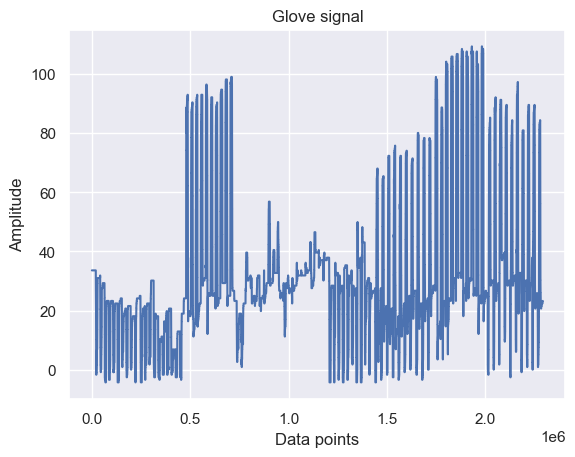

In [64]:
# Plot first channel of glove data
glove = glove[:,:]
plt.close("all")
fig, ax = plt.subplots()
ax.plot(glove[:, 5])   
ax.set_title("Glove signal")
ax.set_xlabel("Data points")
ax.set_ylabel("Amplitude")

Text(0.5, 1.0, 'Power Spectral Density plot in Log scale')

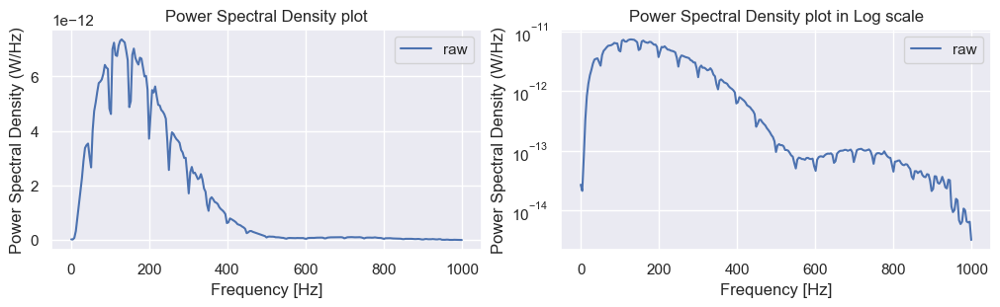

In [65]:
# Use Welch's method for power spectral density estimation, it reduces the variance of the estimate.
freqs_pre, Pxx_pre = welch(emg_data[:, 5], fs=2000, nperseg=512)

fig, ax = plt.subplots(1, 2, constrained_layout=True, figsize=(10, 3))
ax[0].plot(freqs_pre, Pxx_pre, label="raw")
ax[0].legend()
ax[0].set_xlabel("Frequency [Hz]")
ax[0].set_ylabel("Power Spectral Density (W/Hz)")
ax[0].set_title("Power Spectral Density plot")

ax[1].semilogy(freqs_pre, Pxx_pre, label="raw")
ax[1].legend()
ax[1].set_xlabel("Frequency [Hz]")
ax[1].set_ylabel("Power Spectral Density (W/Hz)")
ax[1].set_title("Power Spectral Density plot in Log scale")

In [66]:
def filter_signal(emg):
    bandpass_cutoff_frequencies_Hz = (5, 500) 
    sos = butter(N=4, Wn=bandpass_cutoff_frequencies_Hz, fs=fs, btype="bandpass", output="sos") 
    emg_filtered = sosfiltfilt(sos, emg.T).T

    powergrid_noise_frequencies_Hz = [harmonic_idx*50 for harmonic_idx in range(1,3)] # removing 50Hz noise and its harmonics
    for noise_frequency in powergrid_noise_frequencies_Hz:
        sos = butter(N=4, Wn=(noise_frequency - 2, noise_frequency + 2), fs=fs, btype="bandstop", output="sos")
        emg_filtered = sosfiltfilt(sos, emg_filtered.T).T

    return emg_filtered

In [67]:
def plot_frequency_spectrum(emg):
    n_samples = emg.shape[0]
    freq = fftfreq(n_samples, 1/fs)[:n_samples//2]
    
    fft_vals = fft(emg[:, 0])
    magnitude = 2.0/n_samples * np.abs(fft_vals[0:n_samples//2])
    
    zoom = len(freq)//2
    
    plt.figure(figsize=(15, 4))
    plt.plot(freq[:zoom], magnitude[:zoom])
    plt.xlabel('Frequency [Hz]')
    plt.ylabel('Magnitude')
    plt.grid(True)
    xticks = range(0, int(max(freq[:zoom])) + 50, 50)
    plt.xticks(xticks, rotation=45)
    for freq_line in range(0, int(max(freq[:zoom])), 50):
        if freq_line <= fs/2:  # Only plot up to Nyquist
            plt.axvline(x=freq_line, color='k', linestyle='--', alpha=0.5)
    plt.show()

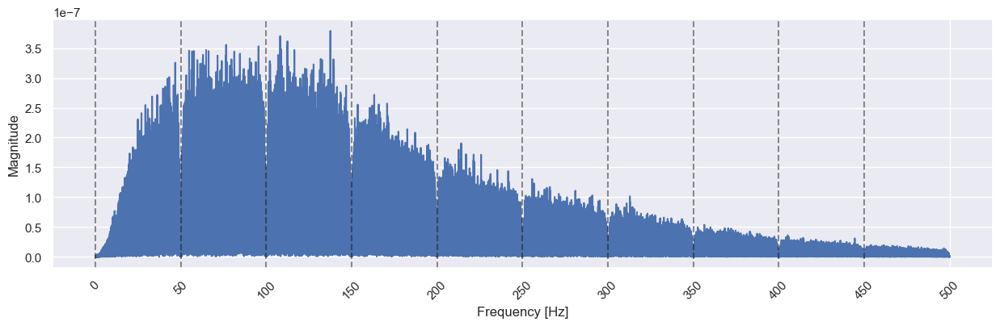

In [68]:
plot_frequency_spectrum(emg_data)

In [69]:
emg_data = filter_signal(emg_data)
emg_data.shape

(2292526, 16)

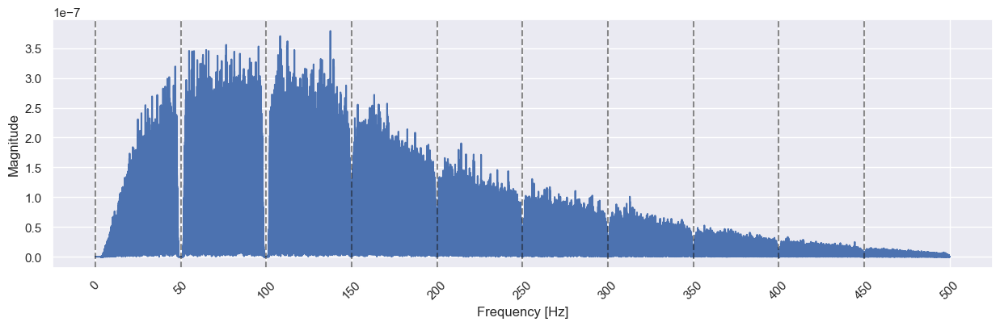

In [70]:
plot_frequency_spectrum(emg_data)

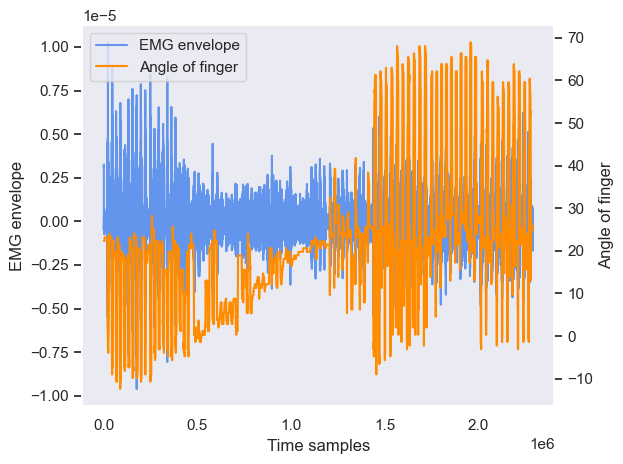

In [71]:
mov_mean_size = 400
mov_mean_weights = np.ones(mov_mean_size) / mov_mean_size
EMG_envelopes = convolve1d(emg_data, weights=mov_mean_weights, axis=0)

fig, ax = plt.subplots()
ax.plot(EMG_envelopes[:, 0],color = 'cornflowerblue', label="EMG envelope")
ax.set_ylabel("EMG envelope")
ax.set_xlabel("Time samples")
ax.grid(False)

finger_angle_ax = ax.twinx()
finger_angle_ax.plot(glove_data_index[:, 0], color="darkorange", label="Angle of finger")
finger_angle_ax.set_ylabel("Angle of finger")
finger_angle_ax.grid(False)

# Get handles and labels for legend
emg_handles, emg_labels = ax.get_legend_handles_labels()
finger_angle_handles, finger_angle_labels = finger_angle_ax.get_legend_handles_labels()

# Combine handles and labels
combined_handles = emg_handles + finger_angle_handles
combined_labels = emg_labels + finger_angle_labels

# Create a single legend
ax.legend(combined_handles, combined_labels, loc='upper left')
plt.tight_layout()

### Split the dataset into training, validation and test sets

In [78]:
# Get indices for splitting
n_samples = data["emg"].shape[0]
indices = np.arange(n_samples)

N = emg_data.shape[0]

train_end = int(0.7 * N)
val_end   = int(0.85 * N)

emg_train, emg_val, emg_test = emg_data[:train_end], emg_data[train_end:val_end], emg_data[val_end:]
ang_train, ang_val, ang_test = glove_data_index[:train_end], glove_data_index[train_end:val_end], glove_data_index[val_end:]

print("Train set sizes: ", emg_train.shape, ang_train.shape)
print("Validation set sizes: ", emg_val.shape, ang_val.shape)
print("Test set sizes: ", emg_test.shape, ang_test.shape)

Train set sizes:  (1604768, 16) (1604768, 5)
Validation set sizes:  (343879, 16) (343879, 5)
Test set sizes:  (343879, 16) (343879, 5)


### Performing sliding windows

In [79]:
#We show the 

n_channels = emg_data.shape[1]

joints_of_interest = np.array([2, 5, 7, 10, 13])
# channels_of_interest = np.array([1, 2, 5, 6, 7, 8, 9, 10, 13, 14, 15, 16]) - 1

n_joints = len(joints_of_interest)

emg_train = emg_train.copy()
emg_val = emg_val.copy()
emg_test = emg_test.copy()

#Time vector for plotting
time_steps_train = np.arange(0,emg_data[:train_end].shape[0]/fs, 1/fs)
time_steps_val = np.arange(0,emg_data[train_end:val_end].shape[0]/fs, 1/fs) 
time_steps_test = np.arange(0,emg_data[val_end:].shape[0]/fs, 1/fs) 

print("Time steps train shape: ", time_steps_train.shape)
print("Time steps val shape: ", time_steps_val.shape)
print("Time steps test shape: ", time_steps_test.shape)

#We rectify emg data for the three of them
emg_train = np.abs(emg_train) 
emg_val = np.abs(emg_val) 
emg_test = np.abs(emg_test) 

#We define the moving average window. A longer one is used for the glove angles than emg
mov_mean_length_glove = int(130*1e-3*fs) #130 ms for the glove angles
mov_mean_weights_glove = np.ones(mov_mean_length_glove) / mov_mean_length_glove

#We define another one for the emg. It should be shorter to keep the signal quality over window
mov_mean_length_emg = int(20*1e-3*fs) #20 ms for the emg data
mov_mean_weights_emg = np.ones(mov_mean_length_emg) / mov_mean_length_emg


#We smooth all the data with a moving average
ang_train = convolve1d(ang_train, mov_mean_weights_glove, axis=0)
emg_train = convolve1d(emg_train, mov_mean_weights_emg, axis=0)
    
ang_val = convolve1d(ang_val, mov_mean_weights_glove, axis=0)
emg_val = convolve1d(emg_val, mov_mean_weights_emg, axis=0) 

ang_test = convolve1d(ang_test, mov_mean_weights_glove, axis=0) 
emg_test = convolve1d(emg_test, mov_mean_weights_emg, axis=0) 

#We store them in variables
EMG_envelopes_train = emg_train[:, :]
glove_envelopes_train = ang_train

EMG_envelopes_val = emg_val[:, :]
glove_envelopes_val = ang_val

EMG_envelopes_test = emg_test[:, :]
glove_envelopes_test = ang_test

print("Done")

Time steps train shape:  (1604768,)
Time steps val shape:  (343879,)
Time steps test shape:  (343879,)
Done


In [80]:
print(EMG_envelopes_train.shape)

(1604768, 16)


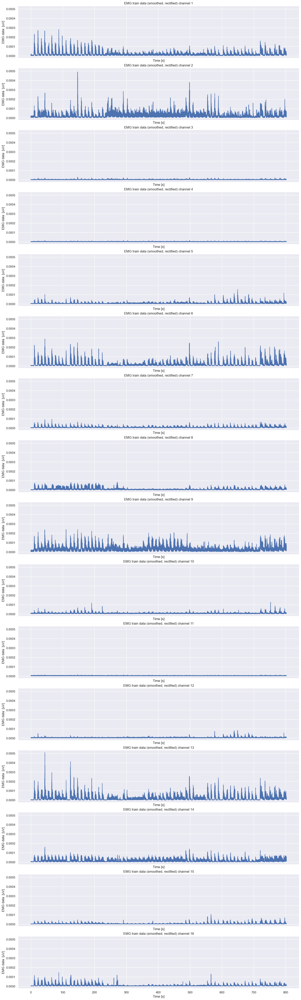

In [81]:
#We plot the smoothed, rectified data for each channel (TRAIN data)

fig, ax = plt.subplots(n_channels, 1, constrained_layout=True, figsize=(15, 50), sharex=True, sharey=True)
for channel_idx in range(n_channels):
    ax[channel_idx].plot(time_steps_train, EMG_envelopes_train[:, channel_idx])
    ax[channel_idx].set_xlabel("Time [s]")
    ax[channel_idx].set_ylabel(f"EMG data  [uV]")
    ax[channel_idx].set_title(f"EMG train data (smoothed, rectified) channel {channel_idx+1}")

plt.show()

In [82]:
fs = 2000  # [Hz], from dataset description
emg_window_length_sec = 150e-3  # [s]
incremental_window_length_sec = 50e-3  # [s]

print("Done")

Done


In [83]:
def extract_time_windows_regression(EMG: np.ndarray, Label: np.ndarray, fs: int, win_len: int, step: int):
# This function is used to cut the time windows from the raw EMG 
# It return a lists containing the EMG of each time window.
# It also returns the target corresponding to the time of the end of the window
    """
    This function is defined to perform an overlapping sliding window 
    :param EMG: Numpy array containing the data
    :param Label: Numpy array containing the targets
    :param fs: the sampling frequency of the signal
    :param win_len: The size of the windows (in seconds)
    :param step: The step size between windows (in seconds)

    :return: A Numpy array containing the windows
    :return: A Numpy array containing the targets aligned for each window
    :note: The lengths of both outputs are the same
    """
    
    n,m = EMG.shape
    win_len = int(win_len*fs)
    start_points = np.arange(0,n-win_len,int(step*fs))
    end_points = start_points + win_len

    EMG_windows = np.zeros((len(start_points),win_len,m))
    Labels_window = np.zeros((len(start_points),win_len,Label.shape[1]))
    for i in range(len(start_points)):
        EMG_windows[i,:,:] = EMG[start_points[i]:end_points[i],:]
        Labels_window[i,:,:] = Label[start_points[i]:end_points[i],:]
    

    return EMG_windows, Labels_window

print("Done")

Done


In [84]:
#We perform sliding window on the three sets to extract the features later
EMG_train_windows, Labels_train_windows = extract_time_windows_regression(EMG_envelopes_train, glove_envelopes_train, fs, emg_window_length_sec, incremental_window_length_sec)
EMG_val_windows, Labels_val_windows = extract_time_windows_regression(EMG_envelopes_val, glove_envelopes_val, fs, emg_window_length_sec, incremental_window_length_sec)
EMG_test_windows, Labels_test_windows = extract_time_windows_regression(EMG_envelopes_test, glove_envelopes_test, fs, emg_window_length_sec, incremental_window_length_sec)


print(f"EMG train data shape: {EMG_train_windows.shape}, Train label shape: {Labels_train_windows.shape}")
print(f"EMG val data shape: {EMG_val_windows.shape}, Val label shape: {Labels_val_windows.shape}")
print(f"EMG test data shape: {EMG_test_windows.shape}, Test label shape: {Labels_test_windows.shape}")

EMG train data shape: (16045, 300, 16), Train label shape: (16045, 300, 5)
EMG val data shape: (3436, 300, 16), Val label shape: (3436, 300, 5)
EMG test data shape: (3436, 300, 16), Test label shape: (3436, 300, 5)


### Extract a set of features

In [85]:
def extract_features(EMG_windows: np.ndarray, Labels_windows: np.ndarray):
    """
    This function is defined to extract the mean and standard deviation of each window
    :param EMG_windows: A Numpy array containing the windows
    :return: A Numpy array containing the mean and standard deviation of each window and the mean of the labels window
    """
    
    # along axis 1, which is the time axis
    EMG_mean = np.mean(EMG_windows, axis=1)
    EMG_std = np.std(EMG_windows, axis=1)
    EMG_max_amplitude = np.max(EMG_windows, axis=1)

    Labels_mean = np.mean(Labels_windows,axis=1)

    
    # Concatenate the mean and std of each window
    EMG_extracted_features = np.concatenate((
        EMG_mean, 
        EMG_std, 
        EMG_max_amplitude,
    ), axis=1)
    return EMG_extracted_features, Labels_mean

In [86]:
#We extract the features

EMG_train_extracted_features, Labels_train_mean = extract_features(EMG_train_windows,Labels_train_windows)
EMG_val_extracted_features, Labels_val_mean = extract_features(EMG_val_windows,Labels_val_windows)
EMG_test_extracted_features, Labels_test_mean = extract_features(EMG_test_windows,Labels_test_windows)

#We print their dimensions
print("EMG train extracted features shape: {}, Finger labels feature shape:{}".format(EMG_train_extracted_features.shape, Labels_train_mean.shape))
print("EMG val extracted features shape: {}, Finger labels feature shape:{}".format(EMG_test_extracted_features.shape, Labels_test_mean.shape))
print("EMG test extracted features shape: {}, Finger labels feature shape:{}".format(EMG_test_extracted_features.shape, Labels_test_mean.shape))

EMG train extracted features shape: (16045, 48), Finger labels feature shape:(16045, 5)
EMG val extracted features shape: (3436, 48), Finger labels feature shape:(3436, 5)
EMG test extracted features shape: (3436, 48), Finger labels feature shape:(3436, 5)


### Normalizing set of features

In [87]:
#We normalize the features, and keep the normalization parameters. They will be used for validation and testing
#We use z-score normalization, because the EMG data may contain outliers

#Normalization matrices
norm_mean = np.mean(EMG_train_extracted_features, axis=0)
norm_std = np.std(EMG_train_extracted_features, axis=0)

#We print its dimensions
print(f"Mean matrix shape: {norm_mean.shape}")
print(norm_mean)

print(f"Std matrix shape: {norm_std.shape}")
print(norm_std)

Mean matrix shape: (48,)
[1.72601479e-05 2.45684439e-05 3.51594277e-06 3.18273341e-06
 7.08634611e-06 1.73600050e-05 7.02472165e-06 7.44471287e-06
 3.06513110e-05 8.08031216e-06 4.23289940e-06 5.00149165e-06
 1.82163617e-05 1.44562827e-05 5.20917365e-06 7.30402423e-06
 5.43732611e-06 9.20837600e-06 8.85990192e-07 7.28872303e-07
 2.37451056e-06 6.07404186e-06 2.09206674e-06 3.27320611e-06
 9.32715859e-06 1.88407604e-06 7.70004337e-07 1.30580107e-06
 7.29340388e-06 5.83594665e-06 1.47994497e-06 2.39870873e-06
 3.01073124e-05 4.62226119e-05 5.60142483e-06 4.87027237e-06
 1.28203706e-05 3.18335979e-05 1.20308107e-05 1.57237774e-05
 5.24869881e-05 1.25720313e-05 6.02645441e-06 8.13289577e-06
 3.56098634e-05 2.83269632e-05 8.78734462e-06 1.31377876e-05]
Std matrix shape: (48,)
[1.68084953e-05 2.02487982e-05 1.23294498e-06 7.47118479e-07
 5.71370964e-06 1.91274308e-05 5.08175657e-06 5.87704957e-06
 1.98251715e-05 3.82449551e-06 5.52610712e-07 2.41263468e-06
 1.99912363e-05 9.87177114e-06 4.50

In [88]:
#Normalization function

def normalize(x, mean_matrix, std_matrix):
    return (x - mean_matrix)/std_matrix

In [89]:
#Fit and predict using the linear regression model
from sklearn.linear_model import LinearRegression
from sklearn.multioutput import MultiOutputRegressor

print("Base")
print(np.mean(EMG_test_extracted_features, axis=0))

#We put these into the relevant variables for fitting/evaluation
X_train = normalize(EMG_train_extracted_features, norm_mean, norm_std)
X_val = normalize(EMG_val_extracted_features, norm_mean, norm_std)
X_test = normalize(EMG_test_extracted_features, norm_mean, norm_std)

Y_train = Labels_train_mean
Y_val = Labels_val_mean
Y_test = Labels_test_mean

print("Train set shape")
print(X_train.shape)
print(Y_train.shape)

print("Validation set shape")
print(X_val.shape)
print(Y_val.shape)

print("Test set shape")
print(X_test.shape)
print(Y_test.shape)

#To check if normalization has been done properly
#We observe that normalization works well accross the sets
print(np.mean(X_test, axis=0))
print(np.std(X_test, axis=0))

Base
[2.34579625e-05 3.49651690e-05 3.87731713e-06 3.23214829e-06
 7.78843764e-06 2.38899412e-05 8.07319479e-06 7.08145933e-06
 4.18498767e-05 9.20526969e-06 4.02683472e-06 4.76305878e-06
 2.14828830e-05 1.64764284e-05 5.36915763e-06 9.26058153e-06
 7.16987537e-06 1.26736967e-05 1.01919159e-06 7.34439922e-07
 2.61871081e-06 8.79783073e-06 2.56801703e-06 2.61712302e-06
 1.23479042e-05 2.53862686e-06 7.42253524e-07 1.21088011e-06
 7.96373699e-06 6.41811972e-06 1.52820634e-06 2.70709775e-06
 4.01987584e-05 6.45686246e-05 6.29185208e-06 4.94791344e-06
 1.40697626e-05 4.46832392e-05 1.42033721e-05 1.36148030e-05
 7.05055650e-05 1.53565514e-05 5.77366568e-06 7.65565600e-06
 4.04774566e-05 3.14698222e-05 9.04046312e-06 1.56670457e-05]
Train set shape
(16045, 48)
(16045, 5)
Validation set shape
(3436, 48)
(3436, 5)
Test set shape
(3436, 48)
(3436, 5)
[ 0.36873108  0.51344899  0.29309853  0.06614062  0.12287841  0.34139118
  0.20632101 -0.06180883  0.56486602  0.29414534 -0.37289303 -0.09882676

### Visualize correlation of features

In [90]:
def compute_corr_matrix_normalized(X): 
    #We standardize the features before to avoid any scaling effect
    # X_corr_mean = np.mean(X_corr, axis=0) 
    # X_corr_std = np.std(X_corr, axis=0)
    # X_corr_normalized = (X_corr - X_corr_mean) / X_corr_std
    
    # Calculate the cross-correlation matrix (Pearson correlation)
    corr_matrix = np.corrcoef(X, rowvar=False)

    return corr_matrix

print("Done")

Done


In [91]:
n_features_channels = 3
all_channels = emg_data[1]
print("All channels: ", all_channels)

All channels:  [ 5.81018366e-06  4.07065491e-07 -3.04082565e-06 -1.88853496e-06
  2.68297329e-06 -2.54745148e-06  3.08373201e-06  1.53388775e-06
  1.38820936e-06  1.19454726e-06  4.11288913e-06  2.63589715e-06
 -2.09092924e-06  5.00623395e-06 -1.09999267e-06  5.96587590e-06]


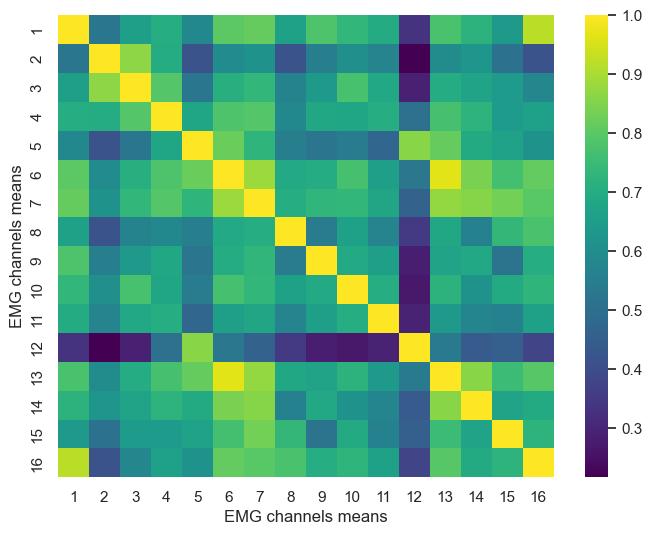

In [92]:
#Visualize the full correlation matrix
X_corr = X_train[:, 0:n_channels] #The MEANS are extracted
corr_matrix = compute_corr_matrix_normalized(X_corr)


all_channels = np.arange(1, n_channels+1) #Times 

fig, ax = plt.subplots(figsize=(8, 6))
sns.heatmap(corr_matrix, ax=ax, xticklabels=all_channels, yticklabels=all_channels, cmap="viridis")
ax.set_ylabel("EMG channels means")
ax.set_xlabel("EMG channels means")

#plt.title("Confusion Matrix")
save_figures_path = "figures/"
plt.savefig(save_figures_path + "correlation_matrix_means.png", dpi=300, bbox_inches="tight")
plt.show()

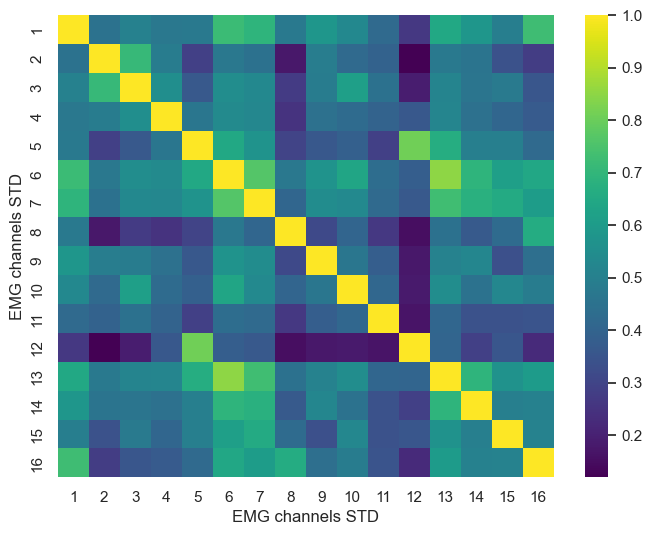

In [93]:
#Visualize the full correlation matrix
X_corr = X_train[:, n_channels*1:n_channels*2] #The STDS are extracted
corr_matrix = compute_corr_matrix_normalized(X_corr)


all_channels = np.arange(1, n_channels+1) #Times 

fig, ax = plt.subplots(figsize=(8, 6))
sns.heatmap(corr_matrix, ax=ax, xticklabels=all_channels, yticklabels=all_channels, cmap="viridis")
ax.set_ylabel("EMG channels STD")
ax.set_xlabel("EMG channels STD")

#plt.title("Confusion Matrix")
plt.savefig(save_figures_path + "correlation_matrix_stds.png", dpi=300, bbox_inches="tight")
plt.show()

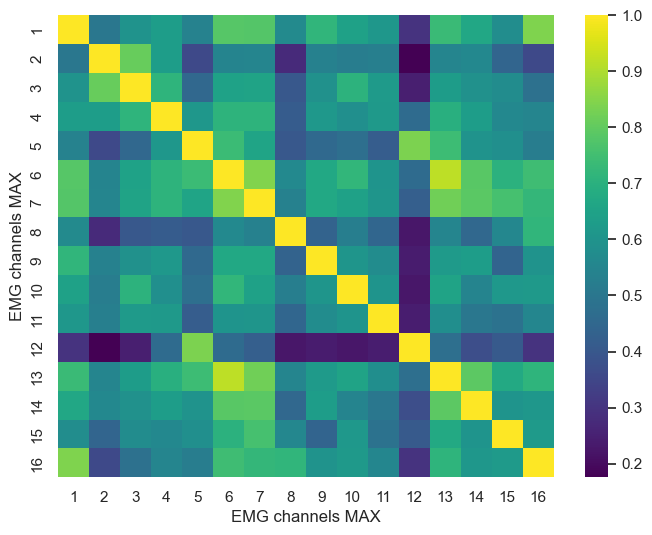

In [94]:
#Visualize the full correlation matrix
X_corr = X_train[:, n_channels*2:n_channels*3] #The MAX values are extracted
corr_matrix = compute_corr_matrix_normalized(X_corr)


all_channels = np.arange(1, n_channels+1) #Times 

fig, ax = plt.subplots(figsize=(8, 6))
sns.heatmap(corr_matrix, ax=ax, xticklabels=all_channels, yticklabels=all_channels, cmap="viridis")
ax.set_ylabel("EMG channels MAX")
ax.set_xlabel("EMG channels MAX")



#plt.title("Confusion Matrix")
plt.savefig(save_figures_path + "correlation_matrix_stds.png", dpi=300, bbox_inches="tight")
plt.show()


In [95]:
print(n_channels)

16


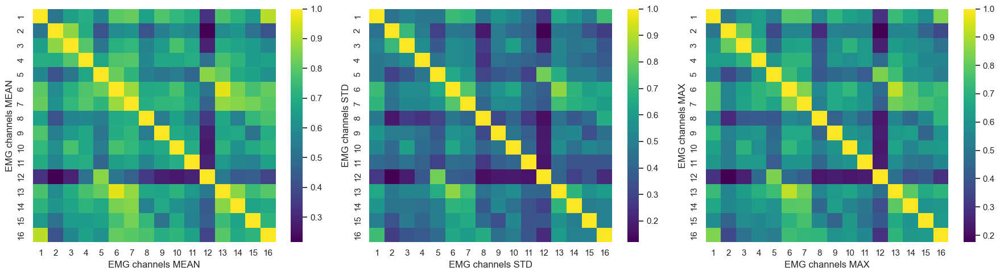

In [96]:
n_rows, n_columns = 1, 3

fig, axes = plt.subplots(n_rows, n_columns, figsize=(18, 5))

axes = axes.flatten()

all_channels = np.arange(1, n_channels+1)


X_corr = X_train[:, 0:n_channels] #The MEANS are extracted
corr_matrix = compute_corr_matrix_normalized(X_corr)

sns.heatmap(corr_matrix, ax=axes[0], xticklabels=all_channels, yticklabels=all_channels, cmap="viridis")
axes[0].set_ylabel("EMG channels MEAN")
axes[0].set_xlabel("EMG channels MEAN")


X_corr = X_train[:, n_channels:n_channels*2] #The MEANS are extracted
corr_matrix = compute_corr_matrix_normalized(X_corr)

sns.heatmap(corr_matrix, ax=axes[1], xticklabels=all_channels, yticklabels=all_channels, cmap="viridis")
axes[1].set_ylabel("EMG channels STD")
axes[1].set_xlabel("EMG channels STD")


X_corr = X_train[:, n_channels*2:n_channels*3] #The MEANS are extracted
corr_matrix = compute_corr_matrix_normalized(X_corr)

sns.heatmap(corr_matrix, ax=axes[2], xticklabels=all_channels, yticklabels=all_channels, cmap="viridis")
axes[2].set_ylabel("EMG channels MAX")
axes[2].set_xlabel("EMG channels MAX")

X_corr = X_train[:, n_channels*3:n_channels*4] #The MEANS are extracted
corr_matrix = compute_corr_matrix_normalized(X_corr)


# Save and visualize
plt.tight_layout()
plt.savefig(save_figures_path + "correlation_subplot_grid2.png", dpi=300, bbox_inches="tight")
plt.show()

### Perform Random Forest regression

In [97]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import make_scorer, mean_absolute_error
from tqdm.auto import tqdm
from tqdm_joblib import tqdm_joblib
from scipy.stats import randint


# Base model (RF) wrapped for multi-output 
base = RandomForestRegressor(random_state=42, n_jobs=-1)
model = MultiOutputRegressor(base)

# Scoring: use negative MAE (higher is better in sklearn)
scorer = make_scorer(mean_absolute_error, greater_is_better=False)

param_dist = {
    "estimator__n_estimators": randint(100, 401),          # 100..400
    "estimator__max_depth": [None, 5, 10],
    "estimator__min_samples_split": randint(2, 21),        # 2..20
    "estimator__min_samples_leaf": randint(1, 6),          # 1..5
}

search = RandomizedSearchCV(
    estimator=model,
    param_distributions=param_dist,
    n_iter=10,
    cv=3,
    scoring=scorer,
    n_jobs=-1,
    verbose=0,
    random_state=42,
    refit=True
)

total_fits = search.n_iter * search.cv

with tqdm_joblib(tqdm(total=total_fits, desc="RandomizedSearchCV fits")):
    search.fit(X_train, Y_train)

print("Best params:", search.best_params_)
print("Best CV score (neg MAE):", search.best_score_)
print("Best CV MAE:", -search.best_score_)  # convert to positive MAE

RandomizedSearchCV fits:   0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

Best params: {'estimator__max_depth': 10, 'estimator__min_samples_leaf': 5, 'estimator__min_samples_split': 3, 'estimator__n_estimators': 393}
Best CV score (neg MAE): -18.24165914880385
Best CV MAE: 18.24165914880385


In [98]:
results = pd.DataFrame(search.cv_results_)

cols = [
    "mean_test_score", "std_test_score",
    "param_estimator__n_estimators",
    "param_estimator__max_depth",   
    "param_estimator__min_samples_split",
    "param_estimator__min_samples_leaf",
]
summary = results[cols].sort_values("mean_test_score", ascending=False).head(10)

# Convert neg MAE to MAE for readability
summary = summary.rename(columns={
    "mean_test_score": "mean_CV_negMAE",
    "std_test_score": "std_CV_negMAE",
    "mean_train_score": "mean_train_negMAE"
})
summary["mean_CV_MAE"] = -summary["mean_CV_negMAE"]
summary["std_CV_MAE"] = summary["std_CV_negMAE"]

print(summary[[
    "mean_CV_MAE", "std_CV_MAE",
    "param_estimator__n_estimators",
    "param_estimator__max_depth",
    "param_estimator__min_samples_split",
    "param_estimator__min_samples_leaf",
]])

   mean_CV_MAE  std_CV_MAE  param_estimator__n_estimators  \
4    18.241659    3.839219                            393   
0    18.289307    3.862651                            206   
2    18.313947    3.890436                            187   
3    18.314866    3.874600                            251   
1    18.324351    3.858409                            221   
9    18.341679    3.894140                            234   
7    18.393155    3.893427                            370   
6    18.399702    3.884241                            158   
8    19.178080    3.680140                            154   
5    19.192505    3.694648                            121   

  param_estimator__max_depth  param_estimator__min_samples_split  \
4                         10                                   3   
0                         10                                  16   
2                         10                                  12   
3                       None                            

In [99]:
# Extract RF params (remove "estimator__" prefix)
best_rf_params = {
    k.replace("estimator__", ""): v
    for k, v in search.best_params_.items()
}

print("RF params used:", best_rf_params)

# Build and fit final model on full training set
base_model = RandomForestRegressor(random_state=42, n_jobs=-1, **best_rf_params)
multi_model = MultiOutputRegressor(base_model)

multi_model.fit(X_train, Y_train)

# Predict on test set
Y_pred = multi_model.predict(X_test)

print("Done")

RF params used: {'max_depth': 10, 'min_samples_leaf': 5, 'min_samples_split': 3, 'n_estimators': 393}
Done


### Evaluate the performance

In [100]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

mse = mean_squared_error(Y_test, Y_pred, multioutput='raw_values')
rmse = np.sqrt(mse)
mae = mean_absolute_error(Y_test, Y_pred, multioutput='raw_values')
r2 = r2_score(Y_test, Y_pred, multioutput='raw_values')

print(mse.shape)
print("Root mean sqaure error:", rmse)
print("Mean absolute error:", mae)
print("R2 score:", r2)

(5,)
Root mean sqaure error: [26.29804103 34.9560035  45.71571336 23.51837717 24.99980036]
Mean absolute error: [17.6648852  22.18746815 28.80840571 14.85084826 17.46937403]
R2 score: [-1.11470599 -0.38951177 -0.37267313  0.32571731  0.33121548]


### Is the regression performance stable across the different finger angles?

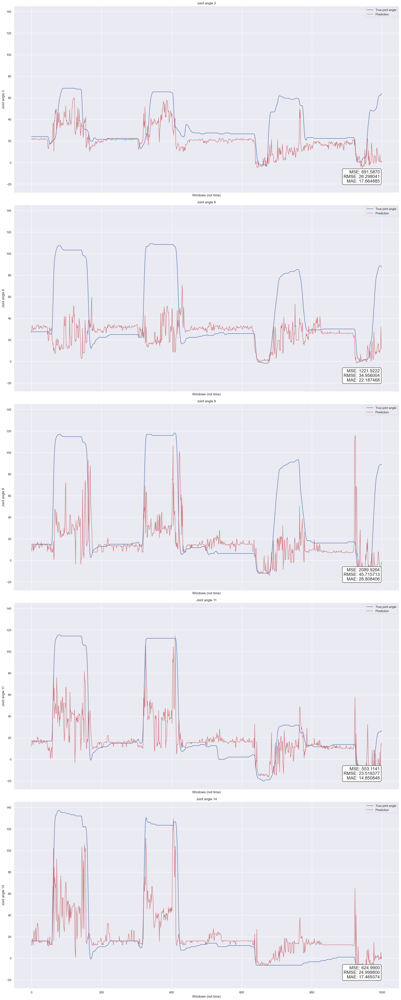

Done


In [101]:
nb_windows_t_print = 1000
save_figures_path = "figures"

fig, ax = plt.subplots(n_joints, 1, constrained_layout=True, figsize=(20, 50), sharex=True, sharey=True)
for i in range(n_joints):
    x = np.arange(nb_windows_t_print)
    ax[i].plot(x, Y_test[:nb_windows_t_print, i], color='b', label='True joint angle')
    ax[i].plot(x, Y_pred[:nb_windows_t_print, i], color='r', alpha=0.7, label='Prediction')
    ax[i].set_xlabel("Windows (not time)")
    ax[i].set_ylabel(f"Joint angle {joints_of_interest[i]+1}")
    ax[i].set_title(f"Joint angle {joints_of_interest[i]+1}")

    ax[i].text(
        0.95, 0.05, f'MSE: {mse[i]:.4f}\nRMSE: {rmse[i]:4f}\nMAE: {mae[i]:4f}',
        transform=ax[i].transAxes,
        fontsize=16,
        verticalalignment="bottom",
        horizontalalignment="right",
        bbox=dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="white")
    )
    ax[i].legend()

plt.savefig(save_figures_path + "angle_pred2 50 estimators ma 128 ms sw 50 ms.png", dpi=300, bbox_inches="tight")
plt.show()
print("Done")

In [102]:
def rect_filter_past(data, filter_size):
    output = np.zeros_like(data)
    for i in range(filter_size-1, len(data)):
        sum_ = 0
        for j in range(i-filter_size+1, i+1):
            sum_ += data[j]/filter_size
        output[i, :] = sum_
    return output
            

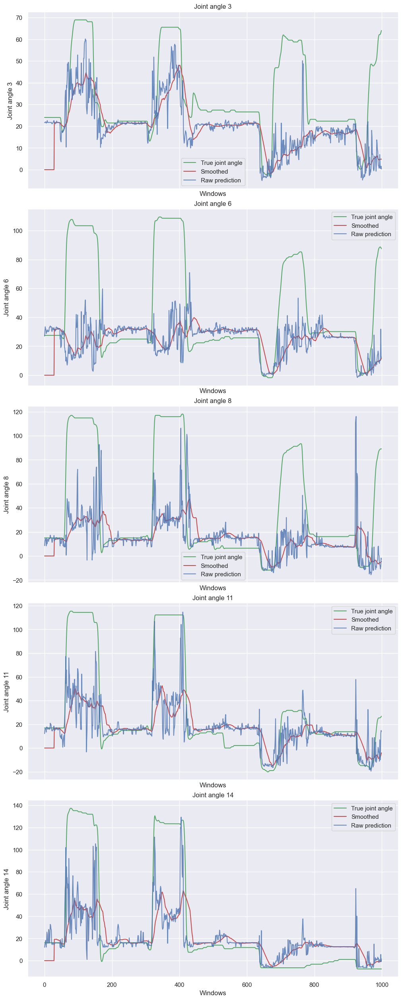

Done


In [108]:
#Useful to answer to the question: Is there a joint angle for which the predictions are less good than usual? 
nb_windows_t_print = 1000
save_figures_path = "figures/"

filter_size = 30
mov_mean_output_weigths = np.ones(filter_size) / filter_size

#Y_pred_smoothed = convolve1d(Y_pred, mov_mean_output_weigths, axis=0)
Y_pred_smoothed = rect_filter_past(Y_pred, filter_size)

mse = mean_squared_error(Y_test, Y_pred, multioutput='raw_values')
rmse = np.sqrt(mse)
mae = mean_absolute_error(Y_test, Y_pred, multioutput='raw_values')
r2 = r2_score(Y_test, Y_pred, multioutput='raw_values')


fig, ax = plt.subplots(n_joints, 1, constrained_layout=True, figsize=(10, 25), sharex=True, sharey=False)
for i in range(n_joints):
    x = np.arange(nb_windows_t_print)
    ax[i].plot(x, Y_test[:nb_windows_t_print, i], color='g', alpha=1, label='True joint angle')
    ax[i].plot(x, Y_pred_smoothed[:nb_windows_t_print, i], color='r', alpha=1, label='Smoothed')
    ax[i].plot(x, Y_pred[:nb_windows_t_print, i], color='b', alpha=0.8, label='Raw prediction')
    ax[i].set_xlabel("Windows")
    ax[i].set_ylabel(f"Joint angle {joints_of_interest[i]+1}")
    ax[i].set_title(f"Joint angle {joints_of_interest[i]+1}")

    # ax[i].text(
    #     0.95, 0.05, f'MSE: {mse[i]:.4f}\nRMSE: {rmse[i]:4f}\nMAE: {mae[i]:4f}',
    #     transform=ax[i].transAxes,
    #     fontsize=16,
    #     verticalalignment="bottom",
    #     horizontalalignment="right",
    #     bbox=dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="white")
    # )
    ax[i].legend()

plt.savefig(save_figures_path + "angle_pred3 50 estimators ma 128 ms sw 50 ms.png", dpi=300, bbox_inches="tight")
plt.show()
print("Done")